## The Art of Clusterring [Assignment 3]

- Clustering is often likened to an art form, as much as it is a science. This technique involves grouping a set of objects in such a way that objects in the same group (called a cluster) are more similar to each other than to those in other groups. The subjective nature of defining 'similarity'—whether based on intuition, domain-specific knowledge, or the peculiarities of the data—makes each clustering task uniquely challenging. Additionally, the selection of clustering parameters and the interpretation of the results can vary significantly, reflecting personal or business-driven biases and objectives. This subjectivity is why the task of clustering is not just about applying algorithms, but also about understanding the underlying patterns and meanings in the data.
-------
> Evangelia P. Panourgia, Master Student in Data Science, AUEB <br />
> Department of Informatics, Athens University of Economics and Business <br />
> eva.panourgia@aueb.gr <br/><br/>

## Setting the Scene

In [90]:
!pip install opencv-python
!pip install opencv-python

### Python Libraries and Their Purposes

- **`os`**: Provides functions for interacting with the operating system. Used for file path manipulations, directory operations, and environment variable access.
  
- **`math`**: Offers access to mathematical functions like trigonometric, logarithmic, and other common mathematical operations.
  
- **`subprocess`**: Allows you to spawn new processes, connect to their input/output/error pipes, and obtain their return codes. Useful for running system commands.
  
- **`io.BytesIO`**: Lets you manage streams of bytes, which can be used as input/output for many file-like interfaces.
  
- **`numpy`** (`np`): Fundamental package for numerical computation in Python. Provides support for arrays, matrices, and high-level mathematical functions.
  
- **`pandas`** (`pd`): Essential for data manipulation and analysis. Provides data structures and operations for manipulating numerical tables and time series.
  
- **`matplotlib.pyplot`**: Used for creating static, interactive, and animated visualizations in Python.
  
- **`matplotlib.image`** (`mpimg`): Module for reading and writing images. Useful in loading images as NumPy arrays for manipulation.
  
- **`cv2`** (OpenCV): Library for computer vision tasks, including loading, displaying, and transforming images.
  
- **`PIL.Image`** (Pillow): Provides capabilities to open, manipulate, and save many different image file formats.
  
- **`tqdm`**: A tool for displaying progress bars in loops and command line programs. Helps visualize the progress of lengthy operations.
  
- **`itertools.combinations`**: Useful for creating combinations of elements from a list, without repeated elements.
  
- **`psutil`**: Provides an interface for retrieving information on running processes and system utilization (CPU, memory, disks, network, sensors).
  
- **`sklearn.preprocessing.StandardScaler`**: Standardizes features by removing the mean and scaling to unit variance, often a prerequisite for machine learning model input.
  
- **`sklearn.decomposition.PCA`**: Principal Component Analysis (PCA) is used for dimensionality reduction while preserving as much variance as possible.
  
- **`sklearn.cluster.KMeans`**: A clustering algorithm that partitions `n` observations into `k` clusters in which each observation belongs to the cluster with the nearest mean.
  
- **`sklearn.metrics.silhouette_score`, `cohen_kappa_score`**: Metrics for evaluating model performance. Silhouette score assesses the separation distance between the resulting clusters, while Cohen’s kappa measures the agreement between two annotations.
  
- **`tensorflow.keras.applications.ResNet50`**: Provides the ResNet50 model, pre-trained on ImageNet for use in transfer learning and image feature extraction.
  
- **`tensorflow.keras.applications.resnet50.preprocess_input`**: Prepares input data into the format the model requires.
  
- **`tensorflow.keras.models.Model`**: Base class for constructing models in Keras.
  
- **`tensorflow.keras.preprocessing.image`**: Utilities for real-time data augmentation on image data, helpful for expanding the dataset artificially during training.


In [292]:
import os
import math
import subprocess
from io import BytesIO

from PIL import Image
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
from PIL import Image
from tqdm import tqdm
from itertools import combinations
import psutil

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, cohen_kappa_score

from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing import image

import seaborn as sns
import math

import cv2
from skimage.feature import local_binary_pattern

# statistics packages
from scipy.stats import f_oneway
from statsmodels.stats.multicomp import pairwise_tukeyhsd
from scipy.stats import pearsonr, spearmanr
from sklearn.metrics import cohen_kappa_score

import torch
from joblib import dump
from joblib import load

import re 

## Dataset Information
- In this Jupyter Notebook we will explore the dataset [GSV-Cities dataset](https://www.kaggle.com/datasets/amaralibey/gsv-cities) offered by the kaggle.
- In short, as it is already mentioned in the official documentation page, `GSV-Cities` is a **large-scale dataset** for training deep neural network for the task of Visual Place Recognition. It has been published in our Neurocomputing 2022: GSV-Cities: Toward Appropriate Supervised Visual Place Recognition

It contains `~530k` images:
There are more than `62k different places`, spread across multiple cities around the globe.
Each place is depited by `at least 4 images` (`up to 20 images`)
All places are physically distant (at least 100 meters between any pair of places). 

## `1` Data Acquisition and Preprocessing

### `1a)` Download the "GSV Cities" dataset from Kaggle within your notebook.
- How to Download Kaggle Datasets: Step-by-Step Guide
   - This guide explains how to download datasets from Kaggle using the `kaggle` Python package and your Kaggle API credentials.
- Step 1: Create a Kaggle Account and API Key
   1. **Sign Up or Log In**:
      - Go to [Kaggle](https://www.kaggle.com) and create an account (if you don't already have one).

   2. **Generate API Key**:
      - Navigate to your account settings (click on your profile picture > Settings).
      - Scroll down to the "API" section and click `Create New API Token`.
      - This will download a file named `kaggle.json`.

- Step 2: Set Up the API Key
   1. **Move the `kaggle.json` File**:
      - Create a hidden folder for Kaggle API credentials:
      ```bash
      mkdir -p ~/.kaggle
      ```
      - Move the downloaded `kaggle.json` file into this folder:
      ```bash
      mv /path/to/kaggle.json ~/.kaggle/
      ```

   2. **Set Correct Permissions**:
      - Ensure the file is secure by changing its permissions:
      ```bash
      chmod 600 ~/.kaggle/kaggle.json
      ```

- Step 3: Install the Kaggle Python Package
   - Install the required `kaggle` Python package:
   ```bash
   pip install kaggle

- **Regarding the function `download_kaggle_dataset`**: 
   - **Dataset Download and Configuration Validation**: The script downloads a specified Kaggle dataset using the Kaggle CLI, ensuring that the Kaggle API key (`kaggle.json`) is correctly configured and secured in the `~/.kaggle/` directory.

   - **Error Handling and Output Notification**: It handles potential errors (e.g., missing API key, invalid dataset slug) and provides clear notifications about the success or failure of the dataset download and extraction process.
- **Note** all the data will be stored  in the folder `downloaded_data`
- **Important Note** : The below cell takes about **2** hours to run.

In [92]:
def download_kaggle_dataset(dataset_slug, download_path):
     """
     Download a dataset from Kaggle.

     Parameters:
         dataset_slug (str): The Kaggle dataset slug (e.g., "amaralibey/gsv-cities").
         download_path (str): The directory where the dataset will be downloaded.
     """
     kaggle_json_path = os.path.expanduser("~/.kaggle/kaggle.json")

     # Ensure the Kaggle API key exists
     if not os.path.exists(kaggle_json_path):
         raise FileNotFoundError(
             f"kaggle.json not found at {kaggle_json_path}. Ensure the file is placed in ~/.kaggle/ and contains your username and API key."
         )

     # Ensure permissions are correct for kaggle.json
     os.chmod(kaggle_json_path, 0o600)

     # Create the download path if it doesn't exist
     os.makedirs(download_path, exist_ok=True)

     try:
         # Use the Kaggle CLI to download the dataset
         subprocess.run(
             ["kaggle", "datasets", "download", "-d", dataset_slug, "-p", download_path, "--unzip"],
             check=True
         )
         print(f"Dataset '{dataset_slug}' downloaded successfully to '{download_path}'!")
     except subprocess.CalledProcessError as e:
         print(f"Error occurred while downloading dataset: {e}")
     except Exception as ex:
         print(f"An unexpected error occurred: {ex}")

if __name__ == "__main__":
     # Define the dataset slug and download path
     dataset_slug = "amaralibey/gsv-cities"
     download_path = "./downloaded_data"

     # Download the dataset
     download_kaggle_dataset(dataset_slug, download_path)

- Fine, the dataset loaded locally with success. 
    - It is loaded in the folder `downloaded_data` 

### `1b)` Explore the dataset to understand its structure, features, and potential challenges.

- **Important Note**: Piece of codes for the following exploration have been used by the published notebook [visualize the dataset,](https://www.kaggle.com/code/amaralibey/gsv-cities-visualizing-the-dataset).
- Via observing the loaded data, and reading the [official documentations](https://www.kaggle.com/datasets/amaralibey/gsv-cities) of the provided dataset the structure of the Dataset is in the format like: 
```
downloaded_data
├── Images
│   ├── Paris
│   │   ├── ...
│   │   ├── PRS_0000003_2015_05_584_48.79733778544615_2.231461206488333_7P0FnGV3k4Fmtw66b8_-Gg.JPG
│   │   ├── PRS_0000003_2018_05_406_48.79731397404108_2.231417994064803_R2vU9sk2livhkYbhy8SFfA.JPG
│   │   ├── PRS_0000003_2019_07_411_48.79731121699659_2.231424930041198_bu4vOZzw3_iU5QxKiQciJA.JPG
│   │   ├── ...
│   ├── Boston
│   │   ├── ...
│   │   ├── Boston_0006385_2015_06_121_42.37599246498178_-71.06902130162344_2MyXGeslIiua6cMcDQx9Vg.JPG
│   │   ├── Boston_0006385_2018_09_117_42.37602467319898_-71.0689666533628_NWx_VsRKGwOQnvV8Gllyog.JPG
│   │   ├── ...
│   ├── Rome
│   │   ├── ...
│   ├── ...
└── Dataframes
    ├── Paris.csv
    ├── London.csv
    ├── Rome.csv
    ├── ...

```

- let's delve into the data more.
    - Firstly we will explore the folder `Dataframes`

In [93]:
print('Dataframes in GSV-Cities:')
! ls ./downloaded_data/Dataframes/

Dataframes in GSV-Cities:
Bangkok.csv      Lisbon.csv       MexicoCity.csv   PRS.csv
Barcelona.csv    London.csv       Miami.csv        Phoenix.csv
Boston.csv       LosAngeles.csv   Minneapolis.csv  Rome.csv
Brussels.csv     Madrid.csv       OSL.csv          TRT.csv
BuenosAires.csv  Medellin.csv     Osaka.csv        WashingtonDC.csv
Chicago.csv      Melbourne.csv    PRG.csv


- These `csv` are hosted on the sub folder `Dataframes`.
- Now, let's move on the subfolder `Images`.

In [94]:
print('Images directories in GSV-Cities:')
! ls ./downloaded_data/Images/

Images directories in GSV-Cities:
Bangkok      BuenosAires  LosAngeles   MexicoCity   Osaka        Rome
Barcelona    Chicago      Madrid       Miami        PRG          TRT
Boston       Lisbon       Medellin     Minneapolis  PRS          WashingtonDC
Brussels     London       Melbourne    OSL          Phoenix


- The above directories are hosted on the subfolder `Images`.
- Having the high level view of the context of the folders, we will delve into the folder `Dataframe` in order to explore the structure of a csv file.
    - Before delving into the whole dataset, we will build step b ystep our understanding across the provided dataset, We will explore `Barcelona.csv` as it has already been explored in the official jupyter notebook that we aforementioned.

In [95]:
barcelona_df = pd.read_csv('downloaded_data/Dataframes/Barcelona.csv') # read data for the city Barchelona 
barcelona_df = barcelona_df.set_index('place_id') # set place_id as index in the dataframe
barcelona_df # preview the dataframe  

,year,month,northdeg,city_id,lat,lon,panoid
place_id,,,,,,,
1678,2014,10,370,Barcelona,41.402066,2.198988,DB4DzlzCRq4IyE9FMx_9Ow
869,2013,9,429,Barcelona,41.379878,2.160354,T8h6jIzaq1HVsKzl3GLG-g
119,2019,4,214,Barcelona,41.359106,2.121732,xVLttz6_XRHvxUNgAE0QYA
812,2014,6,442,Barcelona,41.378458,2.158467,5VpLONr1AfwC-InzCtsZZg
911,2018,7,500,Barcelona,41.381641,2.133315,IZsvECbqOVXqd0xR51fwrA
...,...,...,...,...,...,...,...
525,2014,10,640,Barcelona,41.370289,2.142593,ki8mlMFeOG9iJm8JZgsZzQ
553,2014,10,352,Barcelona,41.370394,2.187612,czv78K2bS3EgZcCZBpp4ow
1159,2009,7,496,Barcelona,41.387857,2.169821,OdDrlhsWlKB4bxu1L94Kag


- Let's check how many images exist for the city `Barchelona`.

In [96]:
print(f'There are {len(barcelona_df)} images in the city of Barcelona')

There are 15894 images in the city of Barcelona


- So, we have `cities` e.g. `Barchelona`, in addition we have `places` being parts of the current `city`, and each place has a **unique place_id** for instance 1678.
- Now let's preview for the city Barchelona the place with id 1678.  

In [97]:
barcelona_df

,year,month,northdeg,city_id,lat,lon,panoid
place_id,,,,,,,
1678,2014,10,370,Barcelona,41.402066,2.198988,DB4DzlzCRq4IyE9FMx_9Ow
869,2013,9,429,Barcelona,41.379878,2.160354,T8h6jIzaq1HVsKzl3GLG-g
119,2019,4,214,Barcelona,41.359106,2.121732,xVLttz6_XRHvxUNgAE0QYA
812,2014,6,442,Barcelona,41.378458,2.158467,5VpLONr1AfwC-InzCtsZZg
911,2018,7,500,Barcelona,41.381641,2.133315,IZsvECbqOVXqd0xR51fwrA
...,...,...,...,...,...,...,...
525,2014,10,640,Barcelona,41.370289,2.142593,ki8mlMFeOG9iJm8JZgsZzQ
553,2014,10,352,Barcelona,41.370394,2.187612,czv78K2bS3EgZcCZBpp4ow
1159,2009,7,496,Barcelona,41.387857,2.169821,OdDrlhsWlKB4bxu1L94Kag


In [98]:
print(barcelona_df.loc[1678].shape[0])
barcelona_df.loc[1678]

13


,year,month,northdeg,city_id,lat,lon,panoid
place_id,,,,,,,
1678,2014,10,370,Barcelona,41.402066,2.198988,DB4DzlzCRq4IyE9FMx_9Ow
1678,2008,5,357,Barcelona,41.402032,2.198973,iI4DZ6302rhnVVjQYMjDDA
1678,2018,5,345,Barcelona,41.402054,2.199009,zdvWcu1uUn2q4rXd2HvVvg
1678,2019,5,356,Barcelona,41.402040,2.198992,SjLGs0WlwnmBpsvo1W9gWQ
1678,2014,6,366,Barcelona,41.402061,2.199017,90tXjJhaS_muck4eq_qB1A
1678,2015,4,360,Barcelona,41.402061,2.198972,8dsvZfkDqCXsSKepdETLqQ
1678,2013,10,366,Barcelona,41.402049,2.199003,r3tni5B3rTzhyejboqFWuA
1678,2019,8,373,Barcelona,41.402060,2.199015,IoJr5gOoUVd2uMSvp4bejQ
1678,2015,3,377,Barcelona,41.402061,2.198976,nxK1Dv-QxH78r0gEi0_HHA


- So the place whith ID 1678 is depicted by 13 images 
- So, at this point we have understanding the following regarding the provided data strycture. 
    - A `City` (i.e. Barchelona) **`has`** (type of relation) **`many`** `places_id`, and `each place id` has `at least 4 images`.

### Visualizing images in GSV-Cities
- important note the following code is followed by the official jupyter published. We used it as guide to undestand the connectio nof teh tw ogenerated folders.
- To go from a row in the CSV file to the image itself, we only need to **form the image filename from the CVS row**. 
- This is because images in GSV-Cities cary all the information in their filename. Let's see some examples.
- Let's show the Dataframe of the place which ID is 1678 in Barcelona

In [99]:
a_place = barcelona_df.loc[1678]
a_place

,year,month,northdeg,city_id,lat,lon,panoid
place_id,,,,,,,
1678,2014,10,370,Barcelona,41.402066,2.198988,DB4DzlzCRq4IyE9FMx_9Ow
1678,2008,5,357,Barcelona,41.402032,2.198973,iI4DZ6302rhnVVjQYMjDDA
1678,2018,5,345,Barcelona,41.402054,2.199009,zdvWcu1uUn2q4rXd2HvVvg
1678,2019,5,356,Barcelona,41.402040,2.198992,SjLGs0WlwnmBpsvo1W9gWQ
1678,2014,6,366,Barcelona,41.402061,2.199017,90tXjJhaS_muck4eq_qB1A
1678,2015,4,360,Barcelona,41.402061,2.198972,8dsvZfkDqCXsSKepdETLqQ
1678,2013,10,366,Barcelona,41.402049,2.199003,r3tni5B3rTzhyejboqFWuA
1678,2019,8,373,Barcelona,41.402060,2.199015,IoJr5gOoUVd2uMSvp4bejQ
1678,2015,3,377,Barcelona,41.402061,2.198976,nxK1Dv-QxH78r0gEi0_HHA


- Note, each row of the above data frame represents an image. 
- let's get the first image of a_place 

In [100]:
place_id, image_1_info = next(iter(a_place.iterrows())) # we could've used a_place.iloc[0] but Stack Overflow woud get mad at us
print(image_1_info)

year                          2014
month                           10
northdeg                       370
city_id                  Barcelona
lat                      41.402066
lon                       2.198988
panoid      DB4DzlzCRq4IyE9FMx_9Ow
Name: 1678, dtype: object


### Distributions Exploration for Cities and Places ID Overall
- Before focusing on Images folder more, firstly, we will delve into the distribution of columns `citie` and `place id`.
- For this purpose we will create a dataframe having the columns  :
    - `City` the name of the city (i.e. Barchelona)
    - `Counter of Place ID`	 (the total number of unique place ID that are located in the City)
    - `List of counters for Place ID` (contains a dictionary format having as key the "place ID" and as value "number of images for the current place ID")
    - `Min`	the minimum number of images for one or more  Place(s) ID
    - `Max`	the maximum number of images for one or more  Place(s) ID
    - `Average` the average number of images for all Placed ID

In [3]:
# Define the folder containing the CSV files
folder_path = "downloaded_data/Dataframes"

# Initialize an empty list to store the results for each city
data = []

# Iterate through all CSV files in the folder
for file_name in os.listdir(folder_path):
    if file_name.endswith(".csv"):
        # Extract city name from the file name
        city_name = file_name.replace(".csv", "")
        
        # Load the CSV file into a DataFrame
        file_path = os.path.join(folder_path, file_name)
        df = pd.read_csv(file_path)
        
        # Calculate unique place IDs and their counts
        place_id_counts = df['place_id'].value_counts()
        place_id_dict = place_id_counts.to_dict()  # Convert to dictionary format
        
        # Append the city data to the list
        data.append({
            "City": city_name,
            "Counter of Place ID": len(place_id_counts),
            "List of counters for Place ID": place_id_dict
        })

# Create the DataFrame with city data
df_distribution = pd.DataFrame(data)

# Function to calculate min, max, and average from the dictionary
def calculate_min_max_avg(place_id_dict):
    """Calculate min, max, and avg from a dictionary of place_id counts."""
    if isinstance(place_id_dict, dict) and place_id_dict:  # Check if it's a non-empty dictionary
        values = place_id_dict.values()
        return min(values), max(values), round(sum(values) / len(values), 2)  # Rounded to 2 decimal places
    return None, None, None

# Apply the function to each row in the "List of counters for Place ID" column
df_distribution[['Min', 'Max', 'Average']] = df_distribution['List of counters for Place ID'].apply(
    lambda x: pd.Series(calculate_min_max_avg(x))
)

df_distribution

,City,Counter of Place ID,List of counters for Place ID,Min,Max,Average
0,Madrid,1701,"{2078: 17, 836: 17, 1612: 16, 1097: 16, 1564: ...",4.0,17.0,8.56
1,Medellin,849,"{931: 17, 451: 17, 1040: 16, 1143: 16, 571: 15...",3.0,17.0,7.10
2,Phoenix,3984,"{5536: 28, 1352: 24, 3640: 22, 2294: 22, 641: ...",3.0,28.0,9.10
3,OSL,1810,"{582: 15, 953: 15, 583: 15, 657: 15, 878: 15, ...",2.0,15.0,5.39
4,Miami,5149,"{4350: 19, 5130: 19, 5124: 19, 3863: 18, 7740:...",2.0,19.0,8.47
5,Boston,3283,"{6802: 20, 7432: 19, 4371: 18, 6451: 18, 4245:...",7.0,20.0,9.93
6,Brussels,2329,"{2374: 15, 2751: 14, 1169: 13, 1076: 13, 1309:...",3.0,15.0,6.08
7,Rome,2391,"{965: 22, 1230: 21, 970: 21, 1504: 19, 19: 18,...",4.0,22.0,10.07
8,Barcelona,1424,"{204: 27, 258: 26, 319: 25, 373: 25, 199: 24, ...",3.0,27.0,11.16
9,Chicago,3595,"{1774: 20, 6187: 20, 2966: 20, 5477: 19, 6163:...",2.0,20.0,9.48


- Note : We have 23 rows as the total number fo the inique cities. 

In [4]:
df_distribution['total_images'] = df_distribution["List of counters for Place ID"].apply(lambda x: sum(x.values()))
df_distribution

,City,Counter of Place ID,List of counters for Place ID,Min,Max,Average,total_images
0,Madrid,1701,"{2078: 17, 836: 17, 1612: 16, 1097: 16, 1564: ...",4.0,17.0,8.56,14554
1,Medellin,849,"{931: 17, 451: 17, 1040: 16, 1143: 16, 571: 15...",3.0,17.0,7.10,6024
2,Phoenix,3984,"{5536: 28, 1352: 24, 3640: 22, 2294: 22, 641: ...",3.0,28.0,9.10,36251
3,OSL,1810,"{582: 15, 953: 15, 583: 15, 657: 15, 878: 15, ...",2.0,15.0,5.39,9756
4,Miami,5149,"{4350: 19, 5130: 19, 5124: 19, 3863: 18, 7740:...",2.0,19.0,8.47,43637
5,Boston,3283,"{6802: 20, 7432: 19, 4371: 18, 6451: 18, 4245:...",7.0,20.0,9.93,32616
6,Brussels,2329,"{2374: 15, 2751: 14, 1169: 13, 1076: 13, 1309:...",3.0,15.0,6.08,14171
7,Rome,2391,"{965: 22, 1230: 21, 970: 21, 1504: 19, 19: 18,...",4.0,22.0,10.07,24068
8,Barcelona,1424,"{204: 27, 258: 26, 319: 25, 373: 25, 199: 24, ...",3.0,27.0,11.16,15894
9,Chicago,3595,"{1774: 20, 6187: 20, 2966: 20, 5477: 19, 6163:...",2.0,20.0,9.48,34091


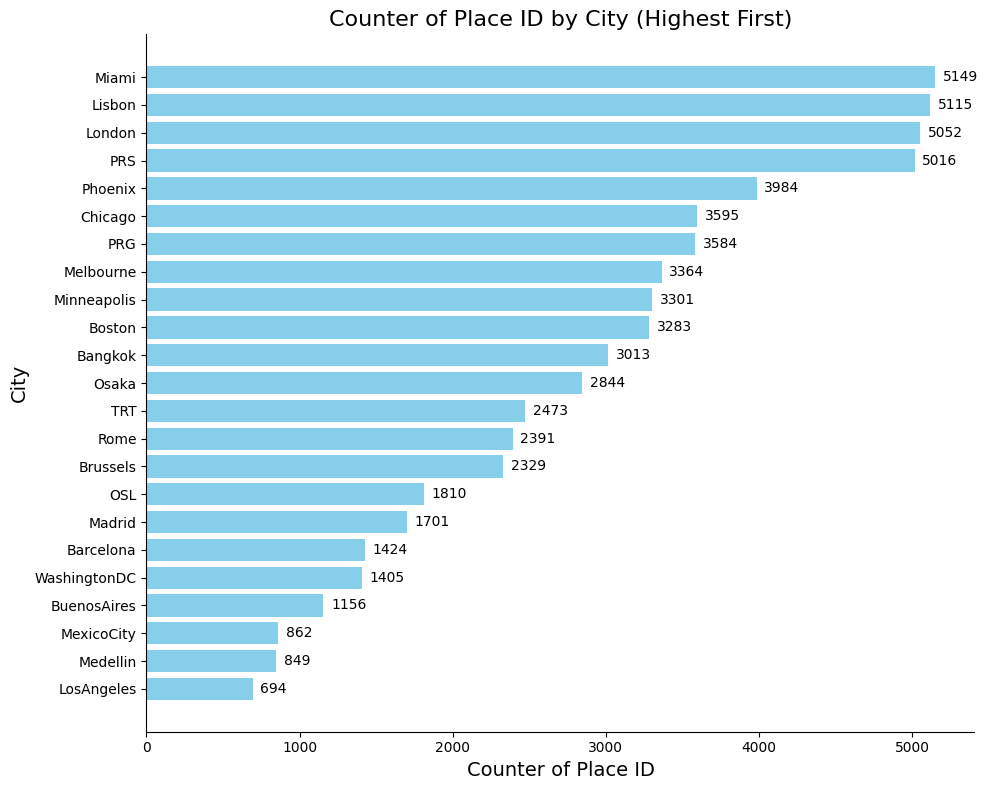

In [5]:
# Sort the DataFrame by 'Counter of Place ID' in descending order
df_distribution = df_distribution.sort_values(by='Counter of Place ID', ascending=False)

# Plot a horizontal bar chart for "City" vs "Counter of Place ID"
plt.figure(figsize=(10, 8))
bars = plt.barh(df_distribution['City'], df_distribution['Counter of Place ID'], color='skyblue')

# Add data labels to the end of each bar
for bar in bars:
    plt.text(
        bar.get_width() + 50,  # Position label slightly beyond the end of the bar
        bar.get_y() + bar.get_height() / 2,  # Position at the center of the bar
        str(int(bar.get_width())),  # The value (convert to int for cleaner display)
        va='center',  # Vertically align text
        fontsize=10
    )

# Invert the y-axis so the highest value is at the top
plt.gca().invert_yaxis()

# Remove top and right axes for a cleaner look
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Set labels and title
plt.xlabel('Counter of Place ID', fontsize=14)
plt.ylabel('City', fontsize=14)
plt.title('Counter of Place ID by City (Highest First)', fontsize=16)
plt.tight_layout()

# Show the horizontal bar chart
plt.show()

- We can observe that Miami, Lisbon, London and PRS has  collected images coming from many fiddrent palces in comparison to Mexico, Medellin and Los Angeles.
- The follwoing plot ti was designed to display `the distribution of minimum, average, and maximum values` (presumably for some `numeric variable like image counts per city`) across `different cities`.

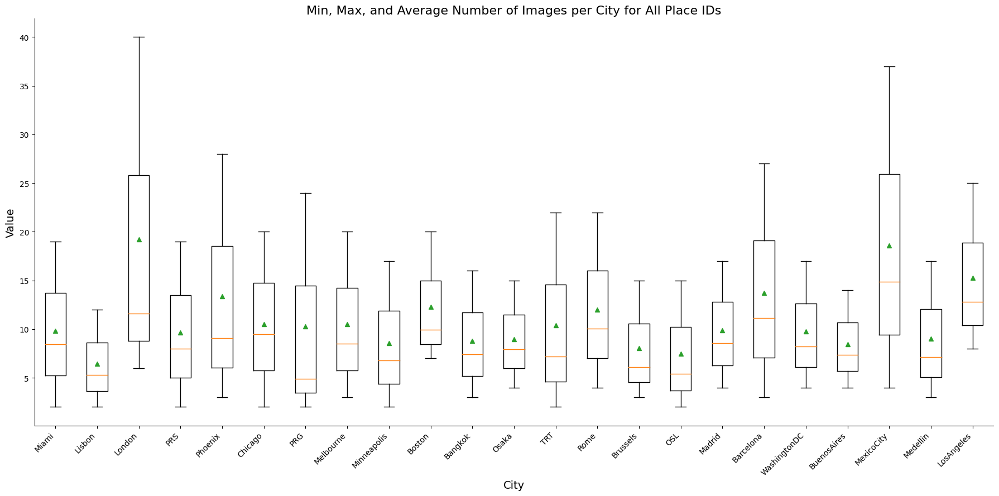

In [6]:
# Prepare data for box plots
boxplot_data = []
for _, row in df_distribution.iterrows():
    boxplot_data.append([row['Min'], row['Average'], row['Max']])

# Create box plots
plt.figure(figsize=(18, 9))
plt.boxplot(boxplot_data, labels=df_distribution['City'], showmeans=True)

# Set labels and title
plt.xlabel('City', fontsize=14)
plt.ylabel('Value', fontsize=14)
plt.title('Min, Max, and Average Number of Images per City for All Place IDs', fontsize=16)

# Adjust x-axis tick labels rotation
plt.xticks(rotation=45, ha='right')

# Remove top and right axes
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Show the box plots
plt.tight_layout()
plt.show()


- If we observe the `orange line` gives a sense of the **central tedency** (median)  for the min, average, and max values grouped for each city.
- We can observe that the `the majority of cities` have `on average 10 images per place id`. 
- Note : `London` and `mexico City` have more outliers values as they have more images in some places compared to the remaining cities like `Lisbon`.
- We will breate a vertical barchart to demonstrate the the diffrent number of images (`Imbalance`)  per City.

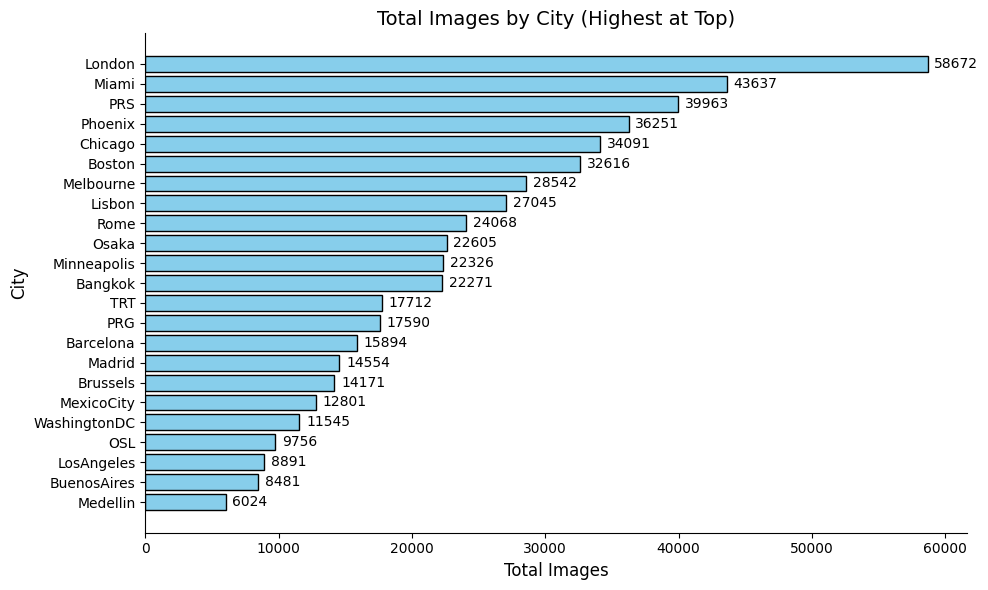

In [7]:
# Sort the DataFrame by 'total_images' in descending order
df_distribution_sorted = df_distribution.sort_values(by='total_images', ascending=True)

# Extracting sorted data for the visualization
cities = df_distribution_sorted['City']
total_images = df_distribution_sorted['total_images']

# Creating the bar plot
plt.figure(figsize=(10, 6))
bars = plt.barh(cities, total_images, color='skyblue', edgecolor='black')

# Adding total images at the end of each bar
for bar in bars:
    plt.text(bar.get_width() + 500, bar.get_y() + bar.get_height()/2,
             str(int(bar.get_width())), va='center', fontsize=10)

# Adding labels and title
plt.xlabel('Total Images', fontsize=12)
plt.ylabel('City', fontsize=12)
plt.title('Total Images by City (Highest at Top)', fontsize=14)

# Removing top and right axes
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.tight_layout()

# Displaying the plot
plt.show()


- In `London` there are the most number of images (58672 images in total), whereas in Medelin the lowest one (6024 images in total).
- Furthermore cities like `Rome`, `Osaka` has a more balanced number of images compared to the outliers we aforementioned. 
- Now, let's try to investigate if tehre is a relation betweeen number of places per city and the total number fo images.

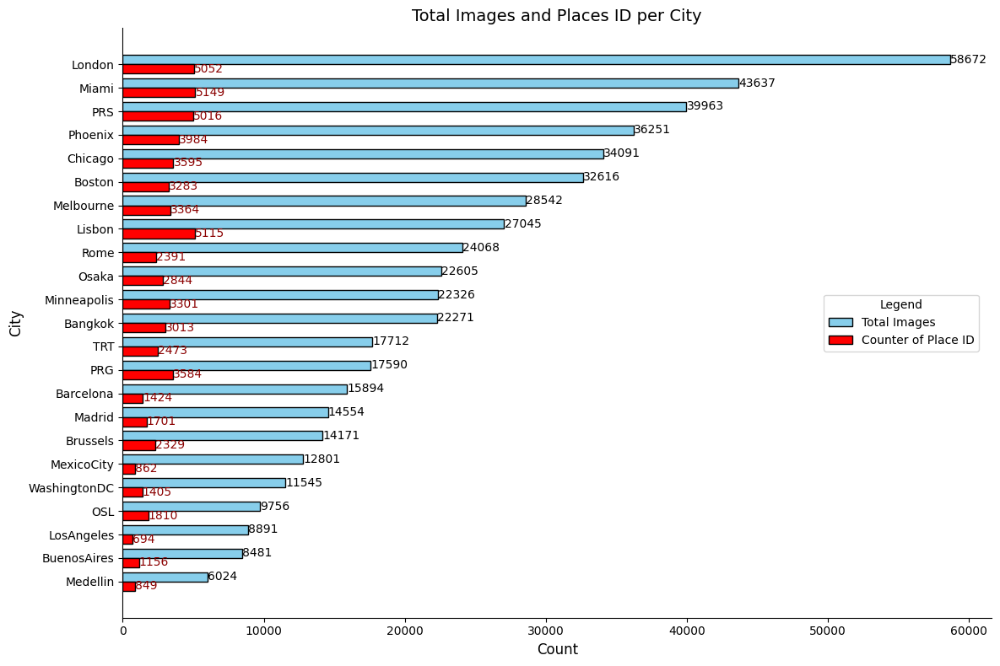

In [8]:
# Sort the DataFrame by 'total_images' in descending order
df_distribution_sorted = df_distribution.sort_values(by='total_images', ascending=False)

# Extracting sorted data for the visualization
cities = df_distribution_sorted['City']
total_images = df_distribution_sorted['total_images']
place_ids = df_distribution_sorted['Counter of Place ID']

# Reverse the order to display the highest at the top
cities = cities[::-1]
total_images = total_images[::-1]
place_ids = place_ids[::-1]

# Creating the bar plot
plt.figure(figsize=(12, 8))
bar_width = 0.4
y_positions = np.arange(len(cities))

# Plotting the total images as blue bars (above)
bars2 = plt.barh(y_positions + bar_width / 2, total_images, height=bar_width, color='skyblue', edgecolor='black', label='Total Images')

# Plotting the Counter of Place ID as red bars (below)
bars1 = plt.barh(y_positions - bar_width / 2, place_ids, height=bar_width, color='red', edgecolor='black', label='Counter of Place ID')

# Adding values at the end of each bar
for bar in bars2:
    plt.text(bar.get_width() + 2, bar.get_y() + bar.get_height() / 2,
             str(int(bar.get_width())), va='center', fontsize=10)
for bar in bars1:
    plt.text(bar.get_width() + 2, bar.get_y() + bar.get_height() / 2,
             str(int(bar.get_width())), va='center', fontsize=10, color='darkred')

# Adding labels, title, and legend
plt.xlabel('Count', fontsize=12)
plt.ylabel('City', fontsize=12)
plt.title('Total Images and Places ID per City', fontsize=14)
plt.yticks(y_positions, cities)
plt.legend(loc='center left', bbox_to_anchor=(0.8, 0.5), title="Legend")

# Removing top and right axes
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.tight_layout()

# Displaying the plot
plt.show()

- **Data Imbalance Across Cities:** There is a notable imbalance in the distribution of images across different cities. To prevent potential bias in our results, we will implement random sampling techniques in the upcoming phases of our analysis.
    - So, `Challenge 1` : **Imbalance in the number of images per city**. 

- **Trend of Images Relative to Place IDs:** We have observed in the majority of cases (with some cities being exceptions in this relation) trend where an increase in the number of place IDs typically leads to an increase in the number of images per city. This relationsh

- **Correlation Between Place IDs and Image Count:** In most cases, there appears to be a direct correlation where an increase in the `counter of place ID` leads to a rise in the `total number of images` per city, highlighting a pivotal trend within the dataset.


### Intagrate Information (csv metadata & images)

- At this point we will integrate our data. 
    - To begin with, we will intagrate from the folder Datafarmes the seperate csv for eadh city.
    - For this purpose we created the function the next block of code. 

In [39]:
# Define the folder containing the CSV files
folder_path = "downloaded_data/Dataframes"

# Initialize an empty list to store dataframes
dataframes = []

# Iterate through all CSV files in the folder
for file_name in os.listdir(folder_path):
    if file_name.endswith(".csv"):
        # Load the CSV file into a DataFrame
        file_path = os.path.join(folder_path, file_name)
        df = pd.read_csv(file_path)
        
        # Append the DataFrame to the list
        dataframes.append(df)

# Concatenate all DataFrames into a single DataFrame
df_integrated = pd.concat(dataframes, ignore_index=True)

# Display the shape of the resulting DataFrame
print(f"Integrated DataFrame Shape: {df_integrated.shape}")

# Preview the integrated DataFrame
df_integrated

Integrated DataFrame Shape: (529506, 8)


,place_id,year,month,northdeg,city_id,lat,lon,panoid
0,1746,2014,2,140,Madrid,40.424332,-3.708372,oWCkDzuaXRAzU2HpwHRxpA
1,1667,2011,4,278,Madrid,40.422298,-3.671313,Fe3LcKMItNG8Iq6ybpIH-A
2,1937,2014,4,25,Madrid,40.427228,-3.691281,moHqqGVRoB9hb0L4qZ-FuA
3,2127,2011,4,328,Madrid,40.430231,-3.675223,UbAd6zgFnw8lCfiyevQW4g
4,2109,2018,7,347,Madrid,40.430127,-3.691862,iCCwr7uBgLpQIe63YbvmsA
...,...,...,...,...,...,...,...,...
529501,3151,2017,9,530,PRS,48.867335,2.303481,rbaOu9XYm5qZuLMNNT4HaQ
529502,2690,2015,6,308,PRS,48.857356,2.335159,ZYyWY2wsGXBt7TXvoZoYHg
529503,1330,2015,7,320,PRS,48.827218,2.209339,LWrQmQ9m683YeTv7BfOlFw
529504,771,2018,6,470,PRS,48.813550,2.439482,YOkya2fpgNwIqOQFH2NTQA


- We can observe at first glance that the total number of rows in teh integrated datafarme is **529506** (too high)! 
- Now we will move on to check for missing values per columns with the command `info`.

In [40]:
df_integrated.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 529506 entries, 0 to 529505
Data columns (total 8 columns):
 #   Column    Non-Null Count   Dtype  
---  ------    --------------   -----  
 0   place_id  529506 non-null  int64  
 1   year      529506 non-null  int64  
 2   month     529506 non-null  int64  
 3   northdeg  529506 non-null  int64  
 4   city_id   529506 non-null  object 
 5   lat       529506 non-null  float64
 6   lon       529506 non-null  float64
 7   panoid    529506 non-null  object 
dtypes: float64(2), int64(4), object(2)
memory usage: 32.3+ MB


- **No Missing Values:** The dataset is complete, with no missing values present as all columns has a number of rows eual to **529506**.
- Now, we will move on integrating the data stemming from the folder **Images**.
    - for this purpose we wrote the function `format_row`.
- Firstly, we will set index the column `place_id` in our datafarme. 
- **Image Naming Function**: This function constructs a formatted string for each row in a DataFrame, combining various attributes into a standardized filename. 
    - Attributes such as city ID, index, year, month, coordinates (latitude and longitude), and panorama ID are merged to create filenames like `Barcelona_0001678_2014_10_370_41.40206636357278_2.198988235991801_DB4DzlzCRq4IyE9FMx_9Ow.jpg`. 
    - This facilitates organized storage and easy retrieval of image data.


In [41]:
df_integrated = df_integrated.set_index('place_id')
df_integrated

,year,month,northdeg,city_id,lat,lon,panoid
place_id,,,,,,,
1746,2014,2,140,Madrid,40.424332,-3.708372,oWCkDzuaXRAzU2HpwHRxpA
1667,2011,4,278,Madrid,40.422298,-3.671313,Fe3LcKMItNG8Iq6ybpIH-A
1937,2014,4,25,Madrid,40.427228,-3.691281,moHqqGVRoB9hb0L4qZ-FuA
2127,2011,4,328,Madrid,40.430231,-3.675223,UbAd6zgFnw8lCfiyevQW4g
2109,2018,7,347,Madrid,40.430127,-3.691862,iCCwr7uBgLpQIe63YbvmsA
...,...,...,...,...,...,...,...
3151,2017,9,530,PRS,48.867335,2.303481,rbaOu9XYm5qZuLMNNT4HaQ
2690,2015,6,308,PRS,48.857356,2.335159,ZYyWY2wsGXBt7TXvoZoYHg
1330,2015,7,320,PRS,48.827218,2.209339,LWrQmQ9m683YeTv7BfOlFw


In [42]:
def format_row(row):
    """
    Combines the columns of a DataFrame row into the specified format:
    'Barcelona_0001678_2014_10_370_41.40206636357278_2.198988235991801_DB4DzlzCRq4IyE9FMx_9Ow.jpg'
    
    Parameters:
        row (pd.Series): A row of a DataFrame containing the necessary columns.
        
    Returns:
        str: The formatted string.
    """
    # Extract the relevant information
    city_id = row['city_id']
    index = f"{row.name:07}"  # Format index as zero-padded, 7 digits
    year = row['year']
    month = f"{int(row['month']):02}"  # Format month as zero-padded, 2 digits
    northdeg = int(row['northdeg'])
    lat = f"{row['lat']}"  
    lon = f"{row['lon']}"  
    panoid = row['panoid']
    
    # Combine into the desired format
    formatted_string = f"{city_id}_{index}_{year}_{month}_{northdeg}_{lat}_{lon}_{panoid}.jpg"
    
    return formatted_string

# Apply the function to create a new column
df_integrated['url_image'] = df_integrated.apply(format_row, axis=1)
df_integrated

,year,month,northdeg,city_id,lat,lon,panoid,url_image
place_id,,,,,,,,
1746,2014,2,140,Madrid,40.424332,-3.708372,oWCkDzuaXRAzU2HpwHRxpA,Madrid_0001746_2014_02_140_40.42433229530147_-...
1667,2011,4,278,Madrid,40.422298,-3.671313,Fe3LcKMItNG8Iq6ybpIH-A,Madrid_0001667_2011_04_278_40.42229839861123_-...
1937,2014,4,25,Madrid,40.427228,-3.691281,moHqqGVRoB9hb0L4qZ-FuA,Madrid_0001937_2014_04_25_40.42722810806634_-3...
2127,2011,4,328,Madrid,40.430231,-3.675223,UbAd6zgFnw8lCfiyevQW4g,Madrid_0002127_2011_04_328_40.43023058035911_-...
2109,2018,7,347,Madrid,40.430127,-3.691862,iCCwr7uBgLpQIe63YbvmsA,Madrid_0002109_2018_07_347_40.43012682167523_-...
...,...,...,...,...,...,...,...,...
3151,2017,9,530,PRS,48.867335,2.303481,rbaOu9XYm5qZuLMNNT4HaQ,PRS_0003151_2017_09_530_48.86733496902166_2.30...
2690,2015,6,308,PRS,48.857356,2.335159,ZYyWY2wsGXBt7TXvoZoYHg,PRS_0002690_2015_06_308_48.85735575252326_2.33...
1330,2015,7,320,PRS,48.827218,2.209339,LWrQmQ9m683YeTv7BfOlFw,PRS_0001330_2015_07_320_48.8272175704373_2.209...


- fine, we observe  in the above datafarme taht there is the column url_image being the "key" connecting images with csv metadata. 
- From now own, firslty, we will investigate the metada (for clustering being our main goal next) don't play  important role. 
    - Metadata may be useful for classification problems.
    - However in short we will investigate them as they may help ith the undestanding of the provided dataset. As all begins via exploring the data.
- we have to delve into the columns related to the `time`, meaning **year**, and then **month**.

In [43]:
df_integrated['year'].value_counts()

year
2014    79845
2019    70458
2018    61361
2017    50795
2015    43366
2016    39847
2009    39741
2011    32591
2020    29551
2013    24597
2008    21723
2012    18116
2007    15010
2010     2500
2021        3
1970        2
Name: count, dtype: int64

- **Temporal Distribution of Images:** Although the dataset contains images spanning various years (`from 1970 to 2021`), the years 2021 and 1970 exhibit a notably lower number of images compared to other years in the dataset.
- We will plot additionally in a plot figure.


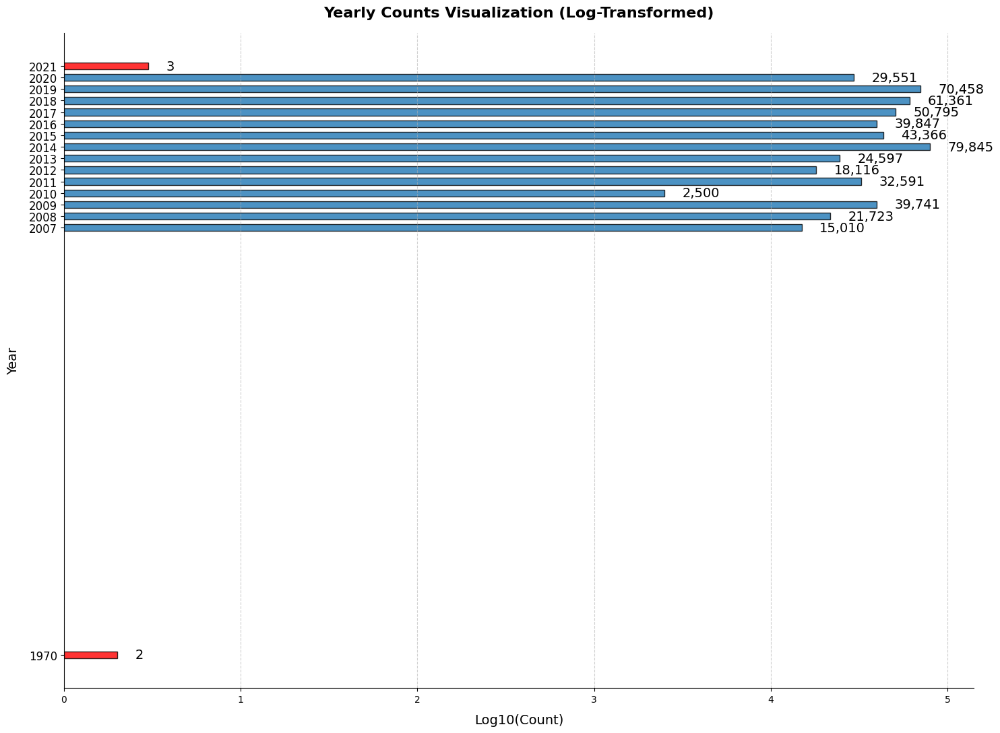

In [44]:
if 'year' in df_integrated.columns:
    # Calculate value counts and sort by index for better visualization
    year_counts = df_integrated['year'].value_counts().sort_index()

    # Apply logarithmic transformation to the counts
    log_counts = np.log10(year_counts)

    # Define colors: red for 2021 and 1970, blue for others
    bar_colors = ['red' if year in [2021, 1970] else '#1f77b4' for year in year_counts.index]

    # Plotting the data
    plt.figure(figsize=(15, 11))  # Increased figure height for better spacing
    bar_height = 0.6  # Reduce the bar height to increase space
    bars = plt.barh(year_counts.index, log_counts, height=bar_height, color=bar_colors, edgecolor='black', alpha=0.8)

    # Annotate the bars with their original counts (not transformed)
    for i, bar in enumerate(bars):
        original_value = year_counts.iloc[i]
        plt.text(
            bar.get_width() + 0.1,  # Position to the right of the bar
            bar.get_y() + bar.get_height() / 2,  # Vertically centered
            f'{int(original_value):,}',  # Format with commas
            va='center', fontsize=14, color='black' # Larger and bold text
        )

    # Customize the plot
    plt.xlabel('Log10(Count)', fontsize=14, labelpad=10)
    plt.ylabel('Year', fontsize=14, labelpad=10)
    plt.title('Yearly Counts Visualization (Log-Transformed)', fontsize=16, fontweight='bold', pad=17)

    # Add all years to the y-axis
    plt.yticks(ticks=year_counts.index, labels=year_counts.index, fontsize=12)

    # Add gridlines and adjust spacing
    plt.grid(axis='x', linestyle='--', alpha=0.6)

    # Remove unnecessary axes
    ax = plt.gca()
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    # Ensure adequate spacing for all elements
    plt.tight_layout()

    # Display the plot
    plt.show()
else:
    print("The 'year' column does not exist in the DataFrame.")


- **Image Distribution Across Years:** The majority of images in the dataset are concentrated between the years 2007 and 2020. Notably, there are two outlier years: 1970 with only 2 images and 2021 with only 3 images. The year 2014 holds the record for the highest number of images.

- **Visualization Note:** The values on the x-axis are logged to clearly highlight outlier years.

- **Quality Assessment:** We plan to review a selection of images from across the entire time range to evaluate changes in `image quality` over the years.
    - **Assumption on Technological Impact on Image Quality:** Intuitively, we hypothesize that images from earlier years, such as 1970, may be in black and white and of lower quality compared to those from more recent years like 2021, where advancements in imaging technology are expected to have significantly improved the quality of the images.
- Now, we will move on displaying the images of the **outliers** years.


In [45]:
urls_1970 = df_integrated[df_integrated['year'] == 1970]['url_image'] # Filter the DataFrame for rows where 'year' is 1970
urls_1970_list = urls_1970.tolist() # Save the result to a list
city = "Bangkok" # Dynamic city name
urls_1970_with_path = [f"downloaded_data/Images/{city}/{url}" for url in urls_1970_list] # Prepend the path to each URL
print(urls_1970_with_path) # Print the modified list

['downloaded_data/Images/Bangkok/Bangkok_0002145_1970_08_374_13.7392454_100.53952_CAoSLEFGMVFpcFBsZXRwSmN4RF8xeHVkdXp3OFBsNU9YN09uLV9GRFhRNl9KeEt5.jpg', 'downloaded_data/Images/Bangkok/Bangkok_0002451_1970_01_204_13.74323364560234_100.4988409951329_CAoSLEFGMVFpcE1WVjZORndwbHVIX2ZjV3NVWEFzNjgwUFdZQXFOeGZLLXdpR3JB.jpg']


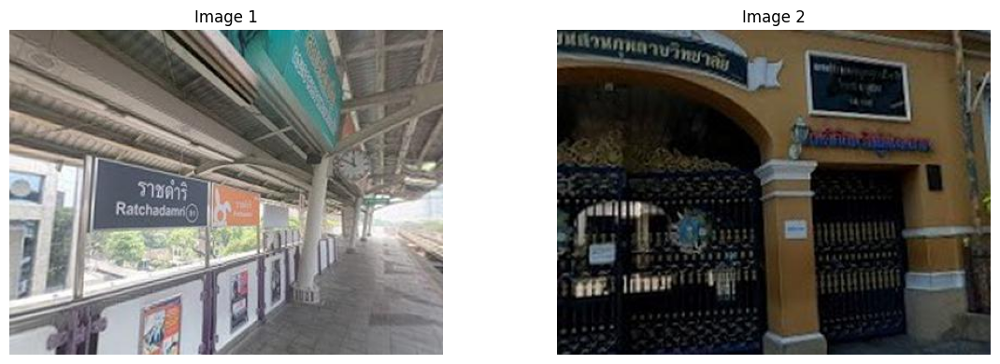

In [46]:
def display_images_from_paths(image_paths, titles=None):
    """
    Display images side by side from a list of file paths.

    Parameters:
        image_paths (list): List of image file paths.
        titles (list, optional): List of titles for the images. If None, images are titled by index.
    """
    plt.figure(figsize=(12, len(image_paths) * 2))  # Adjust figure size dynamically

    for i, image_path in enumerate(image_paths):
        try:
            # Open the image
            img = Image.open(image_path)

            # Add subplot for the image
            plt.subplot(1, len(image_paths), i + 1)  # 1 row, as many columns as images
            plt.imshow(img)
            plt.axis('off')  # Hide axes for cleaner look

            # Add title
            title = titles[i] if titles and i < len(titles) else f"Image {i + 1}"
            plt.title(title, fontsize=12)
        except FileNotFoundError:
            print(f"Image not found: {image_path}")
        except Exception as e:
            print(f"Error loading image {image_path}: {e}")

    # Adjust layout and display
    plt.tight_layout()
    plt.show()

display_images_from_paths(urls_1970_with_path) # Call the function

- **Quality of Historical Images:** Contrary to expectations, the older images in the dataset exhibit surprisingly good color quality despite their age.
- **Outlier Analysis for 2021:** We also focus on displaying images from 2021, as this year is identified as an outlier with notably few images.

In [47]:
# Filter the DataFrame for rows where 'year' is 2021
urls_2021 = df_integrated[df_integrated['year'] == 2021]['url_image']
# Save the result to a list
urls_2021_list = urls_2021.tolist()
# Dynamically update the city in the file path
urls_2021_with_path = [
    f"downloaded_data/Images/{url.split('_')[0]}/{url}" for url in urls_2021_list
]
# Print the modified list
print(urls_2021_with_path)

['downloaded_data/Images/Madrid/Madrid_0002019_2021_02_114_40.42835546_-3.66686136_CAoSLEFGMVFpcE1Wc2lGY095aG5rZEZFWDVHbEVfSWtSRGhUNk52V0pmRl9KRkxo.jpg', 'downloaded_data/Images/Medellin/Medellin_0000732_2021_02_130_6.24416626197887_-75.56538071483372_CAoSLEFGMVFpcE1hMFI2dmVPV2hFR3d3ZGp3MWNiYXhJOWRLd1pKdjdOVWJhT2J3.jpg', 'downloaded_data/Images/London/London_0000079_2021_02_19_51.48646617623537_-0.124873745981688_CAoSLEFGMVFpcE1jMmlSTWFaSHpzQWRUelZLRUZVRl8yV3A5Z2xTNnI1dFdTZy02.jpg']


Image not found: downloaded_data/Images/London/London_0000079_2021_02_19_51.48646617623537_-0.124873745981688_CAoSLEFGMVFpcE1jMmlSTWFaSHpzQWRUelZLRUZVRl8yV3A5Z2xTNnI1dFdTZy02.jpg


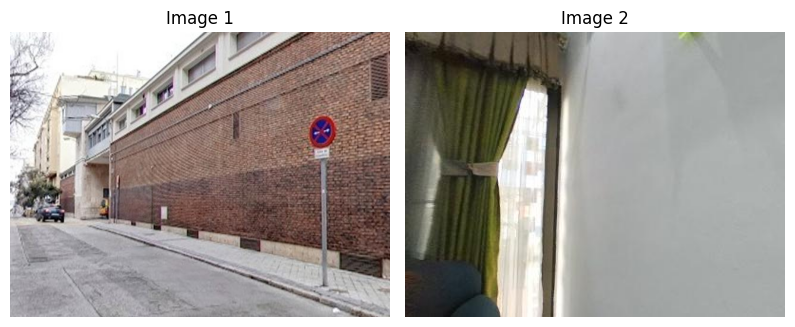

In [48]:
display_images_from_paths(urls_2021_with_path) # Call the function

- **Consistent Image Quality:** Similar to previous observations, the images are in color and maintain a good quality.
- **Assessment Strategy for Image Quality:** To better understand and assess the quality of images, we consider it beneficial to review the images on a yearly basis.
    - For this purpose we wrote the following block of code selecting random images per **year**.

In [49]:
# Initialize the list to hold the ordered images
ordered_images_list = []
# Iterate through the years from 2007 to 2020
for year in range(2007, 2021):  # Inclusive of 2020
    # Filter the DataFrame for the current year
    urls_year = df_integrated[df_integrated['year'] == year]['url_image']
    # Convert the URLs to a list
    urls_year_list = urls_year.tolist()  
    # Randomly select 2 images if there are enough images, otherwise take all available
    if len(urls_year_list) > 2:
        selected_images = random.sample(urls_year_list, 2)
    else:
        selected_images = urls_year_list  
    # Prepend the path dynamically with the correct city extracted from the filename
    selected_images_with_path = [
        f"downloaded_data/Images/{url.split('_')[0]}/{url}" for url in selected_images
    ]  
    # Add the selected images to the ordered list
    ordered_images_list.extend(selected_images_with_path)
# Print the ordered list
for image in ordered_images_list:
    print(image)


downloaded_data/Images/Melbourne/Melbourne_0002181_2007_11_16_-37.83269411499046_144.952909196169_19eG1ZqWpgQ1rG-bo3lcdw.jpg
downloaded_data/Images/Miami/Miami_0007114_2007_11_320_25.78680994558704_-80.18915575485072_kyMtL_7Hq5FHJ8zdOu8MXQ.jpg
downloaded_data/Images/PRS/PRS_0001880_2008_05_423_48.84132390585151_2.25149661987744_E-Tlods71oP-uKmoAWlUMQ.jpg
downloaded_data/Images/Madrid/Madrid_0000649_2008_09_76_40.40518647671719_-3.703415056578373_nNpYkHh6MA_6O6rHz3y9uQ.jpg
downloaded_data/Images/Phoenix/Phoenix_0002988_2009_03_297_33.45329181564217_-112.1085907639087_0hWb2zMwIlChhPSyJrmarA.jpg
downloaded_data/Images/Lisbon/Lisbon_0004316_2009_05_306_38.73724077411768_-9.11724306780042_7KUfHnpUm2kXwMjq4rhj8Q.jpg
downloaded_data/Images/Melbourne/Melbourne_0002867_2010_01_198_-37.82638054746126_144.9496803426193_9grAyeRvE_B7MfarSYEicA.jpg
downloaded_data/Images/MexicoCity/MexicoCity_0000311_2010_02_440_19.41228308965004_-99.1783249141766_bBB_lWJQu-29mnLYGckEgw.jpg
downloaded_data/Images/Me

- **Random Image Selection for Review:** The output displayed above represents a selection of images chosen randomly for observation.
- Then, we wrote the function `display_images_with_year` in order to display the random images per year.

Image Paths:
downloaded_data/Images/Melbourne/Melbourne_0002181_2007_11_16_-37.83269411499046_144.952909196169_19eG1ZqWpgQ1rG-bo3lcdw.jpg
downloaded_data/Images/Miami/Miami_0007114_2007_11_320_25.78680994558704_-80.18915575485072_kyMtL_7Hq5FHJ8zdOu8MXQ.jpg
downloaded_data/Images/PRS/PRS_0001880_2008_05_423_48.84132390585151_2.25149661987744_E-Tlods71oP-uKmoAWlUMQ.jpg
downloaded_data/Images/Madrid/Madrid_0000649_2008_09_76_40.40518647671719_-3.703415056578373_nNpYkHh6MA_6O6rHz3y9uQ.jpg
downloaded_data/Images/Phoenix/Phoenix_0002988_2009_03_297_33.45329181564217_-112.1085907639087_0hWb2zMwIlChhPSyJrmarA.jpg
downloaded_data/Images/Lisbon/Lisbon_0004316_2009_05_306_38.73724077411768_-9.11724306780042_7KUfHnpUm2kXwMjq4rhj8Q.jpg
downloaded_data/Images/Melbourne/Melbourne_0002867_2010_01_198_-37.82638054746126_144.9496803426193_9grAyeRvE_B7MfarSYEicA.jpg
downloaded_data/Images/MexicoCity/MexicoCity_0000311_2010_02_440_19.41228308965004_-99.1783249141766_bBB_lWJQu-29mnLYGckEgw.jpg
downloaded_d

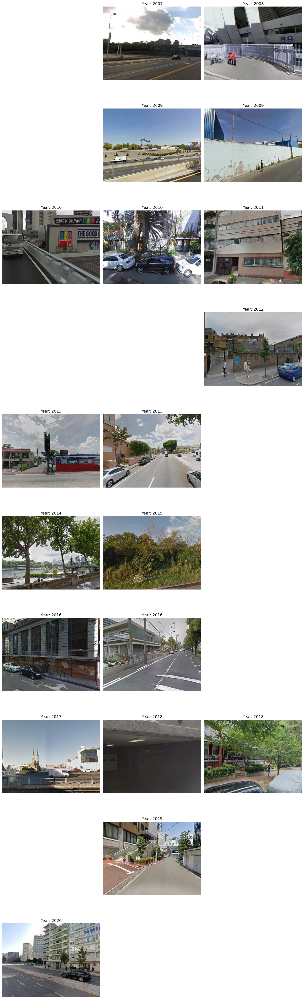

In [51]:
def display_images_with_year(image_paths):
    """
    Display a series of images with their associated years in a Jupyter Notebook.

    Parameters:
        image_paths (list): List of file paths to the images.
    """
    # Print all image paths
    print("Image Paths:")
    for path in image_paths:
        print(path)

    # Calculate the number of rows needed (3 images per row)
    images_per_row = 3
    n_images = len(image_paths)
    n_rows = (n_images + images_per_row - 1) // images_per_row

    # Create the figure
    plt.figure(figsize=(15, n_rows * 5))  # Adjust size for better spacing

    # Loop through the image paths and display them
    for i, image_path in enumerate(image_paths):
        try:
            # Extract the year from the file path (assumes year is after the 4th underscore)
            year = image_path.split('_')[3]

            # Open the image
            img = Image.open(image_path)

            # Add a subplot for each image
            plt.subplot(n_rows, images_per_row, i + 1)
            plt.imshow(img)
            plt.axis('off')  # Hide axes for a cleaner look
            plt.title(f"Year: {year}", fontsize=14)  # Add year as title
        except FileNotFoundError:
            print(f"Image not found: {image_path}")
        except Exception as e:
            print(f"Error loading image {image_path}: {e}")

    # Adjust layout and display the images
    plt.tight_layout()
    plt.show()

display_images_with_year(ordered_images_list)

- **Missing Images in Dataframe:** Some rows within the dataset do not contain images, implying mismatches between the provided paths and actual file locations. We will remove these rows from the dataframe to ensure data integrity.

- **Image Quality Consistency:** Upon reviewing images plotted across different years (arranged in chronological order), we observe no significant differences in quality, indicating consistency across the dataset, which is a positive finding.
    - In the first line in teh second image of 2007 year the image seem not to have a good quality comared to teh reamining ones, but generally despite the year teh images has a good quality.

- **Handling Missing Paths:** It is evident that some auto-generated paths do not correspond to actual images. We will address this issue by dropping rows with corrupted paths in subsequent cells.

- **Important Note** like now and then in this Jupyter we will re print images because our main task is clustering, observing the data is the key. 
    - At first glance, we can observe that we have a range of images like : 
        - Images focusing on `Green places`
        - Images focusing on `Buildings`
        - Images focusing on `streets`
        - Images being `light` (e.g. good weather) and other being darkness (cloudy weather).
        - Images focusing on diffrent directions e.g. on the houses / building instead of the streets. 
    - `Hint` : These emprical observartions are the key to help as next with potential useful features that we have to create.
- Now we will in short test the distribution aross cities regarding year and month. 
    - Intuitively, having many images in summer months may imply more light images.
    - however, because they are metadata we will not spend much time in this analysis of that features.

/var/folders/br/6xtfsjcd1pld8d58t5wwkmcr0000gn/T/ipykernel_35178/2248517683.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=city_data, x='year', y='count', ax=axes[i], palette='viridis')
/var/folders/br/6xtfsjcd1pld8d58t5wwkmcr0000gn/T/ipykernel_35178/2248517683.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=city_data, x='year', y='count', ax=axes[i], palette='viridis')
/var/folders/br/6xtfsjcd1pld8d58t5wwkmcr0000gn/T/ipykernel_35178/2248517683.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=city_data, x='year'

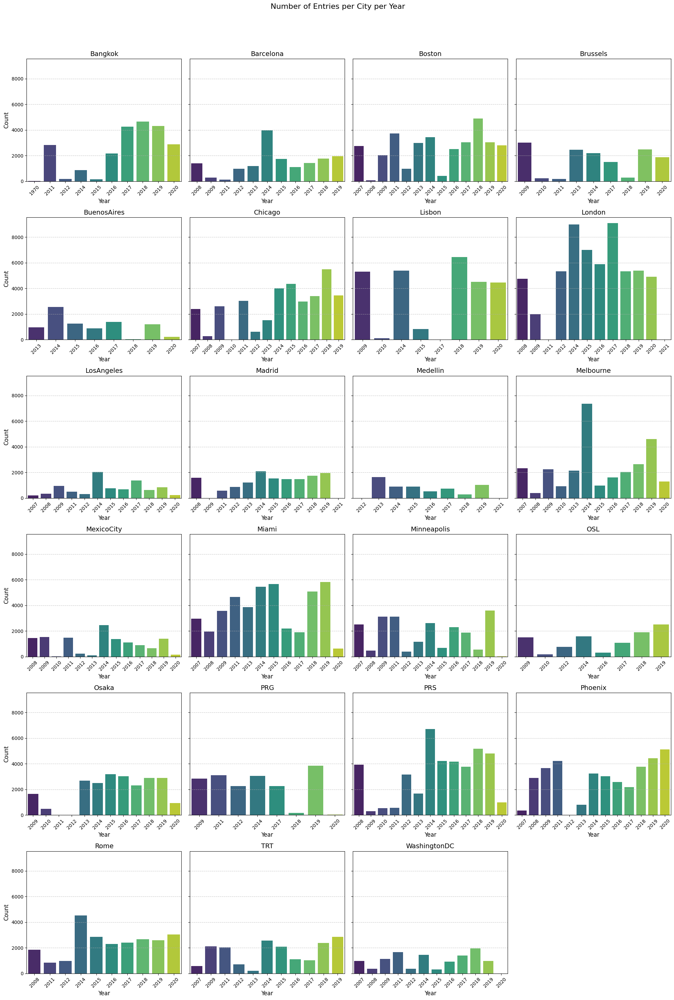

In [52]:
# Group by city_id and year to calculate counts
city_year_counts = df_integrated.groupby(['city_id', 'year']).size().reset_index(name='count')

# Extract unique cities
unique_cities = city_year_counts['city_id'].unique()

# Determine grid layout for plots
n_cities = len(unique_cities)
n_cols = 4  # Number of plots per row
n_rows = math.ceil(n_cities / n_cols)

fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 5 * n_rows), sharey=True)
axes = axes.flatten()

# Generate plots for each city
for i, city in enumerate(unique_cities):
    city_data = city_year_counts[city_year_counts['city_id'] == city]
    sns.barplot(data=city_data, x='year', y='count', ax=axes[i], palette='viridis')
    axes[i].set_title(f"{city}", fontsize=14)
    axes[i].set_xlabel("Year", fontsize=12)
    axes[i].set_ylabel("Count" if i % n_cols == 0 else "", fontsize=12)
    axes[i].tick_params(axis='x', rotation=45)
    axes[i].grid(axis='y', linestyle='--', alpha=0.7)

# Remove any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Add a main title and adjust layout
plt.suptitle("Number of Entries per City per Year", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

- **Variability in Image Distribution Across Cities and Years:** We observe that some cities have a higher number of images in specific years compared to others. For instance, in 2024, `Paris (PRS)` has a significantly larger image collection compared to `Washington DC`, where the number of images has decreased. 
    - This indicates that the distribution of images is not uniform across all cities and years, showcasing notable variations.

/var/folders/br/6xtfsjcd1pld8d58t5wwkmcr0000gn/T/ipykernel_35178/2545902092.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=city_data, x='month', y='count', ax=axes[i], palette='viridis')
/var/folders/br/6xtfsjcd1pld8d58t5wwkmcr0000gn/T/ipykernel_35178/2545902092.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=city_data, x='month', y='count', ax=axes[i], palette='viridis')
/var/folders/br/6xtfsjcd1pld8d58t5wwkmcr0000gn/T/ipykernel_35178/2545902092.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=city_data, x='mon

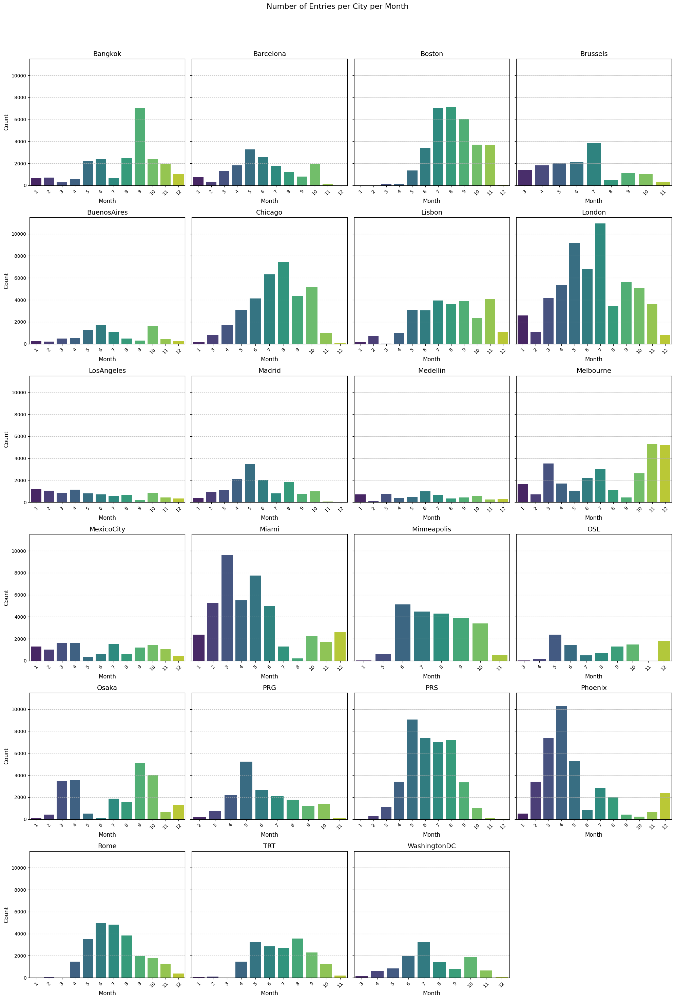

In [53]:
# Group by city_id and year to calculate counts
city_year_counts = df_integrated.groupby(['city_id', 'month']).size().reset_index(name='count')

# Extract unique cities
unique_cities = city_year_counts['city_id'].unique()

# Determine grid layout for plots
n_cities = len(unique_cities)
n_cols = 4  # Number of plots per row
n_rows = math.ceil(n_cities / n_cols)

fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 5 * n_rows), sharey=True)
axes = axes.flatten()

# Generate plots for each city
for i, city in enumerate(unique_cities):
    city_data = city_year_counts[city_year_counts['city_id'] == city]
    sns.barplot(data=city_data, x='month', y='count', ax=axes[i], palette='viridis')
    axes[i].set_title(f"{city}", fontsize=14)
    axes[i].set_xlabel("Month", fontsize=12)
    axes[i].set_ylabel("Count" if i % n_cols == 0 else "", fontsize=12)
    axes[i].tick_params(axis='x', rotation=45)
    axes[i].grid(axis='y', linestyle='--', alpha=0.7)

# Remove any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Add a main title and adjust layout
plt.suptitle("Number of Entries per City per Month", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

- **Variations in Monthly Image Distribution Across Cities:** Further analysis reveals that image distribution also varies by month within specific cities. Some cities experience a higher image count during certain months compared to others. For example, `Phoenix` in `March` has a notably higher number of images compared to `Oslo (OSL)`, where the image count is considerably lower during the same month. Furthermore, the diffrent distributions acrosss specific months could influence factors like the perceived **brightness** of images due to differing lighting conditions throughout the year.
- Now, we will move on handling the un-matched image paths in order to remove them.

In [54]:
# Define the base path for the images
base_path = "downloaded_data/Images/"
# Add the new column with the full file path
df_integrated['file_path'] = df_integrated.apply(
    lambda row: os.path.join(base_path, row['city_id'], row['url_image']),
    axis=1
)
# Investigate if the path exists
df_integrated['path_exists'] = df_integrated['file_path'].apply(os.path.exists)

In [55]:
print(round((df_integrated.shape[0] - df_integrated[df_integrated['path_exists'] == False].shape[0])*100 / df_integrated.shape[0]), '%')

81 %


- We observe that about 20% of the paths were corrupted so we removed them. 
    - So, in way we had missing values. 

In [56]:
# Remove rows where 'url_image' is False
# Ensure 'url_image' is being compared correctly and remove rows with 'False' (as boolean or string)
df_integrated = df_integrated[~(df_integrated['path_exists'] == False) & ~(df_integrated['path_exists'] == 'False')]
df_integrated

,year,month,northdeg,city_id,lat,lon,panoid,url_image,file_path,path_exists
place_id,,,,,,,,,,
1746,2014,2,140,Madrid,40.424332,-3.708372,oWCkDzuaXRAzU2HpwHRxpA,Madrid_0001746_2014_02_140_40.42433229530147_-...,downloaded_data/Images/Madrid/Madrid_0001746_2...,True
1667,2011,4,278,Madrid,40.422298,-3.671313,Fe3LcKMItNG8Iq6ybpIH-A,Madrid_0001667_2011_04_278_40.42229839861123_-...,downloaded_data/Images/Madrid/Madrid_0001667_2...,True
2127,2011,4,328,Madrid,40.430231,-3.675223,UbAd6zgFnw8lCfiyevQW4g,Madrid_0002127_2011_04_328_40.43023058035911_-...,downloaded_data/Images/Madrid/Madrid_0002127_2...,True
2109,2018,7,347,Madrid,40.430127,-3.691862,iCCwr7uBgLpQIe63YbvmsA,Madrid_0002109_2018_07_347_40.43012682167523_-...,downloaded_data/Images/Madrid/Madrid_0002109_2...,True
916,2012,5,296,Madrid,40.409193,-3.668758,M2J81KtMuxuIcXWhE25uhw,Madrid_0000916_2012_05_296_40.4091933254677_-3...,downloaded_data/Images/Madrid/Madrid_0000916_2...,True
...,...,...,...,...,...,...,...,...,...,...
3151,2017,9,530,PRS,48.867335,2.303481,rbaOu9XYm5qZuLMNNT4HaQ,PRS_0003151_2017_09_530_48.86733496902166_2.30...,downloaded_data/Images/PRS/PRS_0003151_2017_09...,True
2690,2015,6,308,PRS,48.857356,2.335159,ZYyWY2wsGXBt7TXvoZoYHg,PRS_0002690_2015_06_308_48.85735575252326_2.33...,downloaded_data/Images/PRS/PRS_0002690_2015_06...,True
1330,2015,7,320,PRS,48.827218,2.209339,LWrQmQ9m683YeTv7BfOlFw,PRS_0001330_2015_07_320_48.8272175704373_2.209...,downloaded_data/Images/PRS/PRS_0001330_2015_07...,True


In [57]:
df_integrated.info()

<class 'pandas.core.frame.DataFrame'>
Index: 428934 entries, 1746 to 2706
Data columns (total 10 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   year         428934 non-null  int64  
 1   month        428934 non-null  int64  
 2   northdeg     428934 non-null  int64  
 3   city_id      428934 non-null  object 
 4   lat          428934 non-null  float64
 5   lon          428934 non-null  float64
 6   panoid       428934 non-null  object 
 7   url_image    428934 non-null  object 
 8   file_path    428934 non-null  object 
 9   path_exists  428934 non-null  bool   
dtypes: bool(1), float64(2), int64(3), object(4)
memory usage: 33.1+ MB


- **No Missing Values Across Columns:** All columns in the dataset are complete, with each containing exactly `428,934` entries, confirming there are no missing values.

- **Data Type Consistency:** We will convert all data types categorized under 'object' into strings to ensure uniformity across the dataset.


In [58]:
# Convert specific columns to string
df_integrated['city_id'] = df_integrated['city_id'].astype('string')
df_integrated['panoid'] = df_integrated['panoid'].astype('string')
df_integrated['url_image'] = df_integrated['url_image'].astype('string')
df_integrated['file_path'] = df_integrated['file_path'].astype('string')

/var/folders/br/6xtfsjcd1pld8d58t5wwkmcr0000gn/T/ipykernel_35178/2012677407.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_integrated['city_id'] = df_integrated['city_id'].astype('string')
/var/folders/br/6xtfsjcd1pld8d58t5wwkmcr0000gn/T/ipykernel_35178/2012677407.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_integrated['panoid'] = df_integrated['panoid'].astype('string')
/var/folders/br/6xtfsjcd1pld8d58t5wwkmcr0000gn/T/ipykernel_35178/2012677407.py:4: SettingWithCopyWarning: 
A value is tr

In [59]:
df_integrated.duplicated().any()

False

- Fine we have not duplicted rows. 
- Having an overall view of metadata we analysied the description report below and we observed the follwoing insights : 
    - **Yearly Distribution of Data:** The dataset spans from 1970 to 2021, with the majority of data concentrated around the mean year of 2014. The standard deviation indicates a spread of approximately 3.6 years, suggesting most data points are recent.

    - **Geographic Spread:** Latitude and longitude values show a wide geographical distribution. The latitude ranges from -37.85 to 59.96, indicating a global dataset encompassing both northern and southern hemispheres. Longitude spans from -118.27 to 145.03, covering a significant portion of the western and eastern hemispheres.

    - **Month and Degrees North:** Data are collected throughout all months, with a slight concentration around July (mean of 6.71). The 'northdeg' variable, potentially indicating degrees north of the equator or a related metric, varies widely, suggesting diverse conditions or contexts for the data collected.

In [60]:
df_integrated.describe()

,year,month,northdeg,lat,lon
count,428934.000000,428934.000000,428934.000000,428934.000000,428934.000000
mean,2014.860825,6.709951,292.338169,34.311851,-17.516963
std,3.615849,2.681425,128.589169,21.954060,74.563274
min,1970.000000,1.000000,-11.000000,-37.855112,-118.269450
25%,2013.000000,5.000000,193.000000,33.443988,-80.226074
50%,2015.000000,7.000000,277.000000,41.844870,-3.658292
75%,2018.000000,9.000000,354.000000,48.833094,10.665769
max,2021.000000,12.000000,731.000000,59.958270,145.025639


- Furthermore, we will focus in short in teh metadata `lot` and `lan` in short to observe if the palces id are close to them, if they are this might means that the images will be similar among them. In other way, we will apply in sort leveraging scatterplots proximity analsyis.

- more specifically: 
    - **Scatter Plot Generation**: The script organizes data by `city_id` and generates scatter plots for each city, plotting latitude against longitude to visualize geographical distribution. Each plot represents a unique city with data points marked to indicate specific locations within that city. The number of plots per row is set to five, and additional rows are added as needed based on the total number of cities.

    - **Figure Configuration and Customization**: Each plot is individually labeled with the city's ID, and axes labels for longitude and latitude are set for clarity. Any excess subplot axes not needed (due to a count of cities not filling the last row completely) are hidden to maintain visual cleanliness. The figure layout is adjusted for optimal spacing to enhance readability and presentation.

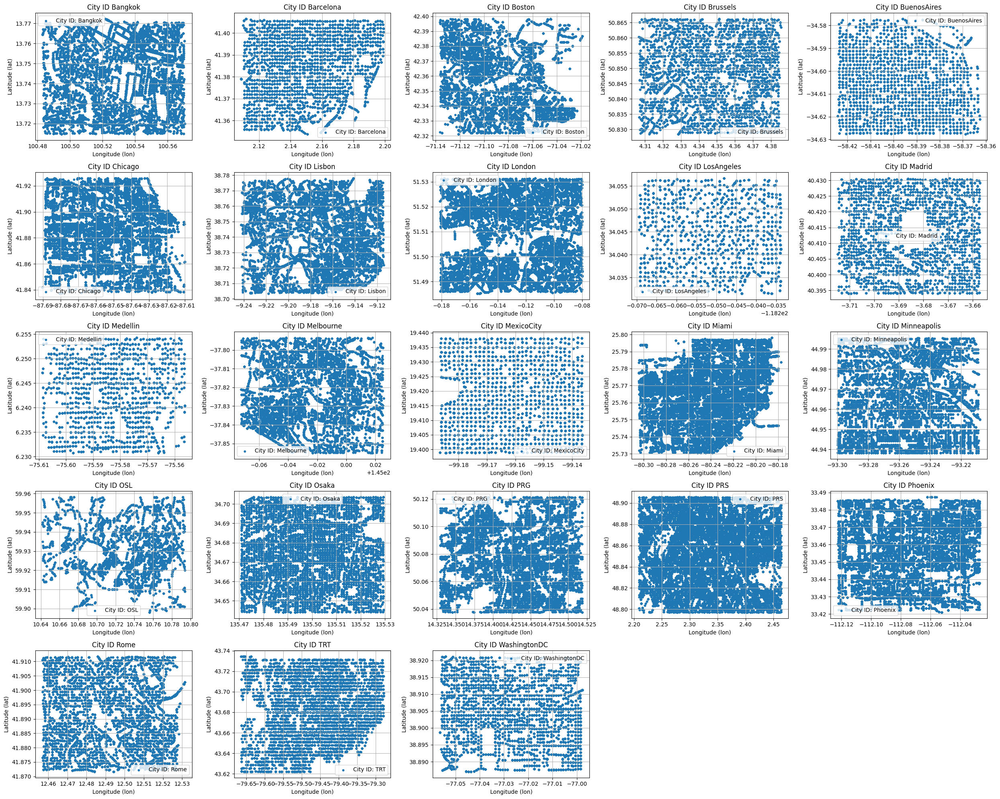

In [61]:
# Group the DataFrame by 'city_id'
grouped = df_integrated.groupby('city_id')

# Number of plots per row
plots_per_row = 5

# Determine the number of rows needed
total_plots = len(grouped)
rows = (total_plots // plots_per_row) + (total_plots % plots_per_row > 0)

# Initialize the figure
fig, axes = plt.subplots(rows, plots_per_row, figsize=(plots_per_row * 5, rows * 4))
axes = axes.flatten()  # Flatten the axes array for easy indexing

# Create a plot for each city_id
for i, (city_id, group) in enumerate(grouped):
    ax = axes[i]
    ax.scatter(group['lon'], group['lat'], s=10, label=f'City ID: {city_id}')  # Set dot size using `s=10`
    ax.set_title(f'City ID {city_id}')
    ax.set_xlabel('Longitude (lon)')
    ax.set_ylabel('Latitude (lat)')
    ax.legend()
    ax.grid(True)

# Hide any unused axes
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])
# Adjust layout for better spacing
plt.tight_layout()
plt.show()

- Some cities like Mexico are not sparce (in othrs words don't have many images from the same places) in comparison to cities like PRS.
- At this point we will try intuitively to understand the column `Northdeg` as we want to understand all features of the provided datafarme. 
    - Firslty, we will create a simple histogram to understand the values that is accepts and the distribution of them, too.
    - then we will plot the outpliers values meaniong the min and max values and the avg values, too.

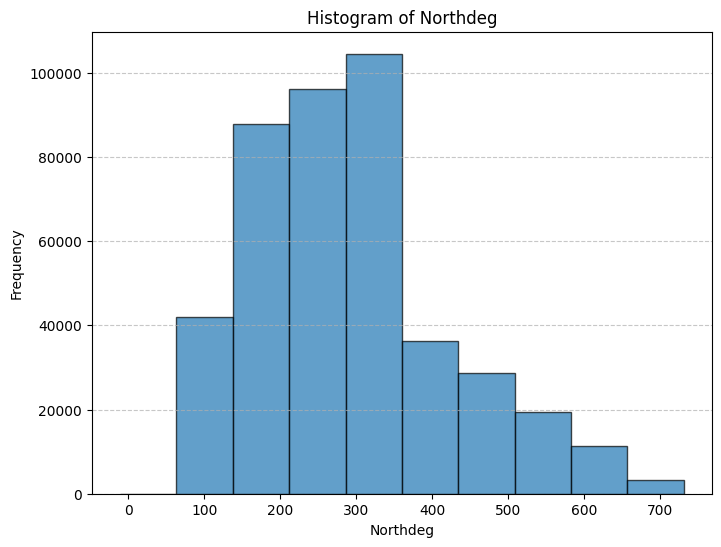

In [62]:
# north deg ditribution 
# Create a histogram of the 'northdeg' column
plt.figure(figsize=(8, 6))
plt.hist(df_integrated['northdeg'], bins=10, edgecolor='black', alpha=0.7)
plt.title("Histogram of Northdeg")
plt.xlabel("Northdeg")
plt.ylabel("Frequency")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

- **Central Concentration of Data**: The histogram shows that the majority of "Northdeg" values are centrally concentrated around the 200 to 400 range, indicating a peak frequency in this interval. This suggests that most data points fall within these degrees north, reflecting a specific geographical focus or commonality among the dataset's locations.

- **Declining Frequencies Beyond the Peak**: There is a noticeable decrease in frequency as the "Northdeg" values increase beyond 400 and decrease below 200, with very few data points near the extremes of 0 and 700. This tailing off indicates less common or outlier geographical positions within the dataset.

- Beause intuitively ans searching from it the feature may be related to the diretion in chich the images taken, we will plot from the provided iamges only images having the min ~avg and maz value of this feature. 

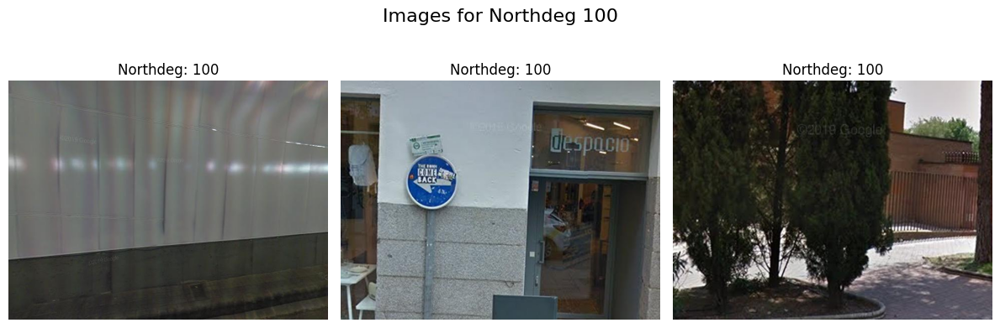

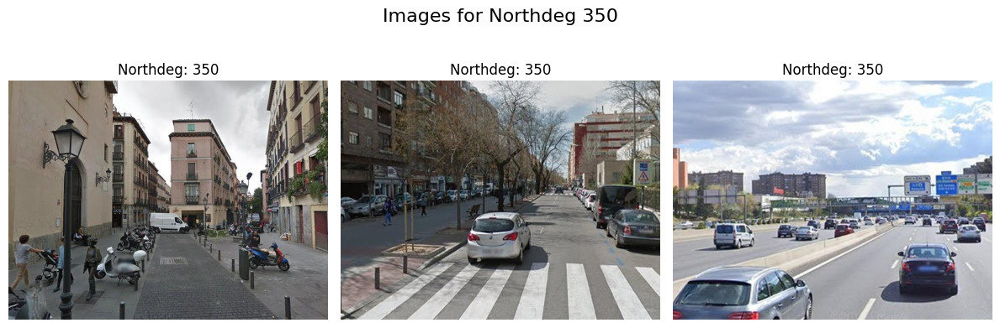

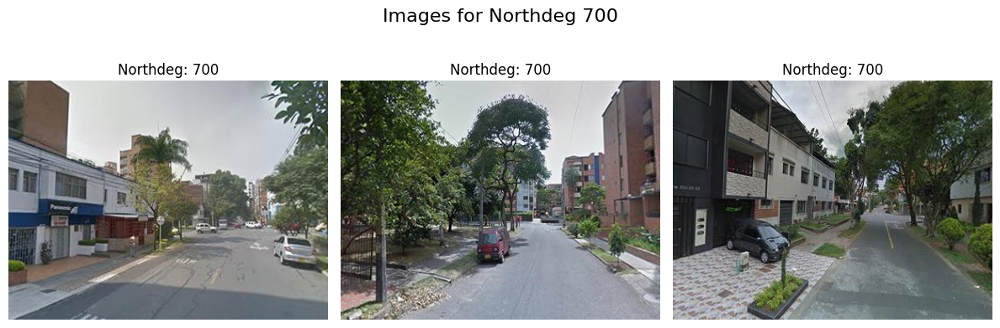

In [63]:
# Filter the DataFrame for rows where 'northdeg' is 100, 350, or 700
filtered_df = df_integrated[df_integrated['northdeg'].isin([100, 350, 700])]

# Set the number of images to display per row
images_per_row = 3

# Get unique northdeg values
northdeg_values = [100, 350, 700]

# Plot 3 images per row for each northdeg value
for northdeg in northdeg_values:
    # Filter the rows for the current northdeg value
    subset = filtered_df[filtered_df['northdeg'] == northdeg].head(images_per_row)
    
    # Initialize the plot
    fig, axes = plt.subplots(1, images_per_row, figsize=(images_per_row * 4, 4))
    fig.suptitle(f"Images for Northdeg {northdeg}", fontsize=16)
    
    # Loop through the subset and display images
    for i, (index, row) in enumerate(subset.iterrows()):
        try:
            img = mpimg.imread(row['file_path'])  # Read the image from the file path
            axes[i].imshow(img)
            axes[i].set_title(f"Northdeg: {row['northdeg']}")
            axes[i].axis('off')  # Hide axes
        except FileNotFoundError:
            axes[i].axis('off')  # Hide axes if no image is found
            axes[i].set_title("File Not Found")
    
    # Hide any unused axes if there are fewer images than `images_per_row`
    for j in range(len(subset), images_per_row):
        axes[j].axis('off')
    
    # Adjust layout
    plt.tight_layout(rect=[0, 0, 1, 0.9])  # Adjust for title
    plt.show()


- Indeed this feature is related to the direction of images for example the first row of images focuses on the buildings side whereas the reaming on steets.
    - This Feature helped as to understand our dataset better. 
    - `obsering the images` (or general your data) is the key. ``In clustering of images furstly we intuitively undestand how the images would be clusterd`. It is useful for creating features.  
    - E.g. Images have many objests (cars, bulidings) tehn we will need in EDA to create features related to object deections, 
    - E.g. Images are sunny / light thn color may paly iortant role as features ... 
- Now, we will mopve on via exploring the `**images**` data.
- **Image Size Calculation and Conversion:** This code defines a function to retrieve the size of an image file in bytes, applies it to create a new column `image_size` in the DataFrame `df_integrated`, and then converts these values into kilobytes and megabytes in additional columns `image_size_kb` and `image_size_mb`, respectively.
    - This extra reation of data is useful for understanding the hardware limitations in a high first level.

In [64]:
# Function to get the size of the image
def get_image_size(file_path):
    try:
        return os.path.getsize(file_path)  # Size in bytes
    except OSError:
        return None  # Return None if the file path is invalid or inaccessible

# Apply the function to create a new column
df_integrated['image_size'] = df_integrated['file_path'].apply(get_image_size)

# Convert size to KB or MB if needed
df_integrated['image_size_kb'] = df_integrated['image_size'] / 1024  # Size in KB
df_integrated['image_size_mb'] = df_integrated['image_size_kb'] / 1024  # Size in MB
df_integrated

/var/folders/br/6xtfsjcd1pld8d58t5wwkmcr0000gn/T/ipykernel_35178/2173179083.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_integrated['image_size'] = df_integrated['file_path'].apply(get_image_size)
/var/folders/br/6xtfsjcd1pld8d58t5wwkmcr0000gn/T/ipykernel_35178/2173179083.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_integrated['image_size_kb'] = df_integrated['image_size'] / 1024  # Size in KB
/var/folders/br/6xtfsjcd1pld8d58t5wwkmcr0000gn/T/ipykernel_35178/2173179083.py:13: SettingWith

,year,month,northdeg,city_id,lat,lon,panoid,url_image,file_path,path_exists,image_size,image_size_kb,image_size_mb
place_id,,,,,,,,,,,,,
1746,2014,2,140,Madrid,40.424332,-3.708372,oWCkDzuaXRAzU2HpwHRxpA,Madrid_0001746_2014_02_140_40.42433229530147_-...,downloaded_data/Images/Madrid/Madrid_0001746_2...,True,35015,34.194336,0.033393
1667,2011,4,278,Madrid,40.422298,-3.671313,Fe3LcKMItNG8Iq6ybpIH-A,Madrid_0001667_2011_04_278_40.42229839861123_-...,downloaded_data/Images/Madrid/Madrid_0001667_2...,True,32821,32.051758,0.031301
2127,2011,4,328,Madrid,40.430231,-3.675223,UbAd6zgFnw8lCfiyevQW4g,Madrid_0002127_2011_04_328_40.43023058035911_-...,downloaded_data/Images/Madrid/Madrid_0002127_2...,True,71852,70.167969,0.068523
2109,2018,7,347,Madrid,40.430127,-3.691862,iCCwr7uBgLpQIe63YbvmsA,Madrid_0002109_2018_07_347_40.43012682167523_-...,downloaded_data/Images/Madrid/Madrid_0002109_2...,True,61962,60.509766,0.059092
916,2012,5,296,Madrid,40.409193,-3.668758,M2J81KtMuxuIcXWhE25uhw,Madrid_0000916_2012_05_296_40.4091933254677_-3...,downloaded_data/Images/Madrid/Madrid_0000916_2...,True,61315,59.877930,0.058475
...,...,...,...,...,...,...,...,...,...,...,...,...,...
3151,2017,9,530,PRS,48.867335,2.303481,rbaOu9XYm5qZuLMNNT4HaQ,PRS_0003151_2017_09_530_48.86733496902166_2.30...,downloaded_data/Images/PRS/PRS_0003151_2017_09...,True,33337,32.555664,0.031793
2690,2015,6,308,PRS,48.857356,2.335159,ZYyWY2wsGXBt7TXvoZoYHg,PRS_0002690_2015_06_308_48.85735575252326_2.33...,downloaded_data/Images/PRS/PRS_0002690_2015_06...,True,19654,19.193359,0.018744
1330,2015,7,320,PRS,48.827218,2.209339,LWrQmQ9m683YeTv7BfOlFw,PRS_0001330_2015_07_320_48.8272175704373_2.209...,downloaded_data/Images/PRS/PRS_0001330_2015_07...,True,31374,30.638672,0.029921


- We can observe that created the folloowing new columns :  `mage_size`,`image_size_kb`,`image_size_mb`.
- Ina ddition we will extend more the dataframe for calculatiing the hegiht and width of each image.
    - For this purpose we write the function `get_image_dimensions`.
- The diffent size of images may be a challenge as they may affect the quality of images. 
- In otehr words, 
    - **Impact of Image Dimensions on Quality**: The resolution of images, defined by their height and width, critically affects image quality, posing challenges such as increased processing and storage requirements, the need for consistent analysis across varying resolutions, potential quality degradation during scaling, and higher bandwidth needs for transmission.

In [65]:
# Assuming df_integrated is your DataFrame and 'file_path' contains the image paths

# Function to get image dimensions
def get_image_dimensions(file_path):
    try:
        with Image.open(file_path) as img:
            return img.width, img.height  # Return width and height
    except Exception:
        return None, None  # Handle any errors (e.g., file not found or unsupported format)

# Apply the function to the DataFrame
df_integrated['image_width'], df_integrated['image_height'] = zip(*df_integrated['file_path'].apply(get_image_dimensions))
df_integrated

/var/folders/br/6xtfsjcd1pld8d58t5wwkmcr0000gn/T/ipykernel_35178/1933336166.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_integrated['image_width'], df_integrated['image_height'] = zip(*df_integrated['file_path'].apply(get_image_dimensions))
/var/folders/br/6xtfsjcd1pld8d58t5wwkmcr0000gn/T/ipykernel_35178/1933336166.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_integrated['image_width'], df_integrated['image_height'] = zip(*df_integrated['file_path'].apply(get_image_dimensions))


,year,month,northdeg,city_id,lat,lon,panoid,url_image,file_path,path_exists,image_size,image_size_kb,image_size_mb,image_width,image_height
place_id,,,,,,,,,,,,,,,
1746,2014,2,140,Madrid,40.424332,-3.708372,oWCkDzuaXRAzU2HpwHRxpA,Madrid_0001746_2014_02_140_40.42433229530147_-...,downloaded_data/Images/Madrid/Madrid_0001746_2...,True,35015,34.194336,0.033393,640,480
1667,2011,4,278,Madrid,40.422298,-3.671313,Fe3LcKMItNG8Iq6ybpIH-A,Madrid_0001667_2011_04_278_40.42229839861123_-...,downloaded_data/Images/Madrid/Madrid_0001667_2...,True,32821,32.051758,0.031301,640,480
2127,2011,4,328,Madrid,40.430231,-3.675223,UbAd6zgFnw8lCfiyevQW4g,Madrid_0002127_2011_04_328_40.43023058035911_-...,downloaded_data/Images/Madrid/Madrid_0002127_2...,True,71852,70.167969,0.068523,640,480
2109,2018,7,347,Madrid,40.430127,-3.691862,iCCwr7uBgLpQIe63YbvmsA,Madrid_0002109_2018_07_347_40.43012682167523_-...,downloaded_data/Images/Madrid/Madrid_0002109_2...,True,61962,60.509766,0.059092,640,480
916,2012,5,296,Madrid,40.409193,-3.668758,M2J81KtMuxuIcXWhE25uhw,Madrid_0000916_2012_05_296_40.4091933254677_-3...,downloaded_data/Images/Madrid/Madrid_0000916_2...,True,61315,59.877930,0.058475,640,480
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3151,2017,9,530,PRS,48.867335,2.303481,rbaOu9XYm5qZuLMNNT4HaQ,PRS_0003151_2017_09_530_48.86733496902166_2.30...,downloaded_data/Images/PRS/PRS_0003151_2017_09...,True,33337,32.555664,0.031793,400,300
2690,2015,6,308,PRS,48.857356,2.335159,ZYyWY2wsGXBt7TXvoZoYHg,PRS_0002690_2015_06_308_48.85735575252326_2.33...,downloaded_data/Images/PRS/PRS_0002690_2015_06...,True,19654,19.193359,0.018744,400,300
1330,2015,7,320,PRS,48.827218,2.209339,LWrQmQ9m683YeTv7BfOlFw,PRS_0001330_2015_07_320_48.8272175704373_2.209...,downloaded_data/Images/PRS/PRS_0001330_2015_07...,True,31374,30.638672,0.029921,400,300


- in the last column of the datfarame we can observe the new generated columns related to images metadata extracted from the raw jpg format.

In [66]:
df_integrated.image_height.value_counts()

image_height
480    242412
300    186522
Name: count, dtype: int64

- we can observe that we have images with heigh eithr `480` or `300`.

In [67]:
df_integrated.image_width.value_counts()

image_width
640    242412
400    186522
Name: count, dtype: int64

- we observe that we have images with width either `640` or `400`. 
- We can observe that we have diffrent images size
- So, `Challenge 2` `Size` of images (we will try to handle it next via resizing the images). 
- In addition, we will create the function `is_grayscale` to check if all images are colored ones. 

In [68]:
# Function to check if an image is grayscale
def is_grayscale(file_path):
    try:
        with Image.open(file_path) as img:
            # Convert image to RGB (if needed) and check channels
            img = img.convert("RGB")
            # Check if all channels (R, G, B) are equal for every pixel
            grayscale = all(pixel[0] == pixel[1] == pixel[2] for pixel in img.getdata())
            return not grayscale  # Return False if grayscale, True if colored
    except Exception:
        return None  # Handle errors gracefully

# Apply the function to the DataFrame
df_integrated['is_colored'] = df_integrated['file_path'].apply(is_grayscale)
df_integrated

/var/folders/br/6xtfsjcd1pld8d58t5wwkmcr0000gn/T/ipykernel_35178/1056821560.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_integrated['is_colored'] = df_integrated['file_path'].apply(is_grayscale)


,year,month,northdeg,city_id,lat,lon,panoid,url_image,file_path,path_exists,image_size,image_size_kb,image_size_mb,image_width,image_height,is_colored
place_id,,,,,,,,,,,,,,,,
1746,2014,2,140,Madrid,40.424332,-3.708372,oWCkDzuaXRAzU2HpwHRxpA,Madrid_0001746_2014_02_140_40.42433229530147_-...,downloaded_data/Images/Madrid/Madrid_0001746_2...,True,35015,34.194336,0.033393,640,480,True
1667,2011,4,278,Madrid,40.422298,-3.671313,Fe3LcKMItNG8Iq6ybpIH-A,Madrid_0001667_2011_04_278_40.42229839861123_-...,downloaded_data/Images/Madrid/Madrid_0001667_2...,True,32821,32.051758,0.031301,640,480,True
2127,2011,4,328,Madrid,40.430231,-3.675223,UbAd6zgFnw8lCfiyevQW4g,Madrid_0002127_2011_04_328_40.43023058035911_-...,downloaded_data/Images/Madrid/Madrid_0002127_2...,True,71852,70.167969,0.068523,640,480,True
2109,2018,7,347,Madrid,40.430127,-3.691862,iCCwr7uBgLpQIe63YbvmsA,Madrid_0002109_2018_07_347_40.43012682167523_-...,downloaded_data/Images/Madrid/Madrid_0002109_2...,True,61962,60.509766,0.059092,640,480,True
916,2012,5,296,Madrid,40.409193,-3.668758,M2J81KtMuxuIcXWhE25uhw,Madrid_0000916_2012_05_296_40.4091933254677_-3...,downloaded_data/Images/Madrid/Madrid_0000916_2...,True,61315,59.877930,0.058475,640,480,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3151,2017,9,530,PRS,48.867335,2.303481,rbaOu9XYm5qZuLMNNT4HaQ,PRS_0003151_2017_09_530_48.86733496902166_2.30...,downloaded_data/Images/PRS/PRS_0003151_2017_09...,True,33337,32.555664,0.031793,400,300,True
2690,2015,6,308,PRS,48.857356,2.335159,ZYyWY2wsGXBt7TXvoZoYHg,PRS_0002690_2015_06_308_48.85735575252326_2.33...,downloaded_data/Images/PRS/PRS_0002690_2015_06...,True,19654,19.193359,0.018744,400,300,True
1330,2015,7,320,PRS,48.827218,2.209339,LWrQmQ9m683YeTv7BfOlFw,PRS_0001330_2015_07_320_48.8272175704373_2.209...,downloaded_data/Images/PRS/PRS_0001330_2015_07...,True,31374,30.638672,0.029921,400,300,True


- Having the new created columns we will check if all images are colored or not. 

In [69]:
df_integrated[df_integrated['is_colored'] == 'False']

,year,month,northdeg,city_id,lat,lon,panoid,url_image,file_path,path_exists,image_size,image_size_kb,image_size_mb,image_width,image_height,is_colored
place_id,,,,,,,,,,,,,,,,


- **Image Consistency**: All images in the dataset are consistently colored, ensuring uniformity across the visual data.

- **Metadata Analysis**: Having thoroughly investigated the metadata provided in the CSV files, and after generating additional metadata from the JPG images, we have gained comprehensive insights into the dataset's attributes.

- **Addressing Hardware Constraints**: Moving forward, we will focus on addressing the `limitations /challenge`  posed by `hardware memory`, which is crucial for managing the dataset effectively and optimizing processing tasks.
    - For this purpose we created the following function `calculate_memory_usage` 
- **Important note**  we decided to apply the memory calculation at this point and not after resizing images as in the future if we have time we may try diffrent sizes. 


In [70]:
# Get the total physical memory (RAM) available on the system
total_memory = psutil.virtual_memory().total

# Assume a safety factor of 70% to avoid exhausting all system memory
memory_safety_factor = 0.7
available_memory = total_memory * memory_safety_factor

# Function to calculate memory usage per image (all images are colored)
def calculate_memory_usage(row):
    pixel_size = 3  # RGB images use 3 bytes per pixel
    return row['image_width'] * row['image_height'] * pixel_size

# Add memory usage per image to the DataFrame (ensure safe assignment)
df_integrated = df_integrated.copy()  # Avoid SettingWithCopyWarning
df_integrated.loc[:, 'memory_usage_bytes'] = df_integrated.apply(calculate_memory_usage, axis=1)

# Calculate total memory usage and the maximum number of images
total_memory_usage = df_integrated['memory_usage_bytes'].sum()
average_memory_per_image = df_integrated['memory_usage_bytes'].mean()
max_images_possible = int(available_memory / average_memory_per_image)

# Print results
print(f"Total physical memory: {total_memory / 1024**3:.2f} GB")
print(f"Available memory for clustering: {available_memory / 1024**3:.2f} GB")
print(f"Total memory required for all images: {total_memory_usage / 1024**3:.2f} GB")
print(f"Average memory usage per image: {average_memory_per_image / 1024**2:.2f} MB")
print(f"Maximum number of images that can be handled: {max_images_possible}")

Total physical memory: 8.00 GB
Available memory for clustering: 5.60 GB
Total memory required for all images: 270.60 GB
Average memory usage per image: 0.65 MB
Maximum number of images that can be handled: 8876


- `Interpretation of Results` pf the above report : 
   - Results Summary
   1. **Total Physical Memory: 8.00 GB**
      - Your system has **8 GB** of total RAM installed.

   2. **Available Memory for Clustering: 5.60 GB**
      - Out of the total memory, **5.60 GB** (70% of the total) is allocated for image processing.
      - The remaining 30% is reserved to avoid exhausting system memory and ensure stability.

   3. **Total Memory Required for All Images: 270.60 GB**
      - To process the entire dataset of images simultaneously, a total of **270.60 GB** of memory is required.
      - This exceeds the available memory (5.60 GB), making it **impossible to process the entire dataset at once**.

   4. **Average Memory Usage per Image: 0.65 MB**
      - On average, each image consumes **0.65 MB** of memory.
      - This is based on the dimensions of the images and the assumption that all are RGB (3 bytes per pixel).

   5. **Maximum Number of Images that Can Be Handled: 8,876**
      - With **5.60 GB** of available memory, the system can handle up to **8,876 images** simultaneously.
      - This is calculated as:
   
     $$\frac{\text{Available Memory}}{\text{Average Memory Per Image}}$$

---

- Implications

- Processing Limitations
- You can process only a subset of the dataset (**8,876 images at a time**) if you're using all available memory.
- If your dataset contains more than 8,876 images, you will need to divide the dataset into smaller **batches** for processing.

- Memory Constraints
- The **total memory required (270.60 GB)** is much larger than the available memory, which is a common limitation in memory-intensive tasks like image processing.
- To process larger datasets, you can consider:
  - **Reducing the image resolution** to decrease memory usage.
  - **Upgrading system RAM** to increase available memory.
  - Using **disk-based storage solutions**, such as memory mapping or external caching, to handle larger datasets efficiently.

---

- Summary
Your system can process up to **8,876 images simultaneously**, but the entire dataset requires **significantly more memory than available**. Efficient memory management or **batching** will be necessary to process the full dataset.

- So, locally we can handle until 8876 images. 
- So, we will fo a step further and we calculate how many images we can handle for each of the **23** cities.

In [71]:
8876 / 23

385.9130434782609

- So, for each city we will random select 385 images.
- **Important Note** : Due to the Features that we will create in the section EDA we sellected 100 images per city as some features e.g. the aray stemming from RESNet has many features inside and during training despite the fact we applied PCA we had problem with teh memory. 
- From thi analysis we gained two merits simuteneously, 
    - Firstly, we detect a key challenge of the dataset being the size of images related to the size images 
    - Secondly, we calculated the number of random images that we will select in the next step with a **deterministic way**

In [72]:
df_integrated.reset_index('place_id', inplace=True)
df_integrated

,place_id,year,month,northdeg,city_id,lat,lon,panoid,url_image,file_path,path_exists,image_size,image_size_kb,image_size_mb,image_width,image_height,is_colored,memory_usage_bytes
0,1746,2014,2,140,Madrid,40.424332,-3.708372,oWCkDzuaXRAzU2HpwHRxpA,Madrid_0001746_2014_02_140_40.42433229530147_-...,downloaded_data/Images/Madrid/Madrid_0001746_2...,True,35015,34.194336,0.033393,640,480,True,921600
1,1667,2011,4,278,Madrid,40.422298,-3.671313,Fe3LcKMItNG8Iq6ybpIH-A,Madrid_0001667_2011_04_278_40.42229839861123_-...,downloaded_data/Images/Madrid/Madrid_0001667_2...,True,32821,32.051758,0.031301,640,480,True,921600
2,2127,2011,4,328,Madrid,40.430231,-3.675223,UbAd6zgFnw8lCfiyevQW4g,Madrid_0002127_2011_04_328_40.43023058035911_-...,downloaded_data/Images/Madrid/Madrid_0002127_2...,True,71852,70.167969,0.068523,640,480,True,921600
3,2109,2018,7,347,Madrid,40.430127,-3.691862,iCCwr7uBgLpQIe63YbvmsA,Madrid_0002109_2018_07_347_40.43012682167523_-...,downloaded_data/Images/Madrid/Madrid_0002109_2...,True,61962,60.509766,0.059092,640,480,True,921600
4,916,2012,5,296,Madrid,40.409193,-3.668758,M2J81KtMuxuIcXWhE25uhw,Madrid_0000916_2012_05_296_40.4091933254677_-3...,downloaded_data/Images/Madrid/Madrid_0000916_2...,True,61315,59.877930,0.058475,640,480,True,921600
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
428929,3151,2017,9,530,PRS,48.867335,2.303481,rbaOu9XYm5qZuLMNNT4HaQ,PRS_0003151_2017_09_530_48.86733496902166_2.30...,downloaded_data/Images/PRS/PRS_0003151_2017_09...,True,33337,32.555664,0.031793,400,300,True,360000
428930,2690,2015,6,308,PRS,48.857356,2.335159,ZYyWY2wsGXBt7TXvoZoYHg,PRS_0002690_2015_06_308_48.85735575252326_2.33...,downloaded_data/Images/PRS/PRS_0002690_2015_06...,True,19654,19.193359,0.018744,400,300,True,360000
428931,1330,2015,7,320,PRS,48.827218,2.209339,LWrQmQ9m683YeTv7BfOlFw,PRS_0001330_2015_07_320_48.8272175704373_2.209...,downloaded_data/Images/PRS/PRS_0001330_2015_07...,True,31374,30.638672,0.029921,400,300,True,360000
428932,771,2018,6,470,PRS,48.813550,2.439482,YOkya2fpgNwIqOQFH2NTQA,PRS_0000771_2018_06_470_48.813549820269_2.4394...,downloaded_data/Images/PRS/PRS_0000771_2018_06...,True,25559,24.959961,0.024375,400,300,True,360000


- resize importan quality of image 

- Observing the images above , from teh title we can understand the values (min, max, avg) of teh column Northdeg. 
    - So, we can undersatnd taht this feature is related to teh way in which the camera focus one, focus on the beuilding , on the road in other words it is related to the "direction".

- furthermore we will add an extra column convert jpf image to arary (RBG).

In [73]:
df_integrated = df_integrated[['city_id', 'place_id', 'year', 'month', 'northdeg', 'lat', 'lon', 'file_path']]
df_integrated

,city_id,place_id,year,month,northdeg,lat,lon,file_path
0,Madrid,1746,2014,2,140,40.424332,-3.708372,downloaded_data/Images/Madrid/Madrid_0001746_2...
1,Madrid,1667,2011,4,278,40.422298,-3.671313,downloaded_data/Images/Madrid/Madrid_0001667_2...
2,Madrid,2127,2011,4,328,40.430231,-3.675223,downloaded_data/Images/Madrid/Madrid_0002127_2...
3,Madrid,2109,2018,7,347,40.430127,-3.691862,downloaded_data/Images/Madrid/Madrid_0002109_2...
4,Madrid,916,2012,5,296,40.409193,-3.668758,downloaded_data/Images/Madrid/Madrid_0000916_2...
...,...,...,...,...,...,...,...,...
428929,PRS,3151,2017,9,530,48.867335,2.303481,downloaded_data/Images/PRS/PRS_0003151_2017_09...
428930,PRS,2690,2015,6,308,48.857356,2.335159,downloaded_data/Images/PRS/PRS_0002690_2015_06...
428931,PRS,1330,2015,7,320,48.827218,2.209339,downloaded_data/Images/PRS/PRS_0001330_2015_07...
428932,PRS,771,2018,6,470,48.813550,2.439482,downloaded_data/Images/PRS/PRS_0000771_2018_06...


### Choose randomly images per city to create a dataset that will ﬁt in the memory.
- **Empirical Approach to Image Selection**: We adopted an empirical approach to determining the optimal number of images per city, guided by our hardware's memory limitations.

- **Deterministic Memory Calculations**: Initial deterministic calculations suggested a feasible threshold of approximately 300 images per city. However, the complex nature of the features extracted from JPG images, such as the multidimensional arrays from ResNet feature extraction, necessitated adjustments.

- **Iterative Optimization Process**: We initially attempted clustering with 300 images per city. After observing memory issues, we systematically reduced the image count in decrements of 100, ultimately finding that clustering with about 100 images per city avoids memory limitations and allows the K-means algorithm to operate effectively.

- **Final Adjustment Based on Performance**: This stepwise reduction and testing approach helped us identify a workable balance between algorithm performance and system capacity, ensuring effective K-means clustering without exceeding memory constraints.

- So, the follwoing block of code samples 100 images per city with the usage of random_sate for reproduction purposes. 
    - **Important Note** We have already check the valud paths so our data are cleaned. 

In [158]:
# Sampling 100 random rows per city_id
sampled_df = df_integrated.groupby('city_id').apply(
    lambda x: x.sample(n=min(100, len(x)), random_state=1) # for reproduction reasons we pass the arg random_state
).reset_index(drop=True)
sampled_df

,city_id,place_id,year,month,northdeg,lat,lon,file_path
0,Bangkok,3926,2019,4,374,13.760101,100.492583,downloaded_data/Images/Bangkok/Bangkok_0003926...
1,Bangkok,4049,2018,1,273,13.761232,100.526723,downloaded_data/Images/Bangkok/Bangkok_0004049...
2,Bangkok,631,2017,5,421,13.722198,100.507797,downloaded_data/Images/Bangkok/Bangkok_0000631...
3,Bangkok,2335,2018,7,137,13.741141,100.554679,downloaded_data/Images/Bangkok/Bangkok_0002335...
4,Bangkok,1554,2011,12,420,13.732238,100.559626,downloaded_data/Images/Bangkok/Bangkok_0001554...
...,...,...,...,...,...,...,...,...
2295,WashingtonDC,983,2007,11,586,38.903743,-76.998595,downloaded_data/Images/WashingtonDC/Washington...
2296,WashingtonDC,737,2018,10,329,38.899765,-77.014687,downloaded_data/Images/WashingtonDC/Washington...
2297,WashingtonDC,961,2011,8,569,38.903764,-77.019538,downloaded_data/Images/WashingtonDC/Washington...
2298,WashingtonDC,1513,2011,8,230,38.914007,-77.053237,downloaded_data/Images/WashingtonDC/Washington...


- To leverage time and not run the whole code, at this point we will create an endpoint to save the dataframe to a csv file locally named `RANDOM_SAMPLE_FINAL_DATA.csv` in order to continue from this point and below. 
- To leverage time, too, we will up[load this csv to our personal account in GitHub (Ongoing..)
    - Uncomment the following code if you want locally to save the sample, too, to leverage time.

In [159]:
# Add endopoint unil here 
# save sampled_df to csv 
# sampled_df.to_csv('RANDOM_SAMPLE_FINAL_DATA.csv', index=False)  # Set index=False to exclude the index

### Sum Up of Challenges stemming from the above analysis
| #  | Challenge                                | Description                                                                                       | Solution                                                            |
|----|------------------------------------------|---------------------------------------------------------------------------------------------------|---------------------------------------------------------------------|
| 1  | `Imbalance of images per city`             | Some cities, like London, have more images compared to others.                                    | Equal number of random samples will be pulled from each city.       |
| 2  | `Resize of images`                         | Some images may have better quality by default due to their original size and resolution.         | All images will be resized to a standard dimension for consistency. |
| 3  | `Hardware limitations memory analysis`     | Limitations in hardware memory can affect the processing of large image datasets.                 | We will limit our anayiss to a sample of 100 images per city (**2300** total number of images). |


- We will read the data from the  Endpoint for leveraging time and continue with the assignment.

In [368]:
# Read the CSV file
file_path = "RANDOM_SAMPLE_FINAL_DATA.csv"  # Replace with the path to your CSV file
sampled_df = pd.read_csv(file_path)
sampled_df

,city_id,place_id,year,month,northdeg,lat,lon,file_path
0,Bangkok,3926,2019,4,374,13.760101,100.492583,downloaded_data/Images/Bangkok/Bangkok_0003926...
1,Bangkok,4049,2018,1,273,13.761232,100.526723,downloaded_data/Images/Bangkok/Bangkok_0004049...
2,Bangkok,631,2017,5,421,13.722198,100.507797,downloaded_data/Images/Bangkok/Bangkok_0000631...
3,Bangkok,2335,2018,7,137,13.741141,100.554679,downloaded_data/Images/Bangkok/Bangkok_0002335...
4,Bangkok,1554,2011,12,420,13.732238,100.559626,downloaded_data/Images/Bangkok/Bangkok_0001554...
...,...,...,...,...,...,...,...,...
2295,WashingtonDC,983,2007,11,586,38.903743,-76.998595,downloaded_data/Images/WashingtonDC/Washington...
2296,WashingtonDC,737,2018,10,329,38.899765,-77.014687,downloaded_data/Images/WashingtonDC/Washington...
2297,WashingtonDC,961,2011,8,569,38.903764,-77.019538,downloaded_data/Images/WashingtonDC/Washington...
2298,WashingtonDC,1513,2011,8,230,38.914007,-77.053237,downloaded_data/Images/WashingtonDC/Washington...


- Load  the already sampled data 
- Now we will apply a basic image preprocess pipeline based on uimage best practices. 

### Basic Preprocess `RBG` / `GraysScale` && `Resize` (128*128) & `Normalization` ([0,1])

- **Color Mode (RGB)**: Retain images in `RGB` format to preserve color information, which may enhance clustering performance if color features are relevant for distinguishing clusters.

- **Resizing (128x128)**: Standardize all images to a consistent size of 128x128 to ensure uniform feature dimensions across the dataset, which is essential for meaningful distance calculations in K-Means clustering.

- **Normalization ([0,1])**: Normalize pixel values to the range `[0,1]` to prevent features with larger scales (like raw pixel values) from disproportionately influencing the clustering process, ensuring balanced and accurate cluster formation.

    - The function `preprocess_image` makes the aforementioned preprocess pipeline. 

In [369]:
# Assuming your dataframe is stored in 'df' and contains the 'file_path' column.
def preprocess_image(file_path):
    try:
        # Read the image using OpenCV (this loads the image in BGR format)
        img = cv2.imread(file_path)
        
        # Convert the image from BGR to RGB
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        # Resize the image to 128x128
        img = cv2.resize(img, (128, 128))
        
        # Normalize the image to the range [0, 1]
        img = img.astype(np.float32) / 255.0
        
        return img
    except Exception as e:
        print(f"Error processing image {file_path}: {e}")
        return None

# Apply the preprocessing function to the 'file_path' column and store the result in a new column
sampled_df['rbg_preprocessed'] = sampled_df['file_path'].apply(preprocess_image)
sampled_df

,city_id,place_id,year,month,northdeg,lat,lon,file_path,rbg_preprocessed
0,Bangkok,3926,2019,4,374,13.760101,100.492583,downloaded_data/Images/Bangkok/Bangkok_0003926...,"[[[0.5803922, 0.6313726, 0.6627451], [0.360784..."
1,Bangkok,4049,2018,1,273,13.761232,100.526723,downloaded_data/Images/Bangkok/Bangkok_0004049...,"[[[0.23137255, 0.28627452, 0.2901961], [0.2196..."
2,Bangkok,631,2017,5,421,13.722198,100.507797,downloaded_data/Images/Bangkok/Bangkok_0000631...,"[[[0.44705883, 0.43137255, 0.41960785], [0.219..."
3,Bangkok,2335,2018,7,137,13.741141,100.554679,downloaded_data/Images/Bangkok/Bangkok_0002335...,"[[[0.40392157, 0.3882353, 0.34117648], [0.3137..."
4,Bangkok,1554,2011,12,420,13.732238,100.559626,downloaded_data/Images/Bangkok/Bangkok_0001554...,"[[[0.5019608, 0.5882353, 0.6784314], [0.517647..."
...,...,...,...,...,...,...,...,...,...
2295,WashingtonDC,983,2007,11,586,38.903743,-76.998595,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.70980394, 0.7764706, 0.80784315], [0.7098..."
2296,WashingtonDC,737,2018,10,329,38.899765,-77.014687,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.9490196, 0.9647059, 0.9764706], [0.941176..."
2297,WashingtonDC,961,2011,8,569,38.903764,-77.019538,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.6392157, 0.6627451, 0.7176471], [0.650980..."
2298,WashingtonDC,1513,2011,8,230,38.914007,-77.053237,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.7490196, 0.7490196, 0.7490196], [0.752941..."


- **Basic Analysis and Preprocessing Completed**: At this stage, we have performed a basic analysis of the dataset and applied essential preprocessing steps to the images.

- **Next Step: Feature Extraction for Clustering**: `We will now focus on creating meaningful features` (e.g., color histograms, texture, frequency domain features) to enable clustering similar images effectively using the K-Means algorithm.

- **Important Note**: `All features will be computed on the preprocessed images` (resized and normalized) to ensure:
  - **Consistency Across Features**: Uniform preprocessing ensures features are derived under the same conditions, making them comparable.
  - **Numerical Stability**: Normalization prevents large numerical ranges from destabilizing calculations.
  - **Reduced Computational Complexity**: Resized and normalized images require less memory and processing power.


## `2.` Exploratory Data Analysis
- During EDA we will focus more on creatign new features based on the preprocess columns having being applied `RBG` + `Resize (128*128)` +  `Normalizatino` ([0,1]).
- `High Level Startegy in EDA` 
    - Firslty, we will create the `new features` and then we will try to analyze them in `overall` (areegated data) and per city in order to undesrtand the distribution of them and possible replations among the features.
    - Note: We will apply multiple statistics techniques like univariate Aanlysis, Bivariate Analysis, Multivariate analyis.

### [`New Feature 1`] : ResNet Extraction fo Semantic Context  
- **ResNet Feature Extraction for Semantic Context**: Utilize ResNet to extract high-level semantic features from images, capturing contextual information such as shapes, patterns, and object relationships, which can significantly enhance the clustering process by grouping visually similar images based on meaningful characteristics.
    - For this purpose we ceated teh function `extract_resnet_features`
        - **ResNet50 Feature Extraction Process**: A pre-trained ResNet50 model (excluding its fully connected top layer) is utilized to extract high-dimensional semantic features from preprocessed images. Each image is preprocessed, passed through the model to generate a feature map, and the resulting map is flattened into a 1D vector for clustering, enabling the capture of complex patterns and contextual information.


In [370]:
# Load the ResNet50 model pre-trained on ImageNet, excluding the top layer (fully connected layer)
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(128, 128, 3))

# Function to extract features from an image using the pre-trained ResNet50 model
def extract_resnet_features(img):
    # Add batch dimension to the image (ResNet50 expects a batch of images)
    img_batch = np.expand_dims(img, axis=0)
    
    # Preprocess the image for ResNet50
    img_batch = preprocess_input(img_batch)
    
    # Use the ResNet50 model to get the feature map
    features = base_model.predict(img_batch)
    
    # Flatten the feature map to get a 1D feature vector
    features = features.flatten()
    
    return features

# Apply the feature extraction function to each image in the 'rbg_preprocessed' column
sampled_df['rbf_resnet_features'] = sampled_df['rbg_preprocessed'].apply(lambda img: extract_resnet_features(np.array(img)))
sampled_df

1/1 [==============================] - 0s 36ms/step


,city_id,place_id,year,month,northdeg,lat,lon,file_path,rbg_preprocessed,rbf_resnet_features
0,Bangkok,3926,2019,4,374,13.760101,100.492583,downloaded_data/Images/Bangkok/Bangkok_0003926...,"[[[0.5803922, 0.6313726, 0.6627451], [0.360784...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1,Bangkok,4049,2018,1,273,13.761232,100.526723,downloaded_data/Images/Bangkok/Bangkok_0004049...,"[[[0.23137255, 0.28627452, 0.2901961], [0.2196...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
2,Bangkok,631,2017,5,421,13.722198,100.507797,downloaded_data/Images/Bangkok/Bangkok_0000631...,"[[[0.44705883, 0.43137255, 0.41960785], [0.219...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
3,Bangkok,2335,2018,7,137,13.741141,100.554679,downloaded_data/Images/Bangkok/Bangkok_0002335...,"[[[0.40392157, 0.3882353, 0.34117648], [0.3137...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
4,Bangkok,1554,2011,12,420,13.732238,100.559626,downloaded_data/Images/Bangkok/Bangkok_0001554...,"[[[0.5019608, 0.5882353, 0.6784314], [0.517647...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
...,...,...,...,...,...,...,...,...,...,...
2295,WashingtonDC,983,2007,11,586,38.903743,-76.998595,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.70980394, 0.7764706, 0.80784315], [0.7098...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
2296,WashingtonDC,737,2018,10,329,38.899765,-77.014687,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.9490196, 0.9647059, 0.9764706], [0.941176...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
2297,WashingtonDC,961,2011,8,569,38.903764,-77.019538,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.6392157, 0.6627451, 0.7176471], [0.650980...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
2298,WashingtonDC,1513,2011,8,230,38.914007,-77.053237,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.7490196, 0.7490196, 0.7490196], [0.752941...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."


- We can observe that the datfarame has been extended with teh column `rbf_resnet_features`.

### [`New Feature 2`] : Extraction fo Brightness

### Brightness

- **Brightness**: Measures the overall intensity of light in an image, providing a simple yet powerful descriptor for differentiating images taken under varying lighting conditions. It helps cluster images based on general luminance, which can be indicative of time of day, lighting setup, or environmental conditions.


$\text{Brightness} = \frac{1}{N} \sum_{i=1}^{N} \frac{R_i + G_i + B_i}{3}$

Where:
- $( R_i), ( G_i ), and ( B_i) $ are the pixel values of the Red, Green, and Blue channels for the \(i\)-th pixel.
- $( N ) $ is the total number of pixels in the image.


### Contrast

- **Contrast**: Quantifies the variability in pixel intensities within an image, capturing details about texture, sharpness, and tonal variation. It is essential for distinguishing between images with uniform lighting and those with more intricate light patterns or high variability.

$\text{Contrast} = \sqrt{\frac{1}{N} \sum_{i=1}^{N} (I_i - \mu)^2}$
Where:
- $( I_i )$ is the intensity of the \(i\)-th pixel (in grayscale or individual color channel).
- $( \mu )$ is the mean intensity of the image (average pixel value).
- $( N )$ is the total number of pixels in the image.


In [371]:
def calculate_brightness(image):
    """
    Calculate the brightness of the image as the mean pixel intensity.
    If the image is RGB, it averages the intensities across all channels.
    """
    if image is not None:
        # Calculate the mean of all pixels in the image across all channels
        brightness = np.mean(image)
        return brightness
    return None

def calculate_contrast(image):
    """
    Calculate the contrast of the image as the standard deviation of pixel values.
    """
    if image is not None:
        # Flatten the image to 1D array and calculate the standard deviation
        contrast = np.std(image)
        return contrast
    return None

# Apply the functions to the preprocessed images and store the results in new columns
sampled_df['rbg_brightness'] = sampled_df['rbg_preprocessed'].apply(calculate_brightness)
sampled_df['rbg_contrast'] = sampled_df['rbg_preprocessed'].apply(calculate_contrast)
sampled_df

,city_id,place_id,year,month,northdeg,lat,lon,file_path,rbg_preprocessed,rbf_resnet_features,rbg_brightness,rbg_contrast
0,Bangkok,3926,2019,4,374,13.760101,100.492583,downloaded_data/Images/Bangkok/Bangkok_0003926...,"[[[0.5803922, 0.6313726, 0.6627451], [0.360784...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.469921,0.236991
1,Bangkok,4049,2018,1,273,13.761232,100.526723,downloaded_data/Images/Bangkok/Bangkok_0004049...,"[[[0.23137255, 0.28627452, 0.2901961], [0.2196...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.251657,0.135098
2,Bangkok,631,2017,5,421,13.722198,100.507797,downloaded_data/Images/Bangkok/Bangkok_0000631...,"[[[0.44705883, 0.43137255, 0.41960785], [0.219...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.245707,0.139363
3,Bangkok,2335,2018,7,137,13.741141,100.554679,downloaded_data/Images/Bangkok/Bangkok_0002335...,"[[[0.40392157, 0.3882353, 0.34117648], [0.3137...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.330350,0.187078
4,Bangkok,1554,2011,12,420,13.732238,100.559626,downloaded_data/Images/Bangkok/Bangkok_0001554...,"[[[0.5019608, 0.5882353, 0.6784314], [0.517647...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.457227,0.196426
...,...,...,...,...,...,...,...,...,...,...,...,...
2295,WashingtonDC,983,2007,11,586,38.903743,-76.998595,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.70980394, 0.7764706, 0.80784315], [0.7098...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.513371,0.274064
2296,WashingtonDC,737,2018,10,329,38.899765,-77.014687,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.9490196, 0.9647059, 0.9764706], [0.941176...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.503616,0.258014
2297,WashingtonDC,961,2011,8,569,38.903764,-77.019538,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.6392157, 0.6627451, 0.7176471], [0.650980...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.491840,0.179243
2298,WashingtonDC,1513,2011,8,230,38.914007,-77.053237,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.7490196, 0.7490196, 0.7490196], [0.752941...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.441641,0.225203


- We can observe that the datfarame has been extended with teh column `rbg_brightness`,	`rbg_contrast`.

### [`New Feature 3`] : Color Histogram 
- **Color Histogram**: A feature that represents the distribution of pixel intensities for each color channel (Red, Green, and Blue) in an image. It captures the overall color composition and is useful for clustering images with similar color patterns.

- **Histogram Calculation**: For each image, histograms are computed for the Red, Green, and Blue channels separately using `cv2.calcHist`. Each histogram contains 256 bins corresponding to intensity levels, and the values are normalized to ensure they are comparable across images.

- **Feature Combination**: The histograms from all three channels are flattened and concatenated into a single 1D feature vector, representing the color composition of the image, which is then applied to all preprocessed images and stored in the `rbg_color_histogram` column.

In [372]:
def calculate_color_histogram(image):
    """
    Calculate the color histogram for an image in RGB space.
    """
    if image is not None:
        # Calculate the histogram for each color channel (RGB)
        hist_r = cv2.calcHist([image], [0], None, [256], [0, 256])  # Red channel
        hist_g = cv2.calcHist([image], [1], None, [256], [0, 256])  # Green channel
        hist_b = cv2.calcHist([image], [2], None, [256], [0, 256])  # Blue channel
        
        # Normalize the histograms
        hist_r /= np.sum(hist_r)
        hist_g /= np.sum(hist_g)
        hist_b /= np.sum(hist_b)
        
        # Flatten and combine the histograms into a single feature vector
        hist_features = np.concatenate([hist_r.flatten(), hist_g.flatten(), hist_b.flatten()])
        return hist_features
    return None

# Apply the color histogram function to the 'rbg_preprocessed' column and store the result in a new column
sampled_df['rbg_color_histogram'] = sampled_df['rbg_preprocessed'].apply(calculate_color_histogram)
sampled_df


,city_id,place_id,year,month,northdeg,lat,lon,file_path,rbg_preprocessed,rbf_resnet_features,rbg_brightness,rbg_contrast,rbg_color_histogram
0,Bangkok,3926,2019,4,374,13.760101,100.492583,downloaded_data/Images/Bangkok/Bangkok_0003926...,"[[[0.5803922, 0.6313726, 0.6627451], [0.360784...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.469921,0.236991,"[0.99993896, 6.1035156e-05, 0.0, 0.0, 0.0, 0.0..."
1,Bangkok,4049,2018,1,273,13.761232,100.526723,downloaded_data/Images/Bangkok/Bangkok_0004049...,"[[[0.23137255, 0.28627452, 0.2901961], [0.2196...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.251657,0.135098,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
2,Bangkok,631,2017,5,421,13.722198,100.507797,downloaded_data/Images/Bangkok/Bangkok_0000631...,"[[[0.44705883, 0.43137255, 0.41960785], [0.219...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.245707,0.139363,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
3,Bangkok,2335,2018,7,137,13.741141,100.554679,downloaded_data/Images/Bangkok/Bangkok_0002335...,"[[[0.40392157, 0.3882353, 0.34117648], [0.3137...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.330350,0.187078,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
4,Bangkok,1554,2011,12,420,13.732238,100.559626,downloaded_data/Images/Bangkok/Bangkok_0001554...,"[[[0.5019608, 0.5882353, 0.6784314], [0.517647...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.457227,0.196426,"[0.99993896, 6.1035156e-05, 0.0, 0.0, 0.0, 0.0..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2295,WashingtonDC,983,2007,11,586,38.903743,-76.998595,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.70980394, 0.7764706, 0.80784315], [0.7098...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.513371,0.274064,"[0.9958496, 0.0041503906, 0.0, 0.0, 0.0, 0.0, ..."
2296,WashingtonDC,737,2018,10,329,38.899765,-77.014687,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.9490196, 0.9647059, 0.9764706], [0.941176...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.503616,0.258014,"[0.99823, 0.0017700195, 0.0, 0.0, 0.0, 0.0, 0...."
2297,WashingtonDC,961,2011,8,569,38.903764,-77.019538,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.6392157, 0.6627451, 0.7176471], [0.650980...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.491840,0.179243,"[0.9998779, 0.00012207031, 0.0, 0.0, 0.0, 0.0,..."
2298,WashingtonDC,1513,2011,8,230,38.914007,-77.053237,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.7490196, 0.7490196, 0.7490196], [0.752941...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.441641,0.225203,"[0.9998779, 0.00012207031, 0.0, 0.0, 0.0, 0.0,..."


- We can observe that the datfarame has been extended with teh column `rbg_color_histogram`.

### [`New Feature 3`] : Texture Features 
- **Local Binary Patterns (LBP)**: A texture descriptor that encodes local image patterns by comparing pixel intensities in a neighborhood. It captures fine-grained surface texture and structural details, making it valuable for clustering images based on textural similarity.

- **LBP Extraction Code**: Converts the image to grayscale, applies Local Binary Patterns (LBP) with `P=8` neighbors and a radius `R=1`, and computes a histogram of the LBP values. The histogram is normalized and stored as the `lbp` feature, representing the textural properties of the image.

In [373]:
# texture of the image
def extract_lbp(img):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    lbp = local_binary_pattern(gray, P=8, R=1, method='uniform')
    lbp_hist, _ = np.histogram(lbp.ravel(), bins=np.arange(0, 26), range=(0, 25))
    return lbp_hist / lbp_hist.sum()  # Normalize histogram

sampled_df['lbp'] = sampled_df['rbg_preprocessed'].apply(extract_lbp)
sampled_df

/Users/evangelia/.pyenv/versions/3.8.18/lib/python3.8/site-packages/skimage/feature/texture.py:353: UserWarning: Applying `local_binary_pattern` to floating-point images may give unexpected results when small numerical differences between adjacent pixels are present. It is recommended to use this function with images of integer dtype.
  warnings.warn(


,city_id,place_id,year,month,northdeg,lat,lon,file_path,rbg_preprocessed,rbf_resnet_features,rbg_brightness,rbg_contrast,rbg_color_histogram,lbp
0,Bangkok,3926,2019,4,374,13.760101,100.492583,downloaded_data/Images/Bangkok/Bangkok_0003926...,"[[[0.5803922, 0.6313726, 0.6627451], [0.360784...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.469921,0.236991,"[0.99993896, 6.1035156e-05, 0.0, 0.0, 0.0, 0.0...","[0.1051025390625, 0.09771728515625, 0.05975341..."
1,Bangkok,4049,2018,1,273,13.761232,100.526723,downloaded_data/Images/Bangkok/Bangkok_0004049...,"[[[0.23137255, 0.28627452, 0.2901961], [0.2196...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.251657,0.135098,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.11083984375, 0.11297607421875, 0.0531005859..."
2,Bangkok,631,2017,5,421,13.722198,100.507797,downloaded_data/Images/Bangkok/Bangkok_0000631...,"[[[0.44705883, 0.43137255, 0.41960785], [0.219...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.245707,0.139363,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.08819580078125, 0.110107421875, 0.055969238..."
3,Bangkok,2335,2018,7,137,13.741141,100.554679,downloaded_data/Images/Bangkok/Bangkok_0002335...,"[[[0.40392157, 0.3882353, 0.34117648], [0.3137...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.330350,0.187078,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.11346435546875, 0.10711669921875, 0.0582275..."
4,Bangkok,1554,2011,12,420,13.732238,100.559626,downloaded_data/Images/Bangkok/Bangkok_0001554...,"[[[0.5019608, 0.5882353, 0.6784314], [0.517647...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.457227,0.196426,"[0.99993896, 6.1035156e-05, 0.0, 0.0, 0.0, 0.0...","[0.11590576171875, 0.1055908203125, 0.05383300..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2295,WashingtonDC,983,2007,11,586,38.903743,-76.998595,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.70980394, 0.7764706, 0.80784315], [0.7098...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.513371,0.274064,"[0.9958496, 0.0041503906, 0.0, 0.0, 0.0, 0.0, ...","[0.09283447265625, 0.09368896484375, 0.0625, 0..."
2296,WashingtonDC,737,2018,10,329,38.899765,-77.014687,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.9490196, 0.9647059, 0.9764706], [0.941176...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.503616,0.258014,"[0.99823, 0.0017700195, 0.0, 0.0, 0.0, 0.0, 0....","[0.10101318359375, 0.1016845703125, 0.05889892..."
2297,WashingtonDC,961,2011,8,569,38.903764,-77.019538,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.6392157, 0.6627451, 0.7176471], [0.650980...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.491840,0.179243,"[0.9998779, 0.00012207031, 0.0, 0.0, 0.0, 0.0,...","[0.1016845703125, 0.09259033203125, 0.05657958..."
2298,WashingtonDC,1513,2011,8,230,38.914007,-77.053237,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.7490196, 0.7490196, 0.7490196], [0.752941...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.441641,0.225203,"[0.9998779, 0.00012207031, 0.0, 0.0, 0.0, 0.0,...","[0.1026611328125, 0.10406494140625, 0.05621337..."


- We can observe that the datfarame has been extended with teh column `lbp`.

### [`New Feature 4`] : Edge Density
- **Edge Density**: A feature that quantifies the proportion of edge pixels in an image relative to the total pixels. It reflects the level of detail and structural complexity, making it useful for clustering images based on texture and structural patterns.

- **Edge Density Calculation**: Converts the image to grayscale and applies Canny edge detection to identify edges. The ratio of edge pixels (non-zero values) to the total pixels is computed to obtain the edge density, which is applied to each preprocessed image and stored as the `edge_density` feature.

In [374]:
def calculate_edge_density(image):
    """
    Calculate the edge density of an image.
    
    Parameters:
        image (numpy.ndarray): Input image (RGB format, normalized to [0, 1]).
        
    Returns:
        float: Edge density, defined as the ratio of edge pixels to total pixels.
    """
    try:
        if image is None:
            return None  # Handle cases where preprocessing failed
        
        # Convert the image to grayscale
        gray = cv2.cvtColor((image * 255).astype(np.uint8), cv2.COLOR_RGB2GRAY)
        
        # Apply Canny edge detection
        edges = cv2.Canny(gray, 100, 200)  # Adjust thresholds as needed
        
        # Count edge pixels (non-zero values in the edges image)
        num_edge_pixels = np.sum(edges > 0)
        
        # Total number of pixels in the image
        total_pixels = gray.size
        
        # Calculate edge density
        edge_density = num_edge_pixels / total_pixels
        
        return edge_density
    except Exception as e:
        print(f"Error calculating edge density: {e}")
        return None

# Apply the edge density function to the 'rbg_preprocessed' column
sampled_df['edge_density'] = sampled_df['rbg_preprocessed'].apply(calculate_edge_density)
sampled_df

,city_id,place_id,year,month,northdeg,lat,lon,file_path,rbg_preprocessed,rbf_resnet_features,rbg_brightness,rbg_contrast,rbg_color_histogram,lbp,edge_density
0,Bangkok,3926,2019,4,374,13.760101,100.492583,downloaded_data/Images/Bangkok/Bangkok_0003926...,"[[[0.5803922, 0.6313726, 0.6627451], [0.360784...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.469921,0.236991,"[0.99993896, 6.1035156e-05, 0.0, 0.0, 0.0, 0.0...","[0.1051025390625, 0.09771728515625, 0.05975341...",0.197388
1,Bangkok,4049,2018,1,273,13.761232,100.526723,downloaded_data/Images/Bangkok/Bangkok_0004049...,"[[[0.23137255, 0.28627452, 0.2901961], [0.2196...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.251657,0.135098,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.11083984375, 0.11297607421875, 0.0531005859...",0.167847
2,Bangkok,631,2017,5,421,13.722198,100.507797,downloaded_data/Images/Bangkok/Bangkok_0000631...,"[[[0.44705883, 0.43137255, 0.41960785], [0.219...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.245707,0.139363,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.08819580078125, 0.110107421875, 0.055969238...",0.172668
3,Bangkok,2335,2018,7,137,13.741141,100.554679,downloaded_data/Images/Bangkok/Bangkok_0002335...,"[[[0.40392157, 0.3882353, 0.34117648], [0.3137...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.330350,0.187078,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.11346435546875, 0.10711669921875, 0.0582275...",0.221924
4,Bangkok,1554,2011,12,420,13.732238,100.559626,downloaded_data/Images/Bangkok/Bangkok_0001554...,"[[[0.5019608, 0.5882353, 0.6784314], [0.517647...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.457227,0.196426,"[0.99993896, 6.1035156e-05, 0.0, 0.0, 0.0, 0.0...","[0.11590576171875, 0.1055908203125, 0.05383300...",0.217285
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2295,WashingtonDC,983,2007,11,586,38.903743,-76.998595,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.70980394, 0.7764706, 0.80784315], [0.7098...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.513371,0.274064,"[0.9958496, 0.0041503906, 0.0, 0.0, 0.0, 0.0, ...","[0.09283447265625, 0.09368896484375, 0.0625, 0...",0.159302
2296,WashingtonDC,737,2018,10,329,38.899765,-77.014687,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.9490196, 0.9647059, 0.9764706], [0.941176...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.503616,0.258014,"[0.99823, 0.0017700195, 0.0, 0.0, 0.0, 0.0, 0....","[0.10101318359375, 0.1016845703125, 0.05889892...",0.173340
2297,WashingtonDC,961,2011,8,569,38.903764,-77.019538,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.6392157, 0.6627451, 0.7176471], [0.650980...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.491840,0.179243,"[0.9998779, 0.00012207031, 0.0, 0.0, 0.0, 0.0,...","[0.1016845703125, 0.09259033203125, 0.05657958...",0.176697
2298,WashingtonDC,1513,2011,8,230,38.914007,-77.053237,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.7490196, 0.7490196, 0.7490196], [0.752941...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.441641,0.225203,"[0.9998779, 0.00012207031, 0.0, 0.0, 0.0, 0.0,...","[0.1026611328125, 0.10406494140625, 0.05621337...",0.185303


- We can observe that the datfarame has been extended with the column `edge_density`.
- calculating the average color for each preprocessed image and storing it in a DataFrame suggests that you are likely analyzing a collection of images for tasks that could benefit from color analysis. 

### [`New Feature 5`] : Average Color
- **Average Color**: Represents the overall color composition of an image by calculating the mean intensity of the Red, Green, and Blue channels. This feature captures the dominant color tone, aiding in clustering images based on color similarity.
- **Average Color Calculation**: Computes the mean pixel intensity for each color channel (R, G, B) across the entire image. The resulting average color is stored as a tuple `(R, G, B)` for each preprocessed image in the dataset.


In [375]:
# average color 
def calculate_average_color(image):
    if image is not None:
        # Calculate the mean for each channel (R, G, B)
        average_color = np.mean(image, axis=(0, 1))  # Mean along height and width
        return tuple(average_color)  # Return as a tuple (R, G, B)
    else:
        return None

# Calculate the average color for each preprocessed image
sampled_df['average_color'] = sampled_df['rbg_preprocessed'].apply(calculate_average_color)
sampled_df

,city_id,place_id,year,month,northdeg,lat,lon,file_path,rbg_preprocessed,rbf_resnet_features,rbg_brightness,rbg_contrast,rbg_color_histogram,lbp,edge_density,average_color
0,Bangkok,3926,2019,4,374,13.760101,100.492583,downloaded_data/Images/Bangkok/Bangkok_0003926...,"[[[0.5803922, 0.6313726, 0.6627451], [0.360784...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.469921,0.236991,"[0.99993896, 6.1035156e-05, 0.0, 0.0, 0.0, 0.0...","[0.1051025390625, 0.09771728515625, 0.05975341...",0.197388,"(0.46481195, 0.48200247, 0.46294788)"
1,Bangkok,4049,2018,1,273,13.761232,100.526723,downloaded_data/Images/Bangkok/Bangkok_0004049...,"[[[0.23137255, 0.28627452, 0.2901961], [0.2196...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.251657,0.135098,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.11083984375, 0.11297607421875, 0.0531005859...",0.167847,"(0.23920742, 0.2601848, 0.25558758)"
2,Bangkok,631,2017,5,421,13.722198,100.507797,downloaded_data/Images/Bangkok/Bangkok_0000631...,"[[[0.44705883, 0.43137255, 0.41960785], [0.219...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.245707,0.139363,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.08819580078125, 0.110107421875, 0.055969238...",0.172668,"(0.26079035, 0.23993571, 0.23640329)"
3,Bangkok,2335,2018,7,137,13.741141,100.554679,downloaded_data/Images/Bangkok/Bangkok_0002335...,"[[[0.40392157, 0.3882353, 0.34117648], [0.3137...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.330350,0.187078,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.11346435546875, 0.10711669921875, 0.0582275...",0.221924,"(0.31794214, 0.350816, 0.3222941)"
4,Bangkok,1554,2011,12,420,13.732238,100.559626,downloaded_data/Images/Bangkok/Bangkok_0001554...,"[[[0.5019608, 0.5882353, 0.6784314], [0.517647...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.457227,0.196426,"[0.99993896, 6.1035156e-05, 0.0, 0.0, 0.0, 0.0...","[0.11590576171875, 0.1055908203125, 0.05383300...",0.217285,"(0.45790908, 0.4668326, 0.4469441)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2295,WashingtonDC,983,2007,11,586,38.903743,-76.998595,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.70980394, 0.7764706, 0.80784315], [0.7098...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.513371,0.274064,"[0.9958496, 0.0041503906, 0.0, 0.0, 0.0, 0.0, ...","[0.09283447265625, 0.09368896484375, 0.0625, 0...",0.159302,"(0.5247085, 0.51625496, 0.4991155)"
2296,WashingtonDC,737,2018,10,329,38.899765,-77.014687,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.9490196, 0.9647059, 0.9764706], [0.941176...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.503616,0.258014,"[0.99823, 0.0017700195, 0.0, 0.0, 0.0, 0.0, 0....","[0.10101318359375, 0.1016845703125, 0.05889892...",0.173340,"(0.46690235, 0.50277627, 0.5411852)"
2297,WashingtonDC,961,2011,8,569,38.903764,-77.019538,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.6392157, 0.6627451, 0.7176471], [0.650980...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.491840,0.179243,"[0.9998779, 0.00012207031, 0.0, 0.0, 0.0, 0.0,...","[0.1016845703125, 0.09259033203125, 0.05657958...",0.176697,"(0.4946656, 0.49691433, 0.48394218)"
2298,WashingtonDC,1513,2011,8,230,38.914007,-77.053237,downloaded_data/Images/WashingtonDC/Washington...,"[[[0.7490196, 0.7490196, 0.7490196], [0.752941...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.441641,0.225203,"[0.9998779, 0.00012207031, 0.0, 0.0, 0.0, 0.0,...","[0.1026611328125, 0.10406494140625, 0.05621337...",0.185303,"(0.45127526, 0.45434198, 0.41931874)"


- We can observe that the datfarame has been extended with the column `average_color`.
    - Then we will seperate the tuple to sepeerate column of the datfarme.
- We will save the potential features of k-means to the datfarame `potential_kmeans_features`

In [376]:
potential_kmeans_features = sampled_df[['city_id', 'rbf_resnet_features','file_path', 'rbg_brightness', 'rbg_contrast', 'rbg_color_histogram', 'lbp', 'average_color', 'edge_density']]
potential_kmeans_features

,city_id,rbf_resnet_features,file_path,rbg_brightness,rbg_contrast,rbg_color_histogram,lbp,average_color,edge_density
0,Bangkok,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",downloaded_data/Images/Bangkok/Bangkok_0003926...,0.469921,0.236991,"[0.99993896, 6.1035156e-05, 0.0, 0.0, 0.0, 0.0...","[0.1051025390625, 0.09771728515625, 0.05975341...","(0.46481195, 0.48200247, 0.46294788)",0.197388
1,Bangkok,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",downloaded_data/Images/Bangkok/Bangkok_0004049...,0.251657,0.135098,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.11083984375, 0.11297607421875, 0.0531005859...","(0.23920742, 0.2601848, 0.25558758)",0.167847
2,Bangkok,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",downloaded_data/Images/Bangkok/Bangkok_0000631...,0.245707,0.139363,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.08819580078125, 0.110107421875, 0.055969238...","(0.26079035, 0.23993571, 0.23640329)",0.172668
3,Bangkok,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",downloaded_data/Images/Bangkok/Bangkok_0002335...,0.330350,0.187078,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.11346435546875, 0.10711669921875, 0.0582275...","(0.31794214, 0.350816, 0.3222941)",0.221924
4,Bangkok,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",downloaded_data/Images/Bangkok/Bangkok_0001554...,0.457227,0.196426,"[0.99993896, 6.1035156e-05, 0.0, 0.0, 0.0, 0.0...","[0.11590576171875, 0.1055908203125, 0.05383300...","(0.45790908, 0.4668326, 0.4469441)",0.217285
...,...,...,...,...,...,...,...,...,...
2295,WashingtonDC,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",downloaded_data/Images/WashingtonDC/Washington...,0.513371,0.274064,"[0.9958496, 0.0041503906, 0.0, 0.0, 0.0, 0.0, ...","[0.09283447265625, 0.09368896484375, 0.0625, 0...","(0.5247085, 0.51625496, 0.4991155)",0.159302
2296,WashingtonDC,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",downloaded_data/Images/WashingtonDC/Washington...,0.503616,0.258014,"[0.99823, 0.0017700195, 0.0, 0.0, 0.0, 0.0, 0....","[0.10101318359375, 0.1016845703125, 0.05889892...","(0.46690235, 0.50277627, 0.5411852)",0.173340
2297,WashingtonDC,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",downloaded_data/Images/WashingtonDC/Washington...,0.491840,0.179243,"[0.9998779, 0.00012207031, 0.0, 0.0, 0.0, 0.0,...","[0.1016845703125, 0.09259033203125, 0.05657958...","(0.4946656, 0.49691433, 0.48394218)",0.176697
2298,WashingtonDC,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",downloaded_data/Images/WashingtonDC/Washington...,0.441641,0.225203,"[0.9998779, 0.00012207031, 0.0, 0.0, 0.0, 0.0,...","[0.1026611328125, 0.10406494140625, 0.05621337...","(0.45127526, 0.45434198, 0.41931874)",0.185303


- Fine until here we have created our own features for images.

### EDA on Newly Generated Features

- We will perform Exploratory Data Analysis (EDA) on the newly generated features, which are potential candidates for K-Means clustering.
- The analysis will include examining the overall distribution of features as well as conducting per-city analysis to identify patterns and differences across cities.
- Additionally, we will leverage statistical packages to uncover relationships and correlations among the features, providing deeper insights into their clustering potential.


### Univariate analysis Overall Analysis
- High level understanding of the distribution of the features. 

/var/folders/br/6xtfsjcd1pld8d58t5wwkmcr0000gn/T/ipykernel_35178/410388006.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  potential_kmeans_features['average_red'] = potential_kmeans_features['average_color'].apply(lambda x: x[0])
/var/folders/br/6xtfsjcd1pld8d58t5wwkmcr0000gn/T/ipykernel_35178/410388006.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  potential_kmeans_features['average_green'] = potential_kmeans_features['average_color'].apply(lambda x: x[1])
/var/folders/br/6xtfsjcd1pld8d58t5wwkmcr

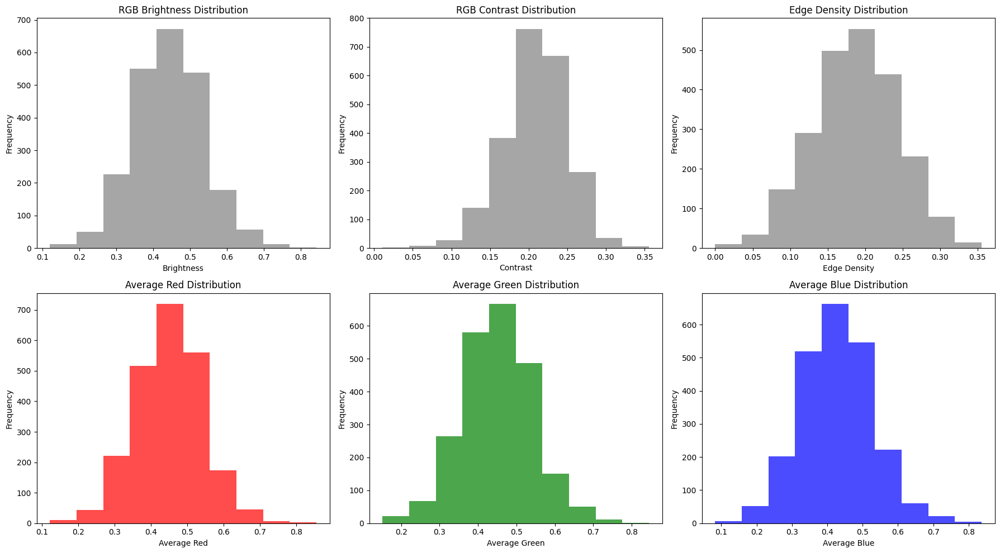

In [377]:
# Extract RGB channels from the 'average_color' tuples into separate columns for easier analysis
potential_kmeans_features['average_red'] = potential_kmeans_features['average_color'].apply(lambda x: x[0])
potential_kmeans_features['average_green'] = potential_kmeans_features['average_color'].apply(lambda x: x[1])
potential_kmeans_features['average_blue'] = potential_kmeans_features['average_color'].apply(lambda x: x[2])

# Plot histograms for RGB Brightness, RGB Contrast, Edge Density, and RGB Average Colors
fig, axes = plt.subplots(2, 3, figsize=(18, 10))  # Adjusted to 2 rows, 3 columns

# RGB Brightness
axes[0, 0].hist(potential_kmeans_features['rbg_brightness'], bins=10, color='grey', alpha=0.7)
axes[0, 0].set_title('RGB Brightness Distribution')
axes[0, 0].set_xlabel('Brightness')
axes[0, 0].set_ylabel('Frequency')

# RGB Contrast
axes[0, 1].hist(potential_kmeans_features['rbg_contrast'], bins=10, color='grey', alpha=0.7)
axes[0, 1].set_title('RGB Contrast Distribution')
axes[0, 1].set_xlabel('Contrast')
axes[0, 1].set_ylabel('Frequency')

# Edge Density
axes[0, 2].hist(potential_kmeans_features['edge_density'], bins=10, color='grey', alpha=0.7)
axes[0, 2].set_title('Edge Density Distribution')
axes[0, 2].set_xlabel('Edge Density')
axes[0, 2].set_ylabel('Frequency')

# Average Red
axes[1, 0].hist(potential_kmeans_features['average_red'], bins=10, color='red', alpha=0.7)
axes[1, 0].set_title('Average Red Distribution')
axes[1, 0].set_xlabel('Average Red')
axes[1, 0].set_ylabel('Frequency')

# Average Green
axes[1, 1].hist(potential_kmeans_features['average_green'], bins=10, color='green', alpha=0.7)
axes[1, 1].set_title('Average Green Distribution')
axes[1, 1].set_xlabel('Average Green')
axes[1, 1].set_ylabel('Frequency')

# Average Blue
axes[1, 2].hist(potential_kmeans_features['average_blue'], bins=10, color='blue', alpha=0.7)
axes[1, 2].set_title('Average Blue Distribution')
axes[1, 2].set_xlabel('Average Blue')
axes[1, 2].set_ylabel('Frequency')

plt.tight_layout()
plt.show()


- Interpretation of the above plots : 
    - `RGB Brightness Distribution`: 
        - **Range**: Values range approximately from 0.1 to 0.8.
        - **Peak**: The most common brightness values cluster around 0.4 to 0.5.
        - **Interpretation**: This suggests a moderate level of brightness across most images. Images are neither predominantly dark nor overly bright, which may indicate a controlled or consistent lighting environment during image capture.
    - `RGB Contrast Distribution`: 
        - **Range**: Values stretch from around 0.0 to 0.35.
        - **Peak**: The distribution is left-skewed, peaking around 0.2.
        - **Interpretation**: Most images have a medium level of contrast, with fewer images exhibiting very high contrast. This could imply that most images are not excessively sharp or flat, which might be useful for distinguishing images with specific visual emphasis.
    - `Edge Density Distribution`: 
        - **Range**: Values lie between 0.0 and 0.35.
        - **Peak**: The histogram shows a peak around 0.15 to 0.2.
        - **Interpretation**: A moderate edge density is common among the images, indicating a balance between detailed and smooth images. This feature might help identify images with high detail or textural elements.
    - `Average Red Distribution`: 
        - **Range**: Spans roughly from 0.1 to 0.8.
        - **Peak**: Central concentration around 0.4 to 0.5.
        - **Interpretation** : The histogram suggests that the majority of the images contain a moderate level of red values. The significant presence around 0.4 to 0.5 indicates a balanced red tone across most images, neither too low nor too high. This could imply that images are not overly dominated by red hues, which are typically associated with warmer, more vibrant scenes. The distribution allows for differentiation between images with subtle and more pronounced red elements.
    - Regarding `R G B` nalsyis (second row histograms): 
        - **Balanced RGB Presence**: All three color channels show peaks in the mid-range, indicating a well-distributed color balance across the dataset. This suggests that the images are neither overly saturated in one color nor lacking in variety. Such a distribution is conducive to clustering based on subtle differences and similarities in color composition rather than extreme color characteristics.

        - **Cluster Differentiation**: The similarity in distribution shapes and ranges implies that for clustering, distinguishing images based solely on high saturation or dominance of one color may be less effective. Instead, clustering algorithms can leverage the nuanced differences in how these colors combine within images. Clusters might then differentiate images by the subtle interplay of colors, such as images where blue is slightly more dominant might cluster separately from those where green or red are slightly more pronounced, reflecting different scenes or objects.

        - **Feature Engineering**: `Given the balanced color distributions, feature engineering could involve creating new features that capture the interaction between these colors`, such as ratios of colors or combined color histograms. These could help in distinguishing between images that are visually similar but differ in specific color details.
    - important Note : Additionally, we have the feature `Color Histogram`
        - Comparative Utility: Mean RGB values provide a simplified overview of color balance, useful for basic image comparisons, while color histograms offer a detailed distribution of colors, essential for advanced image processing tasks that require precise color pattern analysis.
- Until here, we have a basic understanding of the distributions for the float datatyeps potential features of k-means.
- Now, we will move on the arrays datatype potentail features of k means meaning `lbp` and `color histogram`.

In [378]:
# Calculate and display basic statistics for the first LBP histogram
def display_basic_statistics(hist):
    print("Mean:", np.mean(hist))
    print("Median:", np.median(hist))
    print("Standard Deviation:", np.std(hist))
    print("Variance:", np.var(hist))

display_basic_statistics(potential_kmeans_features['lbp'].iloc[0])

Mean: 0.04
Median: 0.0
Standard Deviation: 0.053513722852329484
Variance: 0.0028637185335159306


- Based on the provided statistical metrics for the Local Binary Patterns (LBP) feature, here are three insights and their implications for clustering:

    - 1. **Low Mean and Median**: The mean and median of LBP values are very low (mean = 0.04, median = 0.0), indicating that the majority of data points have low LBP values. This could imply a heavy concentration of similar texture features within the majority of the dataset, which can be beneficial in clustering algorithms by clearly distinguishing between common and outlier texture patterns.

    - 2. **Low Variance**: The low variance (0.002863718533515930) suggests that the data points do not vary widely from the mean. In a clustering context, this can facilitate the formation of tight, homogenous clusters where the majority of data points share similar texture attributes, making it easier to identify distinct groups based on texture.

    - 3. **Positive Skewness Indicated by Mean and Median Difference**: The fact that the mean is higher than the median suggests a positive skew, indicating the presence of some high LBP values. This can be useful in clustering as it indicates potential subgroups within the data that have higher texture variation, which can be targeted for separate cluster identification.

- Overall, these statistics suggest that LBP could be a useful feature for clustering images or other data based on texture, as it provides a measure that distinguishes between different texture patterns effectively. This feature can help in identifying clusters of similar textures and differentiating them from less common textures within a dataset.


### Bivariate Overall  Analysis
- Now, we will move on Bivariate analysis of the potential features. 

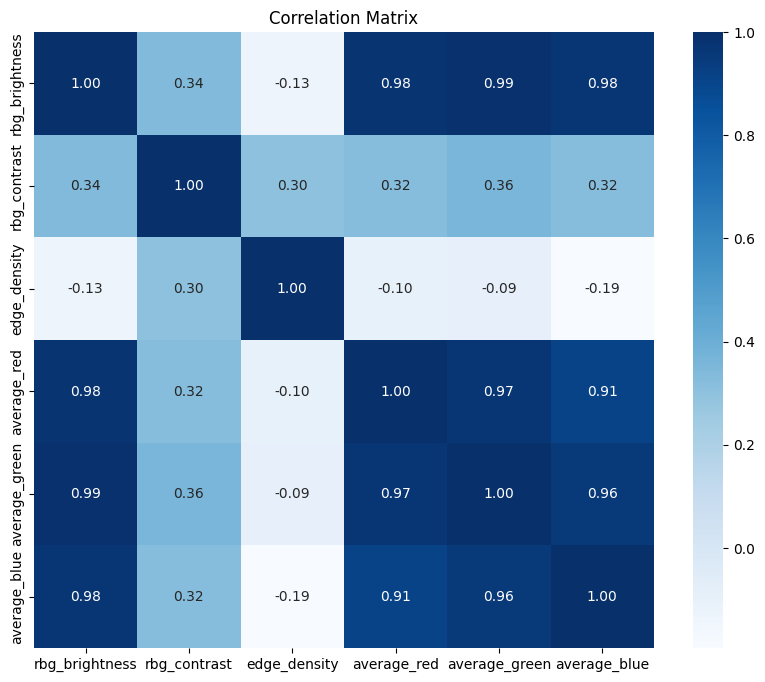

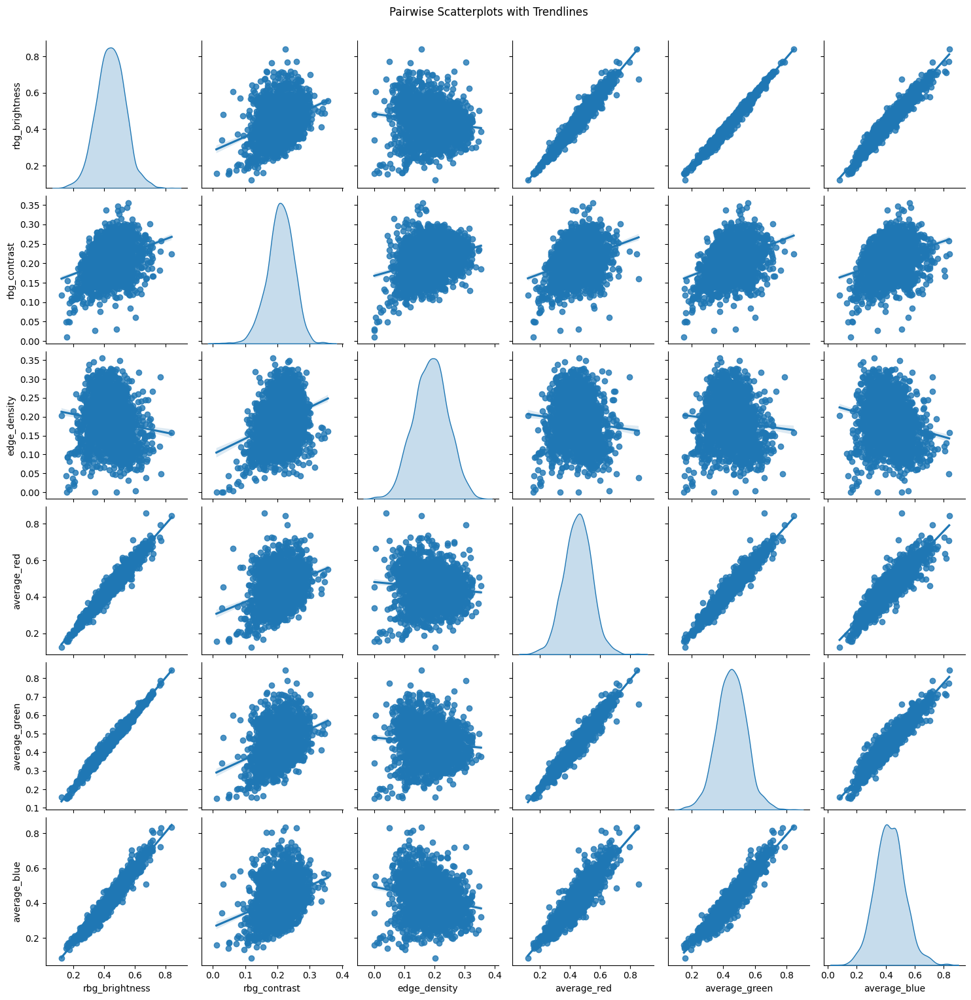

In [379]:
# Assuming your DataFrame 'potential_kmeans_features' is already defined and loaded
df = potential_kmeans_features

# Exclude non-numerical columns for correlation and statistics
numerical_df = df.select_dtypes(include=['number'])

# Correlation Analysis
if not numerical_df.empty:
    # Correlation matrix for all numerical columns
    correlation_matrix = numerical_df.corr()

    # Visualize correlation as a heatmap using a single-color gradient
    plt.figure(figsize=(10, 8))
    sns.heatmap(correlation_matrix, annot=True, cmap='Blues', fmt=".2f")
    plt.title('Correlation Matrix')
    plt.show()
else:
    print("No numerical columns available for correlation analysis.")

# Scatterplots with Trendlines
if not numerical_df.empty:
    sns.pairplot(numerical_df, kind='reg', diag_kind='kde')
    plt.suptitle('Pairwise Scatterplots with Trendlines', y=1.02)
    plt.show()
else:
    print("No numerical columns available for scatterplots.")


- Regarding thje correlation plot (the first one) we can observe that thee is extremely **high** correlations among the features `R` `B` `G` and `Brightness` so during cluster training we will try firstly to train with only brightness and not the reamingin ones. 
- Generally, we want to train k means with features with low correlation.
- In other words, 
- High Correlation Among Color Features:
    - Features like average_red, average_green, and average_blue are highly correlated, suggesting redundancy. If you're building a machine learning model, you may need dimensionality reduction or feature selection.
- On the other hand, 
- Edge-related Features:
    - Features like `edge_density` and `rbg_contrast` seem less correlated with color features, implying they might add unique information.
- Due to correlation matrix rbg and brightness wins brightness.

- `Reagrding pairwise scatterplots` : 
    - **Strong Correlations Between RGB Channels**: The average intensity values for red, green, and blue channels exhibit strong linear relationships, as evident from the diagonal patterns in their scatterplots. This suggests that images tend to maintain balanced proportions of these colors.

    - `**Weak Relationships Among Other Features**: Features like brightness, contrast, and edge density show no clear linear correlations with each other or with the RGB averages. This indicates that these features are capturing distinct aspects of the images, making them valuable for clustering.`

    - **Feature Distributions**: The histograms along the diagonal provide insights into the distribution of each feature, with brightness, contrast, and edge density showing more variation, while the RGB averages have narrower and more uniform distributions.

### Per-City Distributions in the New Features

To further explore the relationships within our dataset, we will analyze specific feature distributions across cities. This analysis is motivated by the hypothesis that cities often exhibit consistent architectural styles and urban layouts, which could manifest as patterns in image characteristics. Investigating this dimension in detail may help uncover patterns hidden in the aggregated data, including potential collinearities and feature relationships. Although this approach stems from a human perspective, its effectiveness will ultimately be validated through practical application.

### Objectives of the Analysis

1. **Understanding Feature Distributions**: By analyzing features such as edge density, brightness, and contrast at the city level, we aim to uncover patterns or variations specific to each city. 
2. **Informing Clustering**: Identifying features that significantly differ by city can provide valuable insights for feature selection, which is crucial for effective clustering. Features that vary significantly across cities are more likely to contribute to distinct, meaningful clusters.
3. **Additional Exploration**: This analysis serves as an exploratory step to delve deeper into the data before moving to clustering. It is not essential but could reveal insights that enhance clustering outcomes.

### Analytical Approach

#### 1. **Using ANOVA**
We will employ Analysis of Variance (ANOVA) to test whether the means of selected features (edge density, brightness, contrast) differ significantly across cities. ANOVA is appropriate for this analysis because:
- The dependent variables (features) are continuous numerical values.
- The independent variable (city ID) is categorical.
- The objective is to identify statistically significant differences in feature means among groups (cities).

By detecting such differences, ANOVA helps identify features that could differentiate clusters based on geographic or city-specific characteristics.

#### 2. **Visualizing with Boxplots**
Complementing the statistical analysis, we will use boxplots to visualize the distributions of features across cities. Boxplots effectively display:
- The range and spread of values.
- Median and quartiles for each city.
- Outliers that may influence clustering or feature selection.

Boxplots provide a clear visual comparison of variability and distribution patterns, helping to validate and interpret the results from ANOVA.

### Rationale and Benefits

- **Feature Selection**: ANOVA highlights features with significant variability across cities, which are valuable for clustering as they enhance the separation of clusters.
- **Data Insights**: Understanding feature distributions at the city level can reveal nuanced patterns that aggregated data might obscure.
- **Clustering Preparation**: Knowing which features differentiate images per city can guide the selection of feature combinations, improving clustering results.

### Implementation
1. **Data Preparation**:
   - Group the dataset by city ID.
   - Extract features such as edge density, brightness, and contrast.
2. **ANOVA Testing**:
   - Apply ANOVA to compare feature means across cities.
   - Identify statistically significant features.
3. **Boxplot Visualization**:
   - Create boxplots for each feature to visually inspect distributions and variability.

This approach provides a structured framework for exploring potential patterns in the data and evaluating the utility of selected features for clustering. By combining statistical rigor with visual analysis, we aim to derive actionable insights for enhancing clustering and feature selection.


             rbg_brightness                                                    \
                      count      mean       std       min       25%       50%   
city_id                                                                         
Bangkok               100.0  0.436577  0.077627  0.245707  0.385052  0.438030   
Barcelona             100.0  0.432000  0.082544  0.271476  0.377570  0.427935   
Boston                100.0  0.437693  0.107608  0.189550  0.374578  0.432497   
Brussels              100.0  0.445492  0.094504  0.170717  0.387735  0.443583   
BuenosAires           100.0  0.400350  0.067105  0.199741  0.363404  0.404920   
Chicago               100.0  0.428898  0.096412  0.173607  0.372169  0.431110   
Lisbon                100.0  0.470580  0.112676  0.155498  0.385950  0.474335   
London                100.0  0.404029  0.087291  0.152618  0.344295  0.408612   
LosAngeles            100.0  0.484471  0.081420  0.260695  0.441957  0.489830   
Madrid                100.0 

/var/folders/br/6xtfsjcd1pld8d58t5wwkmcr0000gn/T/ipykernel_35178/3507639765.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='city_id', y=feature, palette='viridis')
/var/folders/br/6xtfsjcd1pld8d58t5wwkmcr0000gn/T/ipykernel_35178/3507639765.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='city_id', y=feature, palette='viridis')
/var/folders/br/6xtfsjcd1pld8d58t5wwkmcr0000gn/T/ipykernel_35178/3507639765.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='city_id', y=feature, palette='viridis')


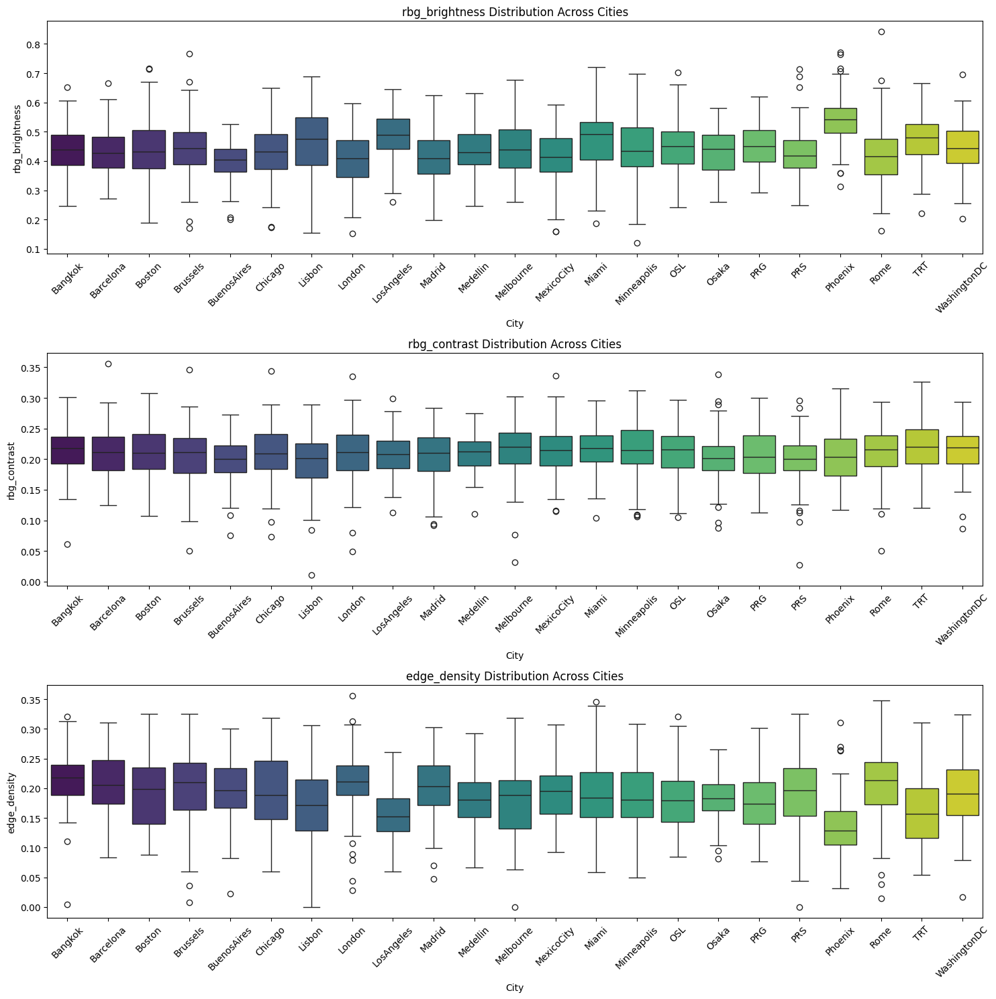


ANOVA Test Results (F-statistic, P-value):
rbg_brightness: F-stat = 11.45, P-value = 0.0000
rbg_contrast: F-stat = 2.01, P-value = 0.0035
edge_density: F-stat = 11.14, P-value = 0.0000


In [380]:
# Statistical Summary
feature_stats = df.groupby('city_id')[['rbg_brightness', 'rbg_contrast', 'edge_density']].describe()
print(feature_stats)

# Boxplots for Features by City
features = ['rbg_brightness', 'rbg_contrast', 'edge_density']
plt.figure(figsize=(15, 5 * len(features)))

for i, feature in enumerate(features):
    plt.subplot(len(features), 1, i + 1)
    sns.boxplot(data=df, x='city_id', y=feature, palette='viridis')
    plt.title(f'{feature} Distribution Across Cities')
    plt.xlabel('City')
    plt.ylabel(feature)
    plt.xticks(rotation=45)  # Rotate x-axis labels for better readability

plt.tight_layout()
plt.show()

# Perform ANOVA Test for Each Feature
anova_results = {}
for feature in features:
    groups = [df[df['city_id'] == city][feature] for city in df['city_id'].unique()]
    f_stat, p_value = f_oneway(*groups)
    anova_results[feature] = (f_stat, p_value)

print("\nANOVA Test Results (F-statistic, P-value):")
for feature, (f_stat, p_value) in anova_results.items():
    print(f"{feature}: F-stat = {f_stat:.2f}, P-value = {p_value:.4f}")

- Feature-Specific Interpretation
- **RGB Brightness**
    - **F-Statistic**: 11.45  
    - **P-Value**: 0.0000  
    - The extremely low p-value (𝑝 < 0.05) `signifies a highly significant difference in brightness across cities`. This suggests that the levels of brightness in urban imagery vary considerably between cities, potentially due to differences in lighting, development patterns, or environmental factors.

- **RGB Contrast**
    - **F-Statistic**: 2.01  
    - **P-Value**: 0.0035  
    - Though the p-value (𝑝 < 0.05) `confirms a statistically significant difference in contrast across cities`, the relatively low F-statistic indicates that the degree of variation in contrast is less pronounced compared to brightness and edge density. This could imply that while contrast provides some differentiation, it is less distinct in capturing city-specific characteristics.

-  **Edge Density**
    - **F-Statistic**: 11.14  
    - **P-Value**: 0.0000  
    - Similar to brightness, the extremely low p-value (𝑝 < 0.05) `indicates a strong and statistically significant difference in edge density across cities`. This underscores that structural or textural elements, as represented by edge density, are highly city-specific and can effectively distinguish urban patterns or characteristics unique to each city.

-  Summary
- **Brightness** and **Edge Density** show strongly significant and pronounced differences, highlighting their importance in capturing city-specific features.
- **Contrast**, while significant, exhibits less variability, suggesting it may play a secondary role in distinguishing cities.

-  Aanalyze Boxplots Figures 
    - RGB `Brightness`: Significant variation across cities is observed, with distinct differences in brightness distributions, as highlighted by varying median and range values.
    - RGB `Contrast`: While statistically significant, contrast shows less pronounced differences between cities compared to brightness, with overlapping distributions in some case- s.
    - `Edge Density`: Clear city-specific variation in structural/textural features, as evidenced by distinct ranges and medians, making it a strong differentiator.
- In order to delve into the data more, we will apply posthoc tukey to find which specific groups differ from each other. 
    - THint : this way may be useful in interpreating clusters next, too.  


Tukey's Test Results for rbg_brightness:
      Multiple Comparison of Means - Tukey HSD, FWER=0.05      
   group1      group2    meandiff p-adj   lower   upper  reject
---------------------------------------------------------------
    Bangkok    Barcelona  -0.0046    1.0 -0.0502  0.0411  False
    Bangkok       Boston   0.0011    1.0 -0.0445  0.0468  False
    Bangkok     Brussels   0.0089    1.0 -0.0367  0.0546  False
    Bangkok  BuenosAires  -0.0362 0.3649 -0.0819  0.0094  False
    Bangkok      Chicago  -0.0077    1.0 -0.0533   0.038  False
    Bangkok       Lisbon    0.034  0.499 -0.0117  0.0797  False
    Bangkok       London  -0.0325 0.5914 -0.0782  0.0131  False
    Bangkok   LosAngeles   0.0479 0.0273  0.0022  0.0936   True
    Bangkok       Madrid   -0.024 0.9625 -0.0697  0.0217  False
    Bangkok     Medellin  -0.0048    1.0 -0.0505  0.0408  False
    Bangkok    Melbourne   0.0045    1.0 -0.0412  0.0501  False
    Bangkok   MexicoCity  -0.0258 0.9224 -0.0715  0.0198  Fals

<Figure size 1000x500 with 0 Axes>

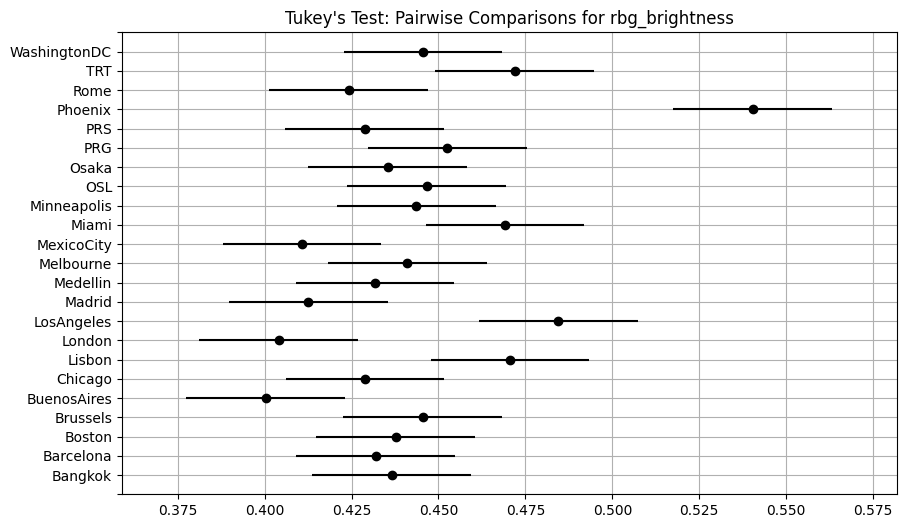


Tukey's Test Results for rbg_contrast:
     Multiple Comparison of Means - Tukey HSD, FWER=0.05      
   group1      group2    meandiff p-adj   lower  upper  reject
--------------------------------------------------------------
    Bangkok    Barcelona  -0.0046    1.0 -0.0254 0.0163  False
    Bangkok       Boston  -0.0059    1.0 -0.0267  0.015  False
    Bangkok     Brussels  -0.0103 0.9822 -0.0311 0.0106  False
    Bangkok  BuenosAires  -0.0147 0.6103 -0.0356 0.0061  False
    Bangkok      Chicago  -0.0045    1.0 -0.0254 0.0163  False
    Bangkok       Lisbon  -0.0175 0.2556 -0.0384 0.0033  False
    Bangkok       London  -0.0069 0.9999 -0.0277  0.014  False
    Bangkok   LosAngeles  -0.0081 0.9993 -0.0289 0.0128  False
    Bangkok       Madrid  -0.0094 0.9936 -0.0303 0.0114  False
    Bangkok     Medellin  -0.0047    1.0 -0.0255 0.0162  False
    Bangkok    Melbourne   0.0008    1.0   -0.02 0.0217  False
    Bangkok   MexicoCity  -0.0018    1.0 -0.0226 0.0191  False
    Bangkok    

<Figure size 1000x500 with 0 Axes>

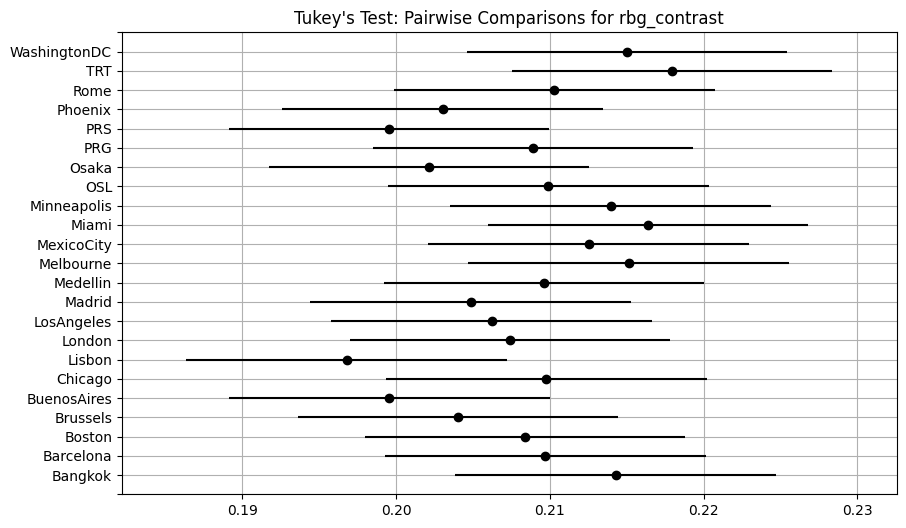


Tukey's Test Results for edge_density:
      Multiple Comparison of Means - Tukey HSD, FWER=0.05      
   group1      group2    meandiff p-adj   lower   upper  reject
---------------------------------------------------------------
    Bangkok    Barcelona  -0.0087    1.0 -0.0363   0.019  False
    Bangkok       Boston  -0.0222 0.3428 -0.0499  0.0055  False
    Bangkok     Brussels   -0.013   0.99 -0.0406  0.0147  False
    Bangkok  BuenosAires  -0.0186 0.7048 -0.0463  0.0091  False
    Bangkok      Chicago   -0.023 0.2738 -0.0507  0.0047  False
    Bangkok       Lisbon  -0.0428    0.0 -0.0705 -0.0151   True
    Bangkok       London  -0.0062    1.0 -0.0339  0.0214  False
    Bangkok   LosAngeles  -0.0583    0.0  -0.086 -0.0307   True
    Bangkok       Madrid  -0.0113 0.9984  -0.039  0.0164  False
    Bangkok     Medellin  -0.0321 0.0057 -0.0598 -0.0045   True
    Bangkok    Melbourne  -0.0389 0.0001 -0.0666 -0.0113   True
    Bangkok   MexicoCity  -0.0216 0.3959 -0.0493   0.006  False


<Figure size 1000x500 with 0 Axes>

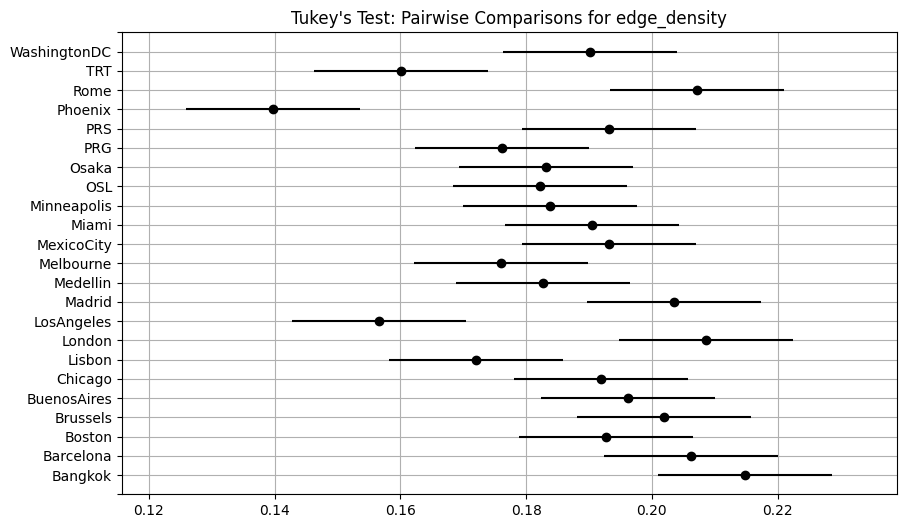

In [381]:
# Function to perform Tukey's test for each feature
def perform_posthoc_tukey(df, feature, group_column='city_id'):
    """
    Perform Tukey's post-hoc test for a given feature.

    Parameters:
        df (pd.DataFrame): The input DataFrame.
        feature (str): The feature column to analyze.
        group_column (str): The column with categorical groups (default is 'city_id').

    Returns:
        Results of Tukey's HSD test as a DataFrame.
    """
    # Extract data for Tukey's test
    data = df[[group_column, feature]].dropna()
    
    # Perform Tukey's HSD test
    tukey_result = pairwise_tukeyhsd(endog=data[feature], groups=data[group_column], alpha=0.05)
    
    # Print summary of results
    print(f"\nTukey's Test Results for {feature}:")
    print(tukey_result.summary())
    
    # Convert results to DataFrame for further analysis
    tukey_df = pd.DataFrame(data=tukey_result._results_table.data[1:], columns=tukey_result._results_table.data[0])
    
    # Plot the results
    plt.figure(figsize=(10, 5))
    tukey_result.plot_simultaneous(comparison_name=None)
    plt.title(f"Tukey's Test: Pairwise Comparisons for {feature}")
    plt.grid()
    plt.show()
    
    return tukey_df

# Apply Tukey's test for each feature
features = ['rbg_brightness', 'rbg_contrast', 'edge_density']
posthoc_results = {}

for feature in features:
    posthoc_results[feature] = perform_posthoc_tukey(df, feature)

Cities/Groups Comparison:

- How to intrpreat the above plots : 
     - Each city or group is plotted along the y-axis.
    - The x-axis represents the mean brightness (likely averaged across samples within each city).
- Confidence Intervals:
    - Horizontal lines with dots indicate the estimated mean brightness for each city along with a confidence interval (usually 95%).
    - Longer confidence intervals suggest higher variability in brightness estimates.
- Significant Differences:
    - The confidence intervals that do not overlap with others likely indicate statistically significant differences in brightness for example.
- Before completing the EDA section we will plot boxplots of R B G  per city, too.

/var/folders/br/6xtfsjcd1pld8d58t5wwkmcr0000gn/T/ipykernel_35178/2819379682.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='city_id', y=feature, palette='viridis')
/var/folders/br/6xtfsjcd1pld8d58t5wwkmcr0000gn/T/ipykernel_35178/2819379682.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='city_id', y=feature, palette='viridis')
/var/folders/br/6xtfsjcd1pld8d58t5wwkmcr0000gn/T/ipykernel_35178/2819379682.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='city_id', y=feature, palette='viridis')


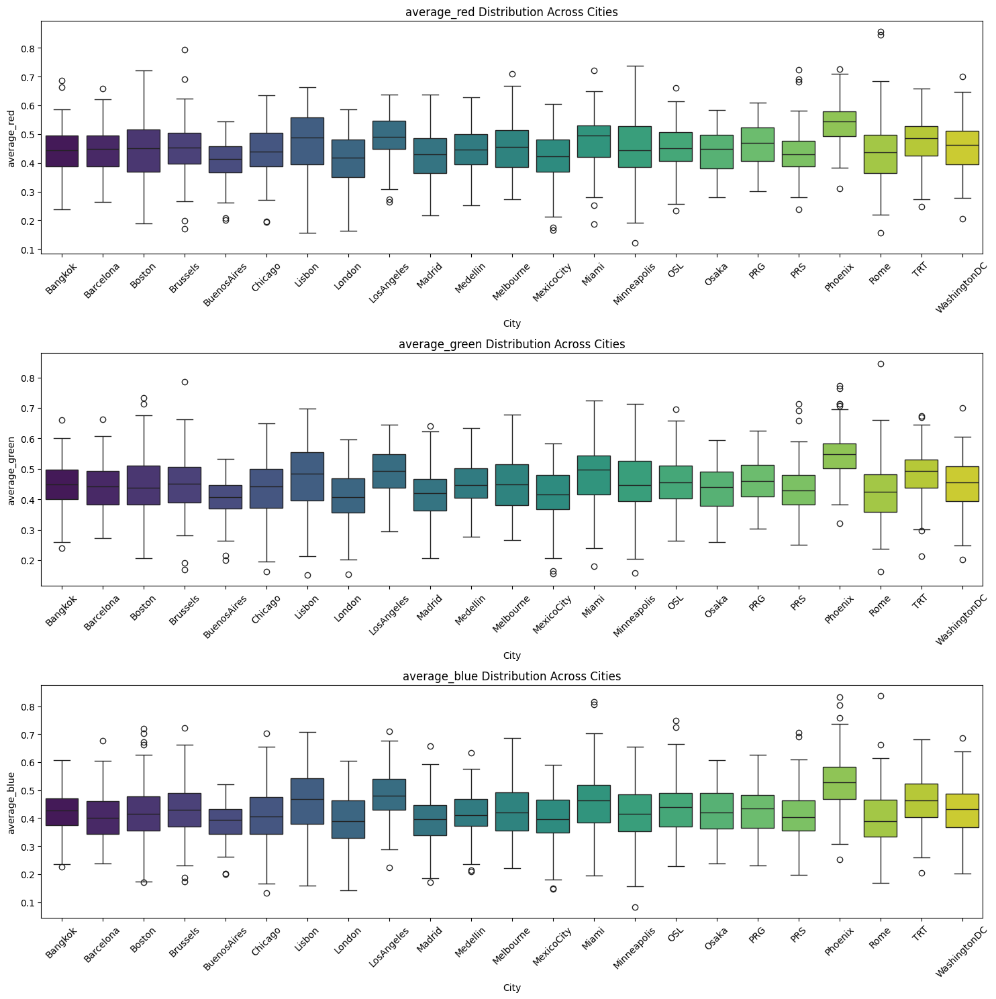

In [382]:
# Boxplots for Features by City
features = ['average_red', 'average_green', 'average_blue']
plt.figure(figsize=(15, 5 * len(features)))

for i, feature in enumerate(features):
    plt.subplot(len(features), 1, i + 1)
    sns.boxplot(data=df, x='city_id', y=feature, palette='viridis')
    plt.title(f'{feature} Distribution Across Cities')
    plt.xlabel('City')
    plt.ylabel(feature)
    plt.xticks(rotation=45)  # Rotate x-axis labels for better readability

plt.tight_layout()
plt.show()


- Feature Variability Across Cities: The boxplots for average_red, average_green, and average_blue clearly show variability in the color distributions across cities. Some cities exhibit tighter distributions (e.g., Lisbon and Chicago for average_red), while others, such as Rome and WashingtonDC, display broader distributions and more outliers, suggesting greater diversity in image features for these cities.

- Potential Outliers: Several cities have noticeable outliers in all three features (e.g., Miami and Rome for average_green and average_blue). These outliers may represent images with significantly different color characteristics, potentially indicating unique lighting conditions, scenes, or data anomalies in these locations. Identifying these outliers can help refine the analysis and improve clustering performance.

### In short, Insights steming from EDA 
- Based on Univariate analysis of rach of the colors overall, `Given the balanced color distributions, feature engineering could involve creating new features that capture the interaction between these colors`
- Based on correlation analysis, `Brightness` has extremely high correlation with `R` `B` `G`  so in feature selection we will try to train the model from some of them e.g. only `Brightness`.
- Based on pairwise scatterplots with tedencies, tehre are weak relationships among other features : Features like `brightness`, `contrast`, and `edge density` show **no clear linear correlations** with each other **or with the RGB averages**. This indicates that these features are capturing **distinct aspects** of the images, making them valuable for clustering.`
- Furthermore, based on Anova per city analysis, it seems that `edges`, `bightness` and `contrast` are statistically important.
- So, at first glance the feeatures   `edges`, `bightness` and `contrast` seem to be a good combiantion of features to train k-means.

### `3` Unsupervised Learning
### K means

- `Cluster Analysis Strategy Overview`

- 1. **`Feature Selection Approach`**
   - **Initial Inclusion**: Begin with a comprehensive set of features to establish a baseline for clustering performance. We will start via applying the most promising features stemming from EDA analysis. 
      - `Important Note`: From EDA we have already the **prior knowledge** that some features are "promising" combination e.g. `edge density`, `brightness` and `contrast`. 
      - However, we will emprically try combination with R B G and all columns, too. Of course, the combiantion are many so wewilll emprically check some of them and we will try to select the most prommisng cluster choice. 
   - **Iterative Refinement**: Systematically add features to evaluate the impact on cluster quality. This empirical approach aims to identify the most influential features for effective clustering.

- 2. **`Determining the Number of Clusters (`k`)`**
   - **Important Note**: We will begin the clustering process with k=3 clusters for our K-means algorithm because we aim to identify at least three distinct groups within the dataset. Starting with three clusters allows us to explore a broader range of potential groupings, which can help in more accurately discerning the primary clusters we wish to investigate in depth. This approach helps capture nuanced variations between the image groups, enhancing our understanding of the underlying patterns.
   - **Silhouette Score Utilization**: The optimal number of clusters will be determined in one of the factors being the silhouette score, which assesses how similar an object is to its cluster compared to other clusters. 
         - A higher score indicates well-separated and cohesive clusters, suggesting an optimal clustering structure. 
      - Besides shilouetter, we will use our observations of images close to centroids of clusters in order to see if there are patters taht the humans can group in categories making obvious sense. 
   - More specifically, **Cluster Center Visualization**
      - **Distance Calculation**: For the selected `k`, compute the distance from all dataset images to each cluster centroid.
      - **Image Display**: Identify and display the three images closest to each cluster's centroid to visually inspect the clusters' homogeneity and distinctiveness.
   - **Pattern Recognition and Validation**
      - **Intuitive Inspection**: Examine the images near the cluster centers to intuitively assess if there is a discernible pattern or similarity among the images within each cluster.
      - **Cluster Validation**: Clusters that exhibit clear and consistent patterns will be considered promising and selected for further detailed analysis.

- 3. **`Focused Analysis`**
   - **Selective Concentration**: Direct analysis efforts toward clusters that demonstrate clear and interpretable patterns, ensuring that these clusters are both statistically significant and practically meaningful for further exploration and decision-making.

- This refined approach not only utilizes statistical methods (in our case Silhouette) to determine the optimal cluster count but also integrates a pragmatic methodology for feature selection and the interpretation of clustering results. By focusing on clusters that exhibit significant and meaningful patterns, we ensure that our analysis is robust, actionable, and aligned with strategic objectives.
- Important Note : `Clustering is an art as subjectivity plays role`. 
- For starting this methodology described we wrtoe the folowing functions : 
   - `cluster_and_visualize`, `plot_top_images_all_clusters`, `run_final_kmeans_and_extend`.
      - `run_final_kmeans_and_extend` only for the most "promising" model we will additionally apss as argument **save_model** = 1. 
         - In order to predict at part 3 the Athens's provided Images.  
   - For each of the aforementioned functiones there is related description regarding teh funstionalyty in comment at the beggining of it. 


In [383]:
def cluster_and_visualize(df, selected_features, k_range=(3, 7), random_state=42):
    """
    Perform K-Means clustering and visualize the results with PCA.
    
    Parameters:
        df (pd.DataFrame): The input DataFrame containing the features.
        selected_features (list): List of feature column names to use for clustering.
        k_range (tuple): Range of k values for K-Means (default is (3, 7)).
        random_state (int): Random state for reproducibility (default is 42).
    """
    # Step 1: Combine Selected Features
    feature_matrix = df[selected_features].values

    # Step 2: Normalize Features
    scaler = StandardScaler()
    normalized_features = scaler.fit_transform(feature_matrix)

    # Step 3: Apply K-Means and Visualize Results
    silhouette_scores = []
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))  # Create a grid for 4 plots (2 rows, 2 per line)

    for i, k in enumerate(range(k_range[0], k_range[1])):  # Iterate over k values
        # Apply K-Means
        kmeans = KMeans(n_clusters=k, random_state=random_state, n_init=10)
        clusters = kmeans.fit_predict(normalized_features)
        
        # Compute Silhouette Score
        score = silhouette_score(normalized_features, clusters)
        silhouette_scores.append(score)
        
        # Use PCA only for visualization
        pca_2d = PCA(n_components=2)
        features_2d = pca_2d.fit_transform(normalized_features)
        
        # Plot in the corresponding subplot
        ax = axes[i // 2, i % 2]  # Determine subplot location (2 rows, 2 columns)
        ax.scatter(features_2d[:, 0], features_2d[:, 1], c=clusters, cmap='viridis', s=50, alpha=0.7)
        ax.set_title(f'K-Means Clusters (k={k})')
        ax.set_xlabel('PCA Component 1')
        ax.set_ylabel('PCA Component 2')

    plt.tight_layout()
    plt.show()

    # Step 4: Plot Silhouette Scores for All k
    plt.figure(figsize=(8, 5))
    plt.plot(range(k_range[0], k_range[1]), silhouette_scores, marker='o')
    plt.title('Silhouette Scores for Different k')
    plt.xlabel('Number of Clusters (k)')
    plt.ylabel('Silhouette Score')
    plt.show()

In [384]:
def plot_top_images_all_clusters(df, file_path_column='file_path', cluster_column='cluster', distance_column='distance_to_center', save_path=None):
    """
    Plot the top 3 images with the smallest distance to the cluster center for all clusters in one figure.

    Parameters:
        df (pd.DataFrame): The input DataFrame containing the clustering results.
        file_path_column (str): The column name that contains file paths to the images.
        cluster_column (str): The column name that contains cluster labels.
        distance_column (str): The column name that contains distances to cluster centers.
        save_path (str): Optional. If provided, saves the figure to the specified path.
    """
    # Group the DataFrame by cluster
    grouped = df.groupby(cluster_column)
    num_clusters = df[cluster_column].nunique()  # Number of unique clusters

    # Create a figure for all clusters
    plt.figure(figsize=(15, 5 * num_clusters))  # Adjust height based on the number of clusters
    plt.suptitle("Top 3 Images for Each Cluster (Lowest Distance to Cluster Center)", fontsize=20, y=0.95)
    
    # Plot the top 3 images for each cluster
    for cluster_idx, (cluster, group) in enumerate(grouped):
        # Sort by distance_to_center and select the top 3 images with the lowest distance
        top_images = group.nsmallest(3, distance_column)
        
        for i, row in enumerate(top_images.itertuples()):
            # Read and plot the image
            plt.subplot(num_clusters, 3, cluster_idx * 3 + i + 1)  # Multiple rows, 3 columns
            img = mpimg.imread(getattr(row, file_path_column))
            plt.imshow(img)
            plt.title(f"Cluster {cluster} - Dist: {getattr(row, distance_column):.2f}")
            plt.axis('off')
    
    # Adjust layout for better spacing
    plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust for suptitle
    
    # Save the figure if a path is provided
    if save_path:
        plt.savefig(save_path, bbox_inches='tight')
    
    # Show the plot
    plt.show()

In [385]:
def run_final_kmeans_and_extend(df, selected_features, final_k, random_state=42, save_model=0, save_path='final_kmeans_model.joblib'):
    print(f"save_model value: {save_model}")  # Debug print to check the value of save_model

    # Step 1: Combine Selected Features
    feature_matrix = df[selected_features].values

    # Step 2: Normalize Features
    scaler = StandardScaler()
    normalized_features = scaler.fit_transform(feature_matrix)

    # Step 3: Apply Final K-Means
    kmeans = KMeans(n_clusters=final_k, random_state=random_state, n_init=10)
    clusters = kmeans.fit_predict(normalized_features)

    # Step 4: Calculate Distances to Cluster Centers
    distances = np.linalg.norm(normalized_features - kmeans.cluster_centers_[clusters], axis=1)

    # Step 5: Extend the DataFrame
    df['cluster'] = clusters
    df['distance_to_center'] = distances

    # Step 6: Optionally save the model
    try:
        # Save scaler if saving the model
        if save_model == 1:
            dump(scaler, save_path.replace('model.joblib', 'scaler.joblib'))
    except Exception as e:
        print(f"Error saving model: {e}")

    return df


### Trial Features : ['rbg_brightness', 'rbg_contrast', 'edge_density']
- We will start the emprical evaluation based on a "promissing" combination stemming from EDA analysis
- manually we will call for k = 4 for plotting the images and the for k = 3 based on shilouette scores and we will compare the images intuitively if tehy make sense. 

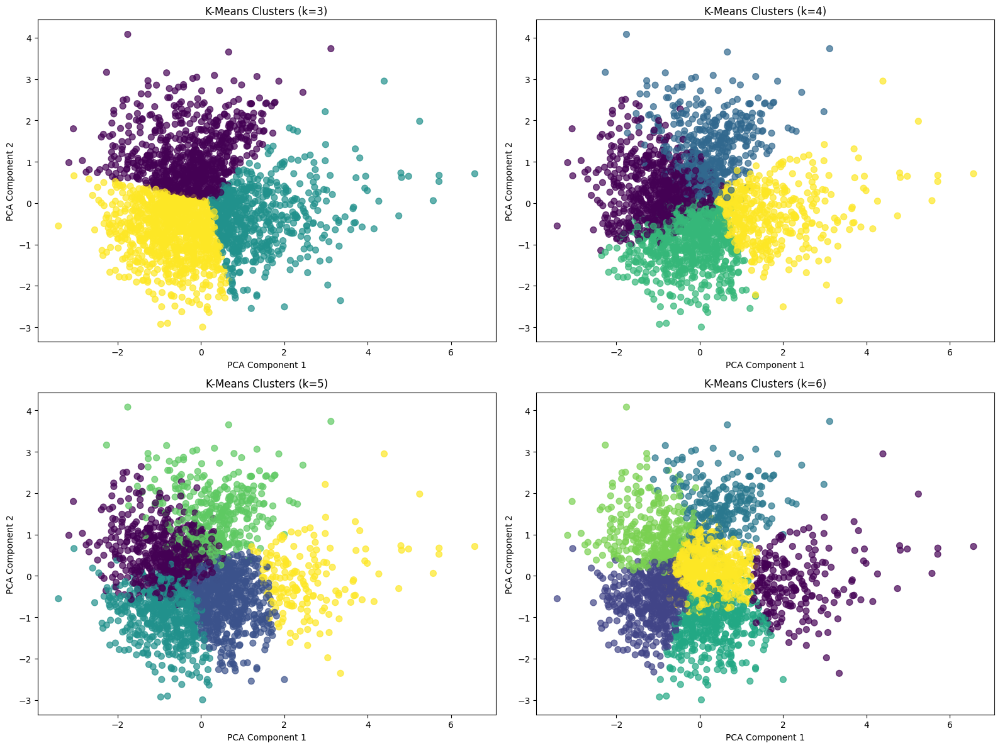

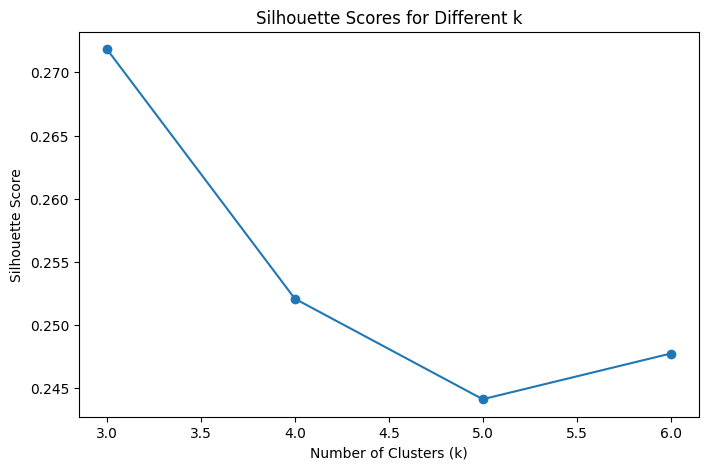

save_model value: 0


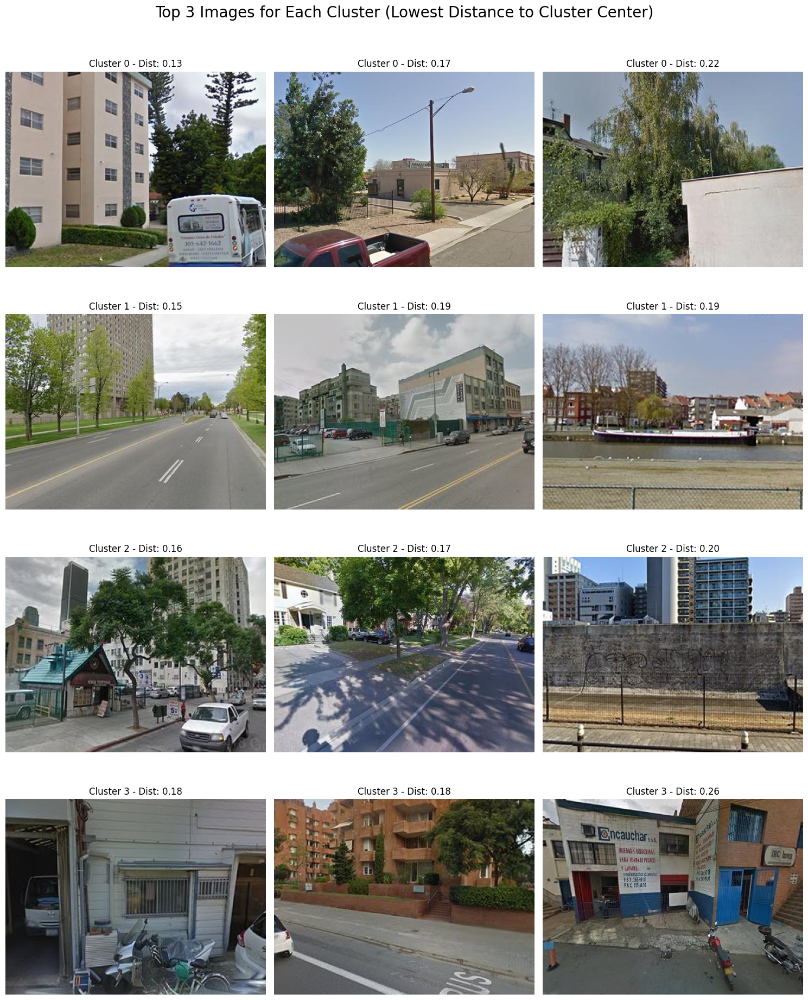

In [386]:
df_approach_1 = potential_kmeans_features.copy()
# Example: Using 'rbg_brightness', 'rbg_contrast', and 'edge_density'
selected_features = ['rbg_brightness', 'rbg_contrast', 'edge_density']
cluster_and_visualize(df_approach_1, selected_features)


# Define the features to use for clustering
selected_features = ['rbg_brightness', 'rbg_contrast', 'edge_density']
# Manually select the final k (e.g., k=4)
final_k = 4 # Manualky adapt it. Make trial for interpretations based on images ploteed for 3 closest from the cluster 
# Run the final K-Means and extend the DataFrame
df_approach_1 = run_final_kmeans_and_extend(df_approach_1, selected_features, final_k) 
# View the updated DataFrame
df_approach_1.head()



# Call the function to plot the top 3 images per cluster
plot_top_images_all_clusters(df_approach_1, file_path_column='file_path', cluster_column='cluster', distance_column='distance_to_center')

- Cluster 0 : seem to represent green palces and houses. 
- Cluster 1 : seem to represent cloudy weather 
- Cluster 2 : it is not clear what it reprents . . . [Here Difficulty for Human Grouping Label]
    - `IDEA FOR FUTURE WORK` : Maybe for this cluster as future work we could apply further clutsring only for this cluster
- Cluster 4 : seem to focus on buildings.

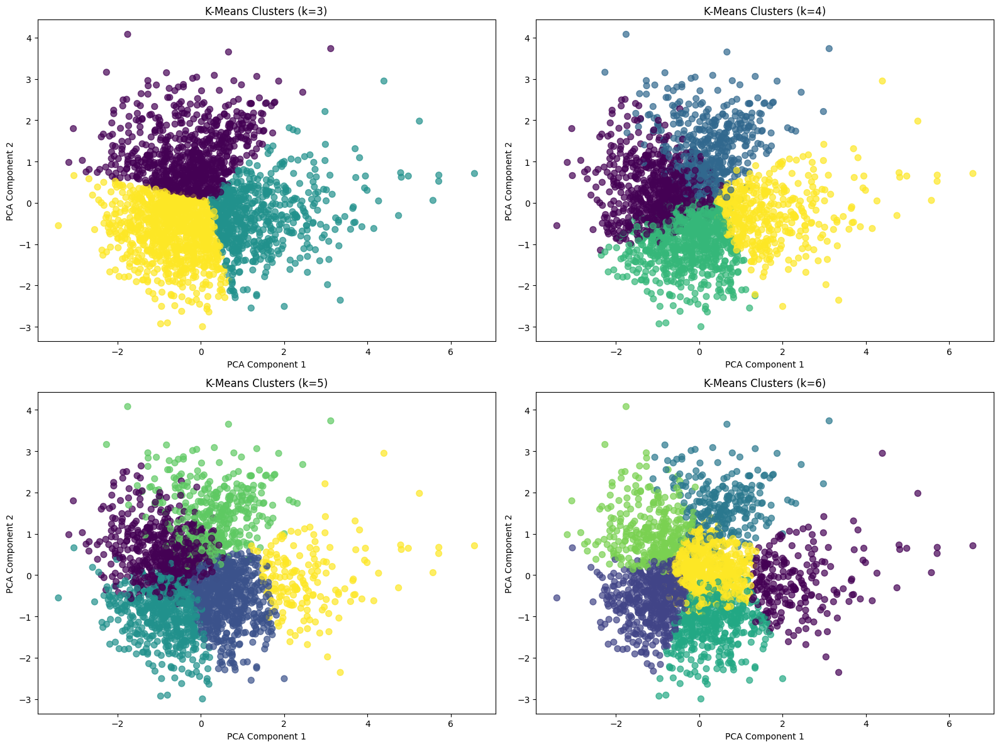

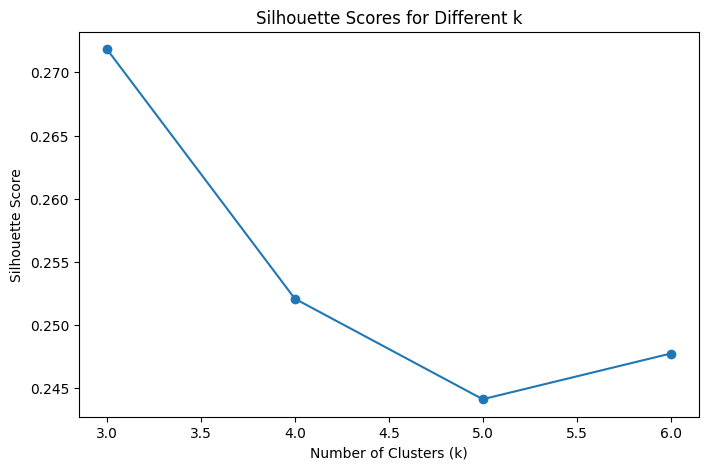

save_model value: 1


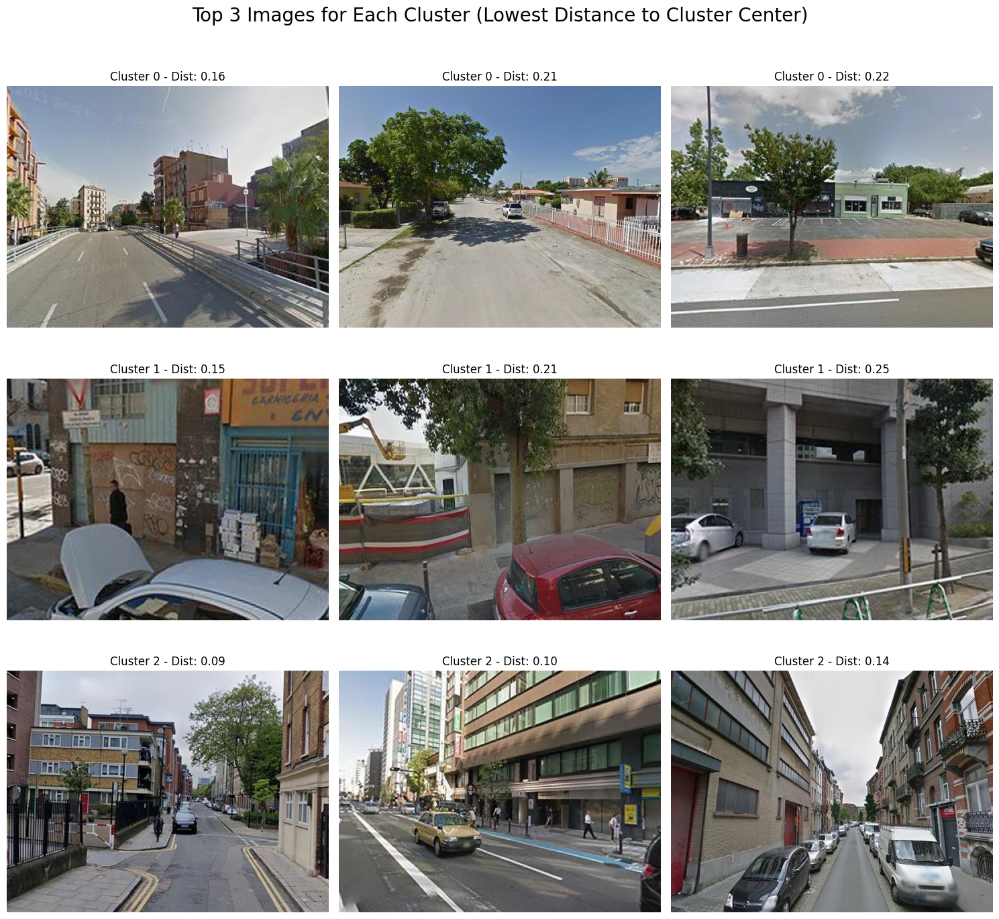

In [387]:
df_approach_1_b = potential_kmeans_features.copy()
# Example: Using 'rbg_brightness', 'rbg_contrast', and 'edge_density'
selected_features = ['rbg_brightness', 'rbg_contrast', 'edge_density']
cluster_and_visualize(df_approach_1, selected_features)


# Define the features to use for clustering
selected_features = ['rbg_brightness', 'rbg_contrast', 'edge_density']
# Manually select the final k (e.g., k=4)
final_k = 3 # Manualky adapt it. Make trial for interpretations based on images ploteed for 3 closest from the cluster 
# Run the final K-Means and extend the DataFrame
df_approach_1_b = run_final_kmeans_and_extend(df_approach_1_b, selected_features, final_k, save_model=1) # pass 1
# View the updated DataFrame
df_approach_1_b.head()



# Call the function to plot the top 3 images per cluster
plot_top_images_all_clusters(df_approach_1_b, file_path_column='file_path', cluster_column='cluster', distance_column='distance_to_center')

- Note : Because this cluster (will be proves as the most "promissing" we will make a more detailed analysis.
- Clusters and Visual Inspection : 
    - Cluster 0 (Top Row): Images seem to be of open spaces, such as streets or suburban areas, with:
Moderate brightness. Low to moderate contrast (smooth, uniform scenes). Low edge density (fewer objects or details, mostly open areas like roads and sidewalks).
    - Cluster 1 (Middle Row): These images have more urban details, such as buildings, walls with graffiti, and cars: Higher contrast (clear differences between objects). Higher edge density (more objects, such as cars, walls, and urban details). Moderate brightness, suggesting shaded or partially lit areas.
    - Cluster 2 (Bottom Row): These images depict densely packed urban settings with narrow streets or city blocks: High brightness and contrast (well-lit environments with defined edges). High edge density (complex scenes with many vertical and horizontal lines like buildings, cars, and roads).

-------


| **Cluster** | **Characteristics**                                                                                                      | **Feature Interpretation**                                                                                               | **Light Characteristics**                          | **Example Scenes**                       |
|-------------|--------------------------------------------------------------------------------------------------------------------------|-------------------------------------------------------------------------------------------------------------------------|---------------------------------------------------|------------------------------------------|
| **Cluster 0** | - Open spaces with wide streets or suburban areas.                                                                     | - **Low Edge Density**: Minimal details, fewer objects.<br>- **Moderate Brightness**: Smooth lighting.<br>- **Low Contrast**: Uniform textures. | - **Natural Light**: Evenly distributed, soft lighting.<br>- Shadows minimal or absent.  | - Empty streets, suburban neighborhoods. |
| **Cluster 1** | - Urban environments with moderate complexity, featuring buildings, cars, and graffiti.                                | - **Moderate Edge Density**: More details (cars, objects).<br>- **Moderate Brightness**: Partially lit or shaded areas.<br>- **Moderate to High Contrast**: Clear differences between objects. | - **Mixed Light**: Combination of natural and artificial light.<br>- Shadows are present but not overwhelming. | - Urban streets with parked cars or walls. |
| **Cluster 2** | - Densely packed urban cityscapes, featuring narrow streets, high-rise buildings, and busy roads.                      | - **High Edge Density**: Dense details (many vertical/horizontal lines).<br>- **High Brightness**: Well-lit environments.<br>- **High Contrast**: Sharp differences between objects and surroundings. | - **Bright Natural or Artificial Light**: Strong lighting that creates sharp contrasts.<br>- Shadows often prominent. | - Bustling city blocks, dense urban settings. |


-----


- In short, we have: 

| **Cluster**   | **Characteristics**                     | **Feature Interpretation**         | **Light Characteristics**       | **Example Scenes**             |
|---------------|-----------------------------------------|-------------------------------------|----------------------------------|---------------------------------|
| **Cluster 0** | Open, wide streets, minimal details.    | Low edges, low brightness, smooth. | Natural, soft, minimal shadows. | S `open spaces`, `sunny light`. |
| **Cluster 1** | Urban, moderate complexity, some details. | Moderate edges, shaded, contrasts. | Mixed, natural/artificial, shadows present. | Streets, cars, `urban walls`.    |
| **Cluster 2** | Dense, busy city, narrow streets.       | High edges, bright, sharp contrast. | Bright, strong light, shadows.  | `City blocks` |




### Cluster Labels based on AI assistant 

- **Cluster 0**: "`Open Suburban Areas`" (Based on ChatGPT Prompt)  
- **Cluster 1**: "`Urban Moderate Complexity`" (Based on ChatGPT Prompt)  
- **Cluster 2**: "`Dense Urban Cityscapes`" (Based on ChatGPT Prompt)  

### Human Commnets 
- We agree with ChtGPT assistant but we would like to add that the images related to lightenees and darkness too
    - The fisrt imagies in cluster 0 are sunny in comparion to the images in cluster 2 
- We will move on increasing the features via adding average colors of R B G despite the coleniarity we are curios emprically to check the behavioyr of k means both for more features and coleniarity , too.


In short out 3 sellected potentia lpromissing features offer : 1) Brightness: Indicates whether an image is generally bright or dark, 2) Contrast: Measures the difference in color and brightness that makes objects in an image distinguishable. 3) Canny edge: Using Canny edge detection to compute edge density offers a precise measure of the proportion of edges in an image, facilitating the clustering of images by their textural and structural complexity.


### Trial Features: ['rbg_brightness', 'rbg_contrast', 'edge_density', 'average_red', 'average_green', 'average_blue']

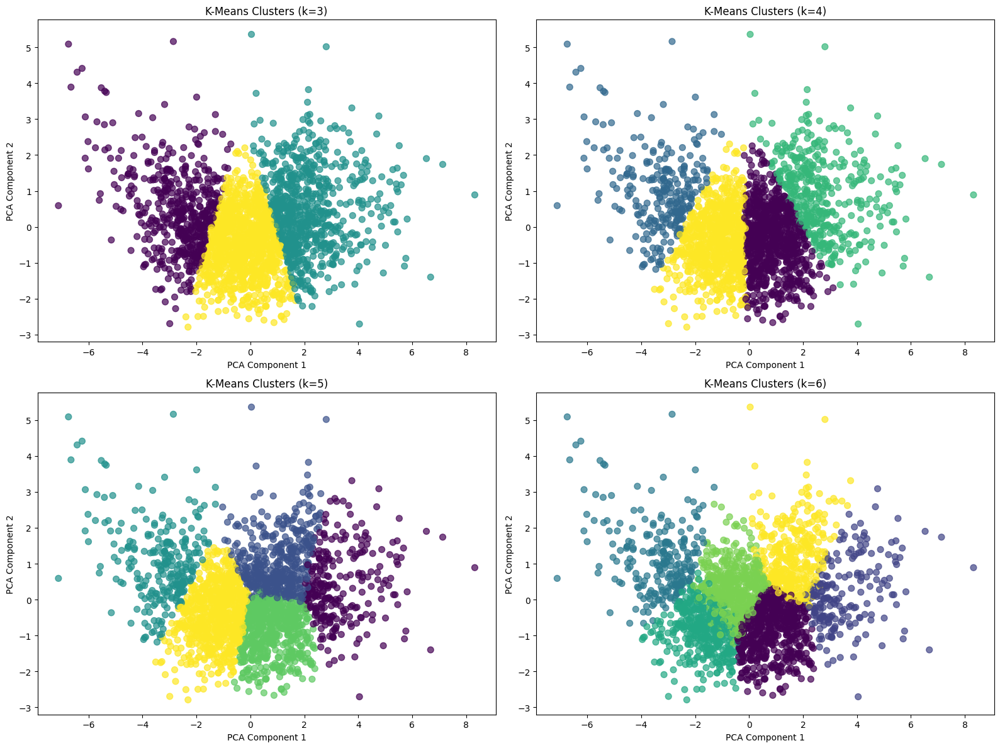

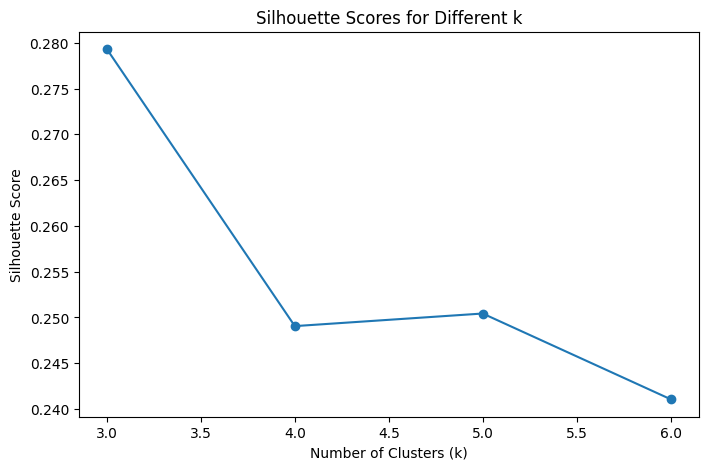

save_model value: 0


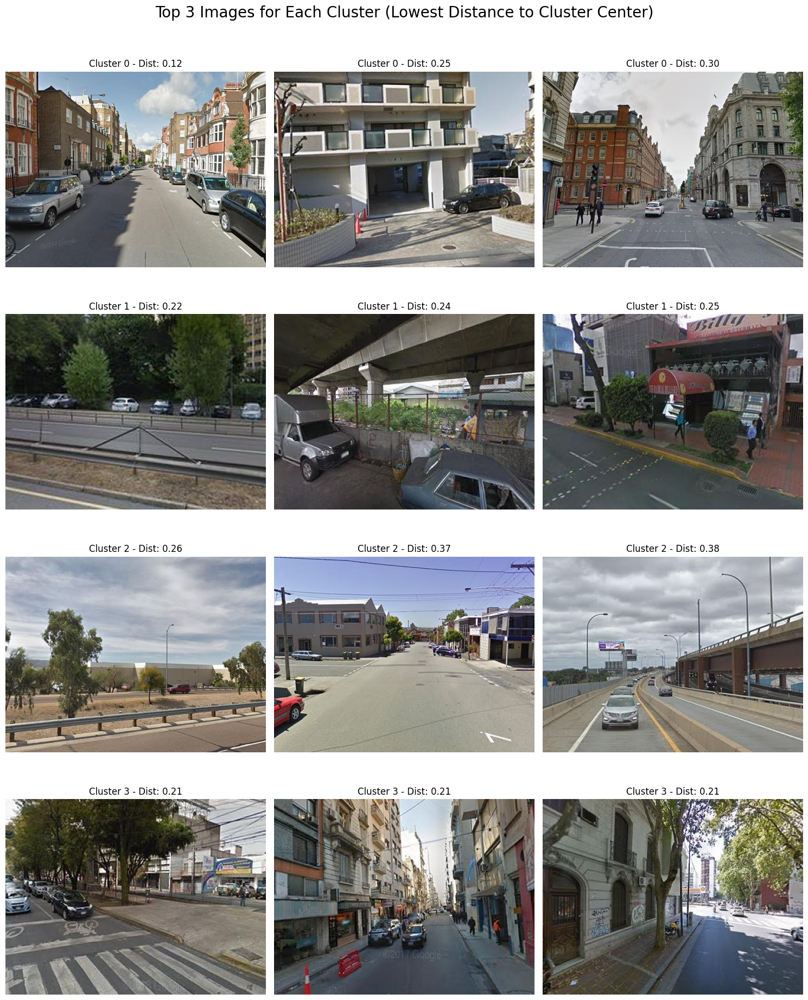

In [388]:
df_approach_2 = potential_kmeans_features.copy()
# Example: Using 'rbg_brightness', 'rbg_contrast', and 'edge_density'
selected_features = ['rbg_brightness', 'rbg_contrast', 'edge_density', 'average_red', 'average_green', 'average_blue']
cluster_and_visualize(df_approach_2, selected_features)


# Define the features to use for clustering
selected_features = ['rbg_brightness', 'rbg_contrast', 'edge_density', 'average_red', 'average_green', 'average_blue']
# Manually select the final k (e.g., k=4)
final_k = 4 # Manualky adapt it. Make trial for interpretations based on images ploteed for 3 closest from the cluster 
# Run the final K-Means and extend the DataFrame
df_approach_2 = run_final_kmeans_and_extend(df_approach_2, selected_features, final_k)
# View the updated DataFrame
df_approach_2.head()

# Call the function to plot the top 3 images per cluster
plot_top_images_all_clusters(df_approach_2, file_path_column='file_path', cluster_column='cluster', distance_column='distance_to_center')

- Shilouette score is a bit better than the previous combination of features. 
- However, intuitively, we find it more difficult to label the groups. 
- For the same combination of features, We will re-run for k = 3

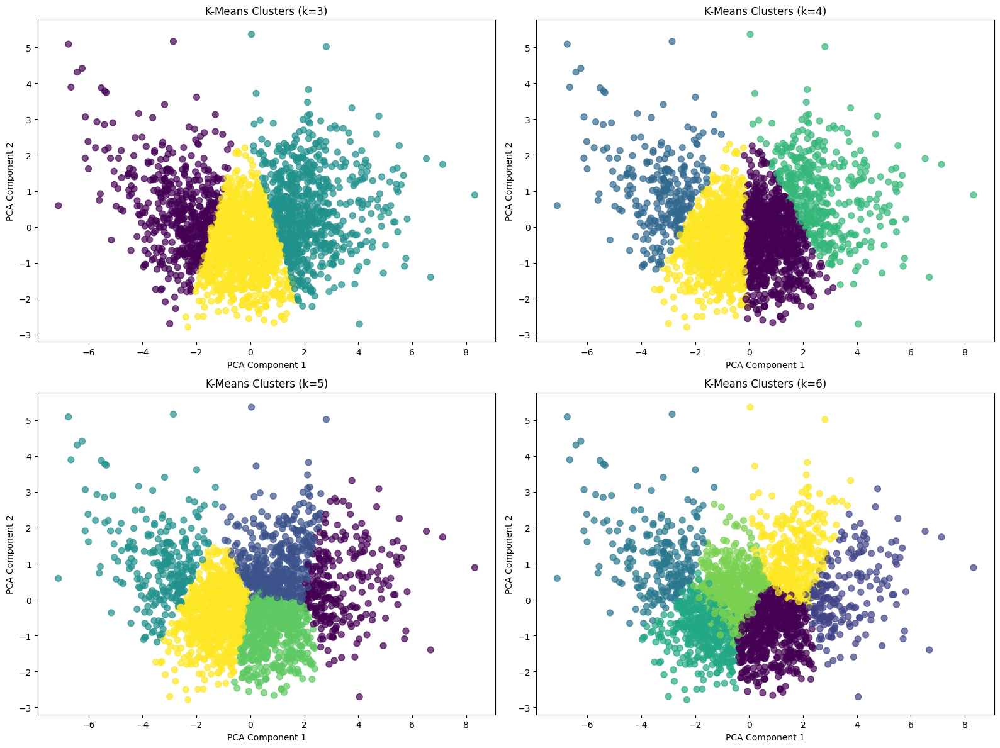

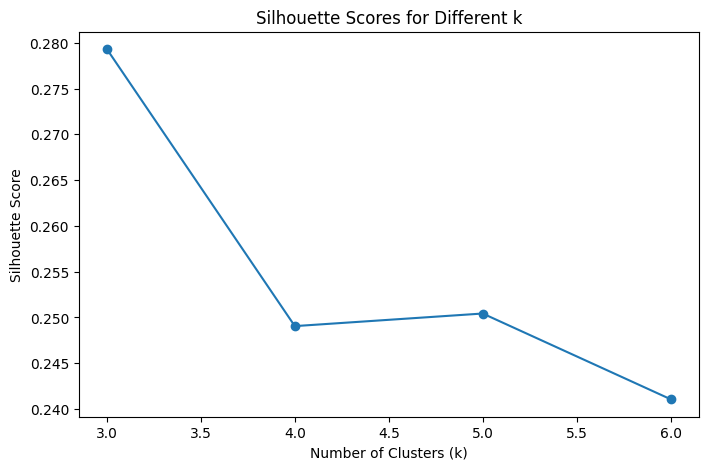

save_model value: 0


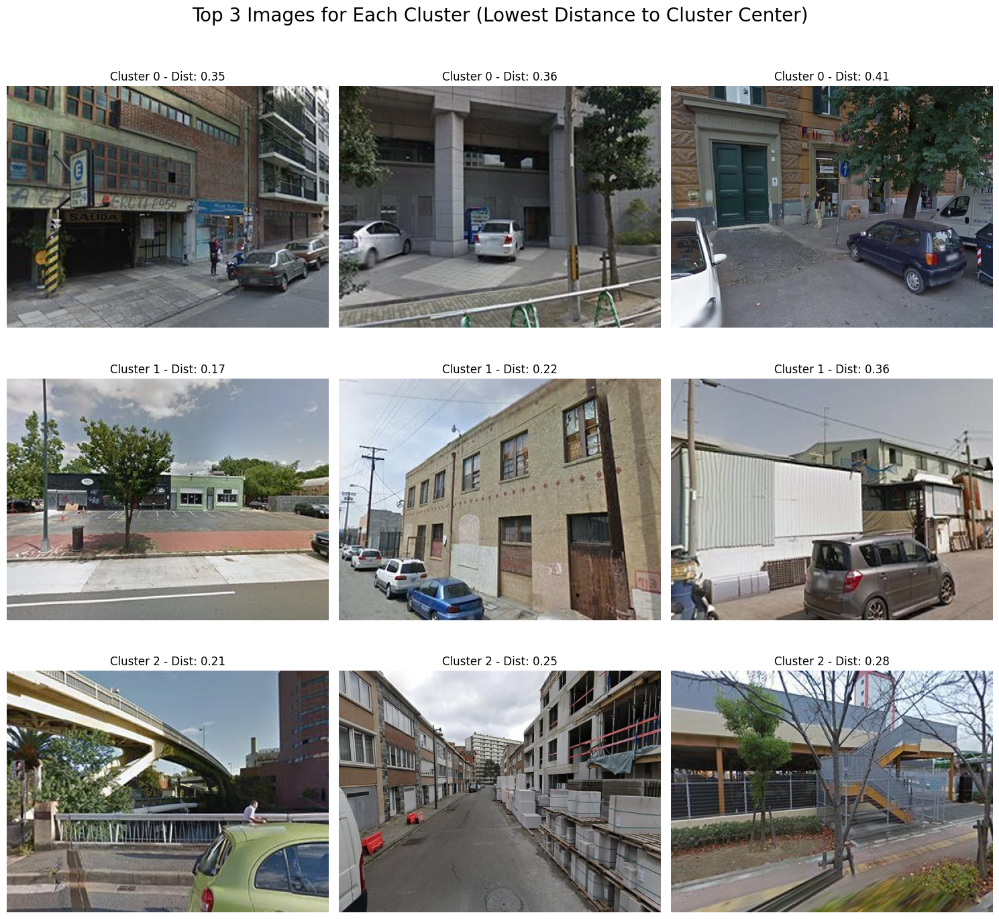

In [389]:
df_approach_2 = potential_kmeans_features.copy()
# Example: Using 'rbg_brightness', 'rbg_contrast', and 'edge_density'
selected_features = ['rbg_brightness', 'rbg_contrast', 'edge_density', 'average_red', 'average_green', 'average_blue']
cluster_and_visualize(df_approach_2, selected_features)


# Define the features to use for clustering
selected_features = ['rbg_brightness', 'rbg_contrast', 'edge_density', 'average_red', 'average_green', 'average_blue']
# Manually select the final k (e.g., k=4)
final_k = 3 # Manualky adapt it. Make trial for interpretations based on images ploteed for 3 closest from the cluster 
# Run the final K-Means and extend the DataFrame
df_approach_2 = run_final_kmeans_and_extend(df_approach_2, selected_features, final_k)
# View the updated DataFrame
df_approach_2.head()

# Call the function to plot the top 3 images per cluster
plot_top_images_all_clusters(df_approach_2, file_path_column='file_path', cluster_column='cluster', distance_column='distance_to_center')

- Again, intutively, we find it difficult to give a label.
- Until now, we observe that adding more features has not practically imrove the undertading of clustering labels. 

### Trial Features [All Features] && PCA
- We will make an attemp to run k-means with all features to check if again the labeling process will be difficult. 
- if it is, then we could say that maybe incresing the features don't help k-menas to cluster the similar images. 
- Because at this case, some features like ResNet feature extraction being a big array, we will apply PCA to reduce teh diamnsionality and then we will apply k-menas. 
    - PCA components adapted after some trials emprirically. 
    -   For future work, we could emrirically examine it more via calcualting teh variance of feature ir represents. 

/var/folders/br/6xtfsjcd1pld8d58t5wwkmcr0000gn/T/ipykernel_35178/1386137923.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['combined_features'] = df.apply(combine_features, axis=1)


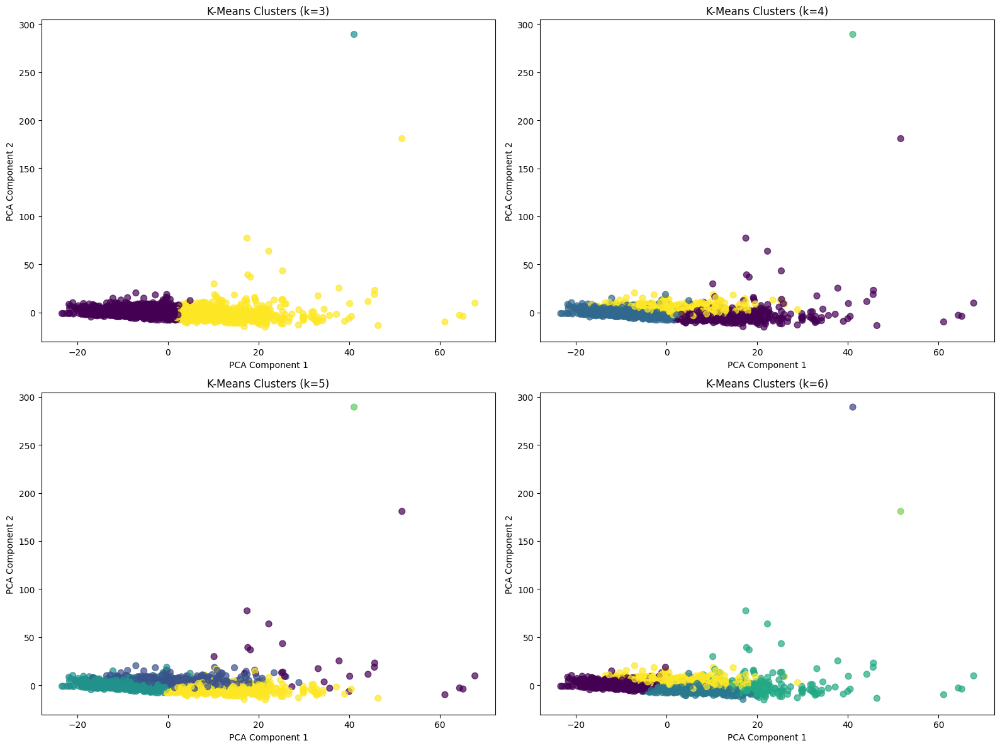

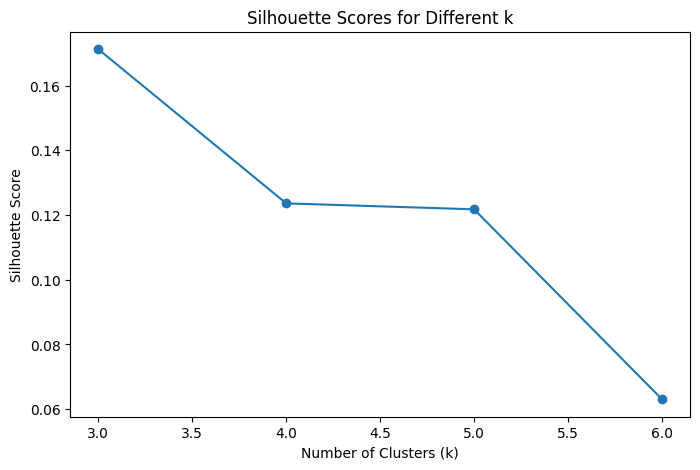

In [390]:
# Step 1: Load and Prepare Data
# Assuming `potential_kmeans_features` is your DataFrame
df = potential_kmeans_features

# Combine all features into a single array
def combine_features(row):
    return np.hstack([
        [
        row['rbg_brightness'], 
        row['rbg_contrast']],
        row['rbf_resnet_features'], # plakoutsonei 
        row['edge_density'],
        row['average_color'],
        row['rbg_color_histogram'],
        row['lbp'] # LBP is effective in distinguishing between different textures in images.
    ])

# Apply to each row
df['combined_features'] = df.apply(combine_features, axis=1)

# Create a feature matrix
feature_matrix = np.vstack(df['combined_features'].values)

# Step 2: Normalize Features
scaler = StandardScaler()
normalized_features = scaler.fit_transform(feature_matrix)

# Step 3: Dimensionality Reduction (Optional)
pca = PCA(n_components=50)  # Adjust number of components as needed
reduced_features = pca.fit_transform(normalized_features)

# Step 4: Apply K-Means and Generate PCA Figures for Each k
silhouette_scores = []
fig, axes = plt.subplots(2, 2, figsize=(16, 12))  # Create a grid for 4 plots (2 rows, 2 per line)

for i, k in enumerate(range(3, 7)):  # Test for k values from 3 to 6
    # Apply K-Means
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)  # Ensuring reproducibility
    clusters = kmeans.fit_predict(reduced_features)
    
    # Compute Silhouette Score
    score = silhouette_score(reduced_features, clusters)
    silhouette_scores.append(score)
    
    # Visualize clusters using PCA (2D for plotting)
    pca_2d = PCA(n_components=2)
    features_2d = pca_2d.fit_transform(reduced_features)
    
    # Plot in the corresponding subplot
    ax = axes[i // 2, i % 2]  # Determine subplot location (2 rows, 2 columns)
    ax.scatter(features_2d[:, 0], features_2d[:, 1], c=clusters, cmap='viridis', s=50, alpha=0.7)
    ax.set_title(f'K-Means Clusters (k={k})')
    ax.set_xlabel('PCA Component 1')
    ax.set_ylabel('PCA Component 2')

plt.tight_layout()
plt.show()

# Step 5: Plot Silhouette Scores for All k
plt.figure(figsize=(8, 5))
plt.plot(range(3, 7), silhouette_scores, marker='o')
plt.title('Silhouette Scores for Different k')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Silhouette Score')
plt.show()

- We can observe that increasing the number of features don't help k-means.
- for k = `3` and k = `4` the one instance of cluster is due to resnet. 
    - As we additionally tried to re-run without resnet feature and the one instance removed. 
- Shiloutter score independently of k is considerably more low compared to the other trials having considerable less features.

### Interpreat Cluster making th most seense 


In [227]:
selected_features = ['rbg_brightness', 'rbg_contrast', 'edge_density']
df_approach_1_b[['city_id', 'edge_density', 'rbg_brightness', 'rbg_contrast','cluster']]

,city_id,edge_density,rbg_brightness,rbg_contrast,cluster
0,Bangkok,0.197388,0.469921,0.236991,2
1,Bangkok,0.167847,0.251657,0.135098,1
2,Bangkok,0.172668,0.245707,0.139363,1
3,Bangkok,0.221924,0.330350,0.187078,1
4,Bangkok,0.217285,0.457227,0.196426,2
...,...,...,...,...,...
2295,WashingtonDC,0.159302,0.513371,0.274064,0
2296,WashingtonDC,0.173340,0.503616,0.258014,0
2297,WashingtonDC,0.176697,0.491840,0.179243,0
2298,WashingtonDC,0.185303,0.441641,0.225203,2


| **Feature**      | **Describes**                            | **High Value**                                      | **Low Value**                              |
|-------------------|------------------------------------------|----------------------------------------------------|--------------------------------------------|
| **Edge Density**  | Complexity and detail in the scene.      | Busy, detailed environments (e.g., cityscapes).    | Open, simple scenes (e.g., fields).        |
| **RBG Brightness**| Lighting and visibility of the scene.    | Bright, sunny, well-lit environments.              | Dimly lit or shaded areas.                 |
| **RBG Contrast**  | Object definition and sharpness.         | Clearly defined objects, striking visual scenes.   | Smooth, less-defined, or uniform regions.  |


- In order to interpreat our three clusters stemming from (k = 3) the combiantion of features `contrast`, `brightness` and `dense density` we will leverage a widely known method being teh usage of `Radar Chart`, also known as a `Spider Chart or Web Chart`. This type of chart is useful for displaying multivariate data in a way that makes it easy to see which variables have higher or lower values relative to each other across different categories or entities.

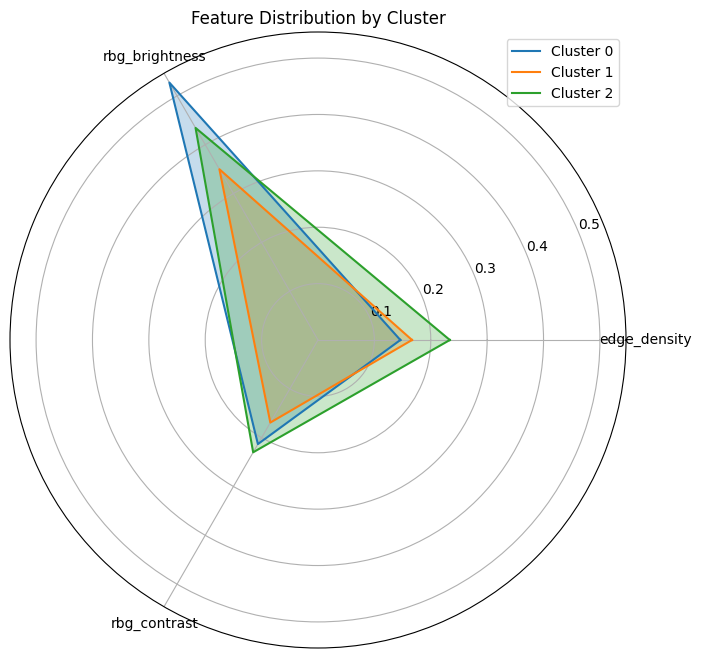

In [391]:
# Compute the mean values for each cluster
cluster_means = df_approach_1_b.groupby('cluster')[['edge_density', 'rbg_brightness', 'rbg_contrast']].mean()

# Radar chart setup
categories = cluster_means.columns
N = len(categories)
angles = np.linspace(0, 2 * np.pi, N, endpoint=False).tolist()
angles += angles[:1]  # Close the circle

# Create radar plots for each cluster
fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))

for cluster, row in cluster_means.iterrows():
    values = row.tolist()
    values += values[:1]  # Close the circle
    ax.plot(angles, values, label=f'Cluster {cluster}')
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(categories)
ax.set_title('Feature Distribution by Cluster')
ax.legend(loc='upper right')
plt.show()


- **Interpretation of Features per Cluster**: 
    - `Cluster 0 (Blue Polygon)`:
        - High rbg_brightness: Indicates that Cluster 0 represents the brightest images overall.
    Moderate rbg_contrast: Suggests well-defined objects or boundaries in the images.
        - Low edge_density: Indicates open or less complex scenes with fewer objects or details.
        - `Interpretation`: Cluster 0 likely represents well-lit, **open environments** such as wide streets or bright outdoor areas.
    - `Cluster 1 (Orange Polygon)`:
        - Moderate edge_density: Represents moderately detailed images with some objects or activity.
        - Lowest rbg_brightness: The dimmest images among all clusters, potentially representing shaded or poorly lit scenes.
        - Moderate rbg_contrast: Indicates smoother or less-defined objects.
        - `Interpretation`: Cluster 1 likely captures urban settings with moderate activity, some shading, or less prominent lighting.
    - `Cluster 2 (Green Polygon)`:
        - High edge_density: Indicates complex, detailed scenes with many objects or activity.
        - Moderate to High rbg_brightness: Suggests these images are well-lit but not as bright as Cluster 0.
        - Highest rbg_contrast: Implies sharp differences between light and dark areas, indicating highly defined objects or structures.
        - `Interpretation`: Cluster 2 likely represents dense, urban environments with busy streets or areas with high object density.
- **Note for overlapping** (PCA stemming fro the abobe plot in the promissing cluster got k =3 and Rsadar plot)
    - PCA Clustering Effectiveness: If PCA shows clear separation, it suggests that overall, the clusters are meaningful when considering the combined variance of all features. PCA reduces dimensionality by capturing the directions of maximum variance, and good separation in PCA suggests that, in terms of the largest variance components, the clusters are distinct.

    - Complex Feature Interactions: The overlaps seen in radar plots for individual features indicate that while the clusters differ significantly in the combined features space (as PCA shows), they may still share similarities in some specific features. This doesn't necessarily negate the value of the clusters but suggests that the clustering captures complex patterns that are not immediately apparent when looking at single features.    

In [392]:
# Group by cluster and collect city_id for each cluster
cluster_groups = df_approach_1_b.groupby('cluster')['city_id'].apply(list).reset_index()

# Print or analyze the clusters and their cities
cluster_groups

,cluster,city_id
0,0,"[Bangkok, Bangkok, Bangkok, Bangkok, Bangkok, ..."
1,1,"[Bangkok, Bangkok, Bangkok, Bangkok, Bangkok, ..."
2,2,"[Bangkok, Bangkok, Bangkok, Bangkok, Bangkok, ..."


### Answer which cities are more similar in terms of cluster assignments (their images are similarly distributed across the clusters)

- **Note** : We will follow both overall and per cluster analysis as each approach has each own merits. 
    - **Merit of Overall Analysis** :  Analyzing the overall similarities in cluster assignments across all clusters offers a comprehensive view that captures the complete spectrum of city distributions, enabling the identification of broad patterns and nuanced relationships between cities, which is crucial for strategic decision-making and thorough comparative analysis.
    - **Merit of per Cluster Aanlysis** : Analyzing similarities per cluster allows for detailed examination and understanding of city behaviors within individual clusters, providing precise insights that can guide targeted interventions, optimizations, and strategies specific to each cluster's unique characteristics.

- Firtsly, we will focus on the Overall Analysis for this purpose we have the following steps implemented: 
    - **Normalization and Conversion**: The code first normalizes the cluster count data for each city to reflect proportions rather than raw counts, then converts this normalized data into a PyTorch tensor. This tensor transformation facilitates efficient, vectorized computations that are ideal for the following machine learning operations.

    - **Cosine Similarity Computation**: Utilizing PyTorch, the code computes the cosine similarity between all pairs of cities based on their cluster distributions. This similarity matrix is then converted back into a DataFrame, making it easy to analyze which cities have similar profiles across clusters, essential for comparative analysis or strategic decision-making.

In [393]:
# Step 1: Calculate cluster distributions per city
city_cluster_distribution = df_approach_1_b.groupby(['city_id', 'cluster']).size().unstack(fill_value=0)

# Normalize to get the distribution (percentage)
city_cluster_distribution_normalized = city_cluster_distribution.div(city_cluster_distribution.sum(axis=1), axis=0)

# Step 2: Convert DataFrame to PyTorch tensor
distribution_tensor = torch.tensor(city_cluster_distribution_normalized.values, dtype=torch.float32)

# Step 3: Compute cosine similarity using PyTorch
cosine_sim_matrix = torch.nn.functional.cosine_similarity(
    distribution_tensor.unsqueeze(1),  # Add a dimension for pairwise comparison
    distribution_tensor.unsqueeze(0),  # Add a dimension for pairwise comparison
    dim=-1
)

# Convert the similarity matrix back to a DataFrame for easier analysis
similarity_df = pd.DataFrame(
    cosine_sim_matrix.numpy(),
    index=city_cluster_distribution_normalized.index,
    columns=city_cluster_distribution_normalized.index
)

# Display the similarity matrix
print(similarity_df)


city_id        Bangkok  Barcelona    Boston  Brussels  BuenosAires   Chicago  \
city_id                                                                        
Bangkok       1.000000   0.975786  0.944047  0.955405     0.866780  0.944671   
Barcelona     0.975786   1.000000  0.990789  0.996802     0.920255  0.993013   
Boston        0.944047   0.990789  1.000000  0.994743     0.895014  0.998873   
Brussels      0.955405   0.996802  0.994743  1.000000     0.933131  0.998106   
BuenosAires   0.866780   0.920255  0.895014  0.933131     1.000000  0.915160   
Chicago       0.944671   0.993013  0.998873  0.998106     0.915160  1.000000   
Lisbon        0.689760   0.808259  0.880550  0.836645     0.670910  0.867864   
London        0.952934   0.962017  0.923408  0.957135     0.972657  0.937523   
LosAngeles    0.499029   0.631889  0.730394  0.665290     0.454650  0.709411   
Madrid        0.916759   0.971337  0.960631  0.981825     0.983596  0.972736   
Medellin      0.906076   0.974549  0.994

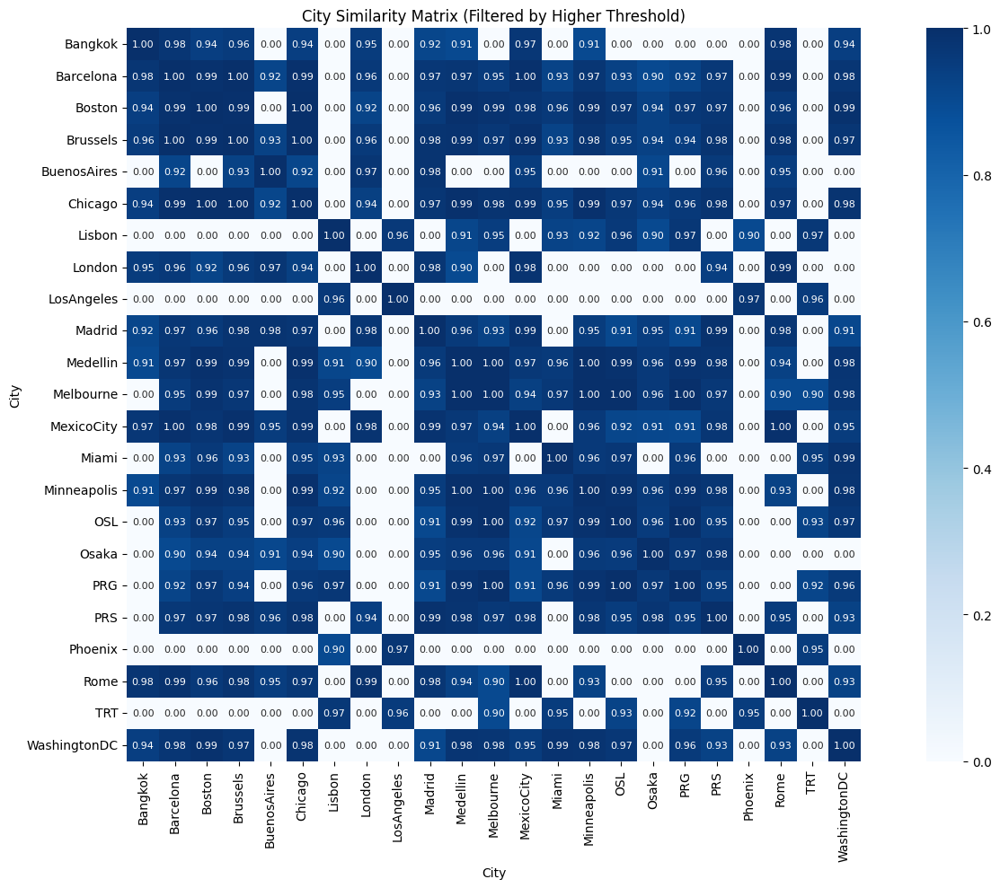

In [394]:
# Apply a higher threshold to reduce overlaps
threshold = 0.90  # Increase the threshold to focus on stronger similarities
filtered_similarity = similarity_df.where(similarity_df >= threshold, other=0)
# Plotting the correlation matrix
plt.figure(figsize=(15, 10))
sns.heatmap(filtered_similarity, annot=True, fmt=".2f", cmap="Blues", cbar=True, square=True, annot_kws={"size": 8})
plt.title("City Similarity Matrix (Filtered by Higher Threshold)")
plt.xlabel("City")
plt.ylabel("City")
plt.tight_layout()  # Adjust layout to fit everything nicely
plt.show()

- **Interpretation of Overall Similarity**:
    - High values (strong blue cells) between city pairs (e.g., Buenos Aires and Madrid having **0.98** being extremely close to 1) indicate that these cities have similarly distributed clusters, suggesting similar patterns or distributions in the data.
    - Lower values (light blue cells) between pairs (e.g., Los Angeles and many cities) suggest significant differences in cluster distributions.

In [395]:
df_approach_1_b[['city_id','cluster']]

,city_id,cluster
0,Bangkok,2
1,Bangkok,1
2,Bangkok,1
3,Bangkok,1
4,Bangkok,2
...,...,...
2295,WashingtonDC,0
2296,WashingtonDC,0
2297,WashingtonDC,0
2298,WashingtonDC,2


- we will move one applying per cluster anlsyis.

In [396]:
#Group by 'city_id' and 'cluster', and count the frequency
cluster_counts = df_approach_1_b.groupby(['city_id', 'cluster']).size()

# Unstack the groupby result to create columns for each cluster
cluster_counts = cluster_counts.unstack(fill_value=0)

# Rename the columns to 'cluster_1', 'cluster_2', 'cluster_3'
cluster_counts.columns = ['cluster_1', 'cluster_2', 'cluster_3']

# Reset the index if 'city_id' needs to be a column
cluster_counts.reset_index(inplace=True)

# Display the new DataFrame
cluster_counts

,city_id,cluster_1,cluster_2,cluster_3
0,Bangkok,19,17,64
1,Barcelona,24,25,51
2,Boston,30,25,45
3,Brussels,25,28,47
4,BuenosAires,9,45,46
5,Chicago,28,27,45
6,Lisbon,51,25,24
7,London,9,34,57
8,LosAngeles,67,20,13
9,Madrid,18,37,45


- we will apply a threshold `33` and aabove (33 as at least 1/3 of the toal vaues as we have 100 per each cluster).

In [397]:
# Applying the threshold of 33 to each cluster count
threshold = 33
filtered_clusters = cluster_counts.set_index('city_id').applymap(lambda x: x if x > threshold else 0)

# Resetting the index to bring 'city_id' back as a column
filtered_clusters.reset_index(inplace=True)

# Display the modified DataFrame
filtered_clusters

,city_id,cluster_1,cluster_2,cluster_3
0,Bangkok,0,0,64
1,Barcelona,0,0,51
2,Boston,0,0,45
3,Brussels,0,0,47
4,BuenosAires,0,45,46
5,Chicago,0,0,45
6,Lisbon,51,0,0
7,London,0,34,57
8,LosAngeles,67,0,0
9,Madrid,0,37,45


- the above dataframe is filters with teh defined 33 nalue threshold per cluster. 
- Now, we will create the cluster map.

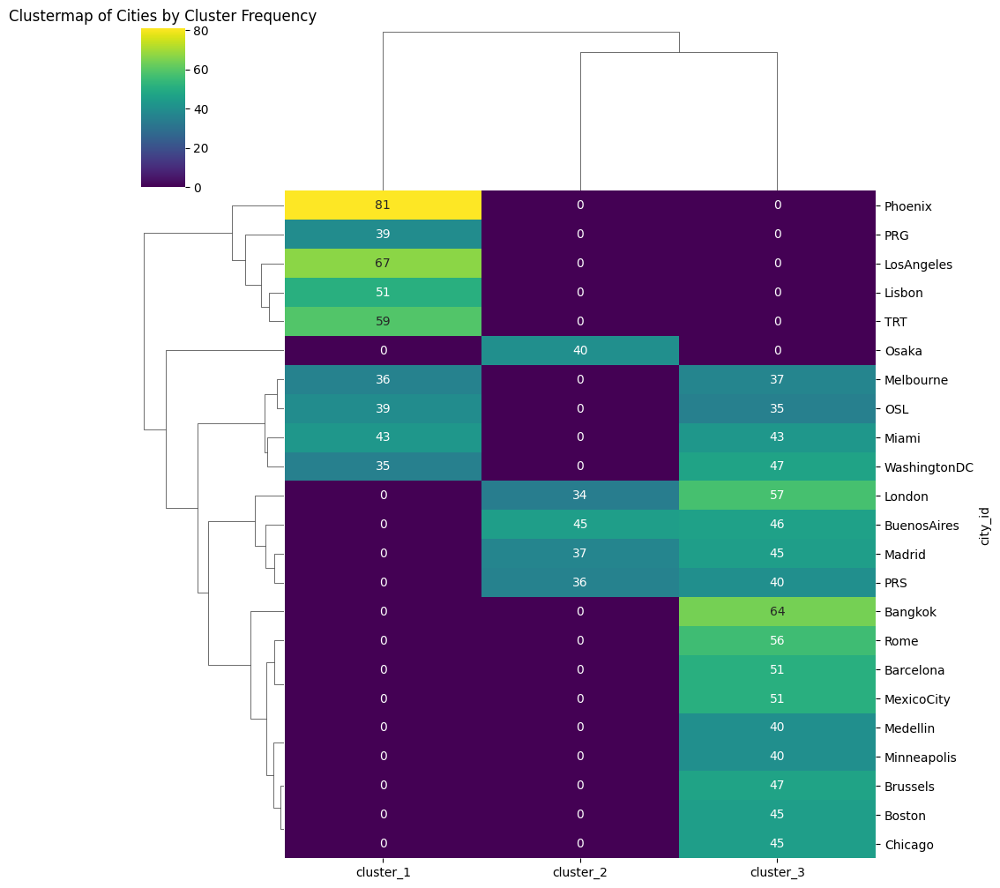

In [398]:
filtered_clusters.set_index('city_id', inplace=True)

# Create a clustermap
sns.clustermap(filtered_clusters, cmap='viridis', figsize=(10, 10), annot=True, fmt="d")
plt.title('Clustermap of Cities by Cluster Frequency')
plt.show()

- **Insights Observations** : 
    - **Strong Isolation in Cluster 1 Activities**: Cities like `Phoenix`, `PRG`, and `Los Angeles` show **exclusive** and **high activity levels** in cluster_1 (81, 39, and 67 respectively), with no activities recorded in clusters 2 and 3. This distinct isolation indicates these cities may have **specific characteristics** or events unique to them, which are not shared with or are very different from the activities captured by the other clusters.
        - This is implied by the overall anlysis, too. 
    - **Cluster 3** as a Common Ground for Several Cities: Cities such as `Bangkok`, `Rome`, `Barcelona`, and `Brussels` show significant activities solely in cluster_3 (64, 56, 51, and 47 respectively).
    - **Divergent Patterns in European Cities**: London and Madrid show activities in both cluster_2 and cluster_3 but not in cluster_1, suggesting a bifurcation in how these cities interact with the criteria defined by these two clusters. Their placement in the heatmap, close to each other, further indicates similar patterns of behavior or interaction that differ from the more isolated patterns seen in cities like Phoenix or Los Angeles.

## `5` Conclusion 

## Summary of Findings
- **Effectiveness of K-Means**: K-Means clustering tends to perform better with fewer features. The presence of non-collinear and non-correlated features significantly enhances the clustering of similar images.
- **Importance of Scaling**: Proper scaling of data is crucial for optimal performance of the K-Means algorithm.
- **Human Interaction**: Active human observation of the clustering process and the use of tools like the silhouette score are essential. This human element helps to understand and refine the clustering results based on subjective assessments.
    - The key is the observation of the images to understand what features you need to create for example if there are many object we need features like NN (ResNet) fir feature detection, edge density. If there are light images then brightness or colors usage (e.g. avg R B G) may be useful features. The data guides you. 
    - For instance, manually reviewing images before clustering can guide the creation of relevant features like edge density, which proved beneficial.
- **EDA Insights**: Extensive exploratory data analysis revealed that a combination of features such as edge density, brightness, and contrast is effective. Correlation and pairwise relation analysis during EDA are instrumental in optimizing feature selection. We avoid correlated or coleniarity potential features.
- A general Comment, during this assgnemnt we observed that human subjectivity and observation play role not only tools like shilouette should decide for k as some clusters may not make sense. 

## Limitations
- **Memory Constraints**: Due to memory limitations, only a limited number of features were examined randomly (where the sample may not be representing as only 100 images takes per city). Future efforts might benefit from a more structured sampling approach, perhaps using metadata to ensure a balanced representation across different conditions such as city or time of year.
    - Furthermore duw to space limitations we could not teh advantage to compare the results via increasing the size of images e.g. 224 x 224 and mbigger sized instead of 128 x 128. 
- **Time Constraints**: Due to time limitations we had not enough time to emprically investigate more feature combiantion and additional apply PCA before applying k-means to try to reduce coleniarity in some features (e.g. brightbess ans avg R B G) that may be promising as colors may play important role to clsutering. Of course this would be investigated via applying the stategy we mentiones in the section of k-menas. We have created many features but we had not time ideally to combine small number of features of potential promissing features in order to having better vie if we could find a better combination of features. 
    - Foe example, we would like to trying to combine the color diamension eith color histogram or avg colors and lbp and with the already 3 good feature and try to find a good combination of these. 
    - This had to be implemented emprirically.
    - Of couse because some features like RGB nad brightness has correlation if we had time we would like to apply PCA before fitting them to k means. (we mention them to future work, too)

## `Future Work`
- **Sampling Strategy**: Given memory constraints, a random sample of 100 images per city was used. However, this approach may introduce biases (e.g., more images from certain months) if teh majority of images are from summer then light images may be dominant. or northdeg metada may affect ther result as teh directions of images focus on building or lat lon close places id may be similar enough so Future work should consider more refined sampling strategies leveraging the metada, leveraging metadata to avoid biases related to specific cities or times.
    In other words the metadata analysis in part a' could be leveraged for better samplings (monbth distribution equal sample per month to biased to color, northdeg not biased to derection e.g. more walls intead of streets or lot,lan not quite close places id as thay may be biased to similaity).
- **Image Resolution**: Increase image resolution from 128x128 to 224x224 and more to potentially improve feature extraction using models like ResNet, which are optimized for the latter size. Besides ResNet default settings, this direction of investigation of increasing the size of images may improved feature extraction as increasing the resolution of an image to a larger dimension, such as from 128 to 224 pixels, can preserve more details and subtle nuances. This enhancement is beneficial for tasks requiring fine-grained feature recognition, such as advanced image processing, detailed object detection, and high-accuracy computer vision applications, leading to better overall performance in extracting and utilizing visual information.
- **Try More Combiantions of Features** focusing on features related to colors in more depth for example the features related to R G B average colrs or color histogram may be useful for clustering similar images. Despite color investiagtion,  it may deserve the effort for more trial in teh future related to lbp. 
    - Important Note : Because **brightness** and **R**  **B** **G**  are correalated based on EDA analysis it may worth the effort in the fuuture to try PCA before feeding the data to k-menas in order to limit the correlation to a ertain extent  and leverage the color diamension, too, and check if teh images are clustered better applying again the stategy mentiones in the section k-means.
    - Generally, we would like to add in the promining features the color diamension because intuitively we think that we improve the result so we think worrth emrically investiagting it. As the current "promissing" combination of features don't incluse neither r b g average color nor color histogram. 
- Trying ResNet with input image 224 x 224 as it mentiones and other NN object dector too.  
- **Apply Sub Clustering**  In addition, for the "promising" combination of features with k = 4 (see the third line in the below image the two first have green trees and the last image is quite diffrent whereas teh reaming clsuters makes sense), so maybe applying additional cluster only to the third cluster will be promising. 
    - Applying clustering only to cluester we cannot interpreat (in other words further clustering) to challenging subgroups may yield more nuanced insights.
- **New Features**: Develop additional features, such as those related to image edges using techniques like the Sobel edge detector, and reassess the clustering results (as edge features found to promsiing) or others too. The aim would be to create features that enhance the distinction between clusters. Read more material about potential "standard" good features in the provided bibliography (good image practices for iamge detection) to create and investiagte. 
- **Reduction of Overlap in Visualizations**: Efforts will be made to minimize overlap in radar plot interpretations to clear up the visualization of cluster characteristics.
- `Making Trilas applying PCA  **before** feeding to K-Means to see if it helps the model. This may be helpful to introduce color  features and decreasign the coleniarity too`. 
- In short, The goal of future work will be to refine the clustering process, improve feature selection and extraction, and ensure more representative and unbiased samples are used for training and analysis.


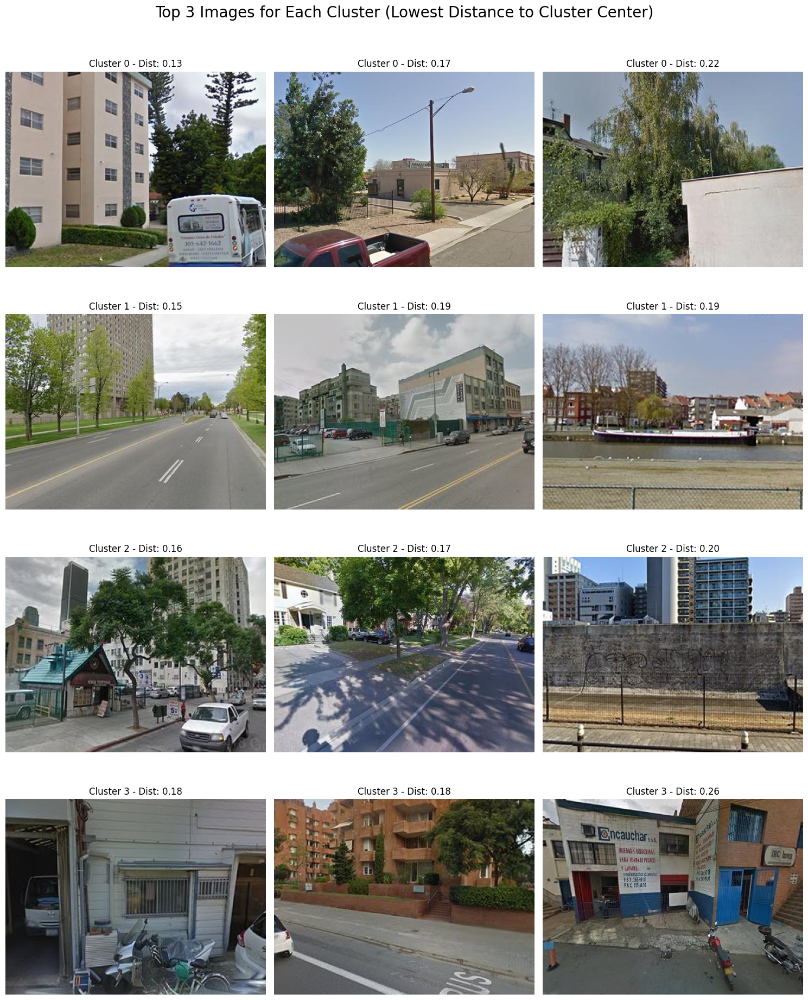

In [428]:
plot_top_images_all_clusters(df_approach_1, file_path_column='file_path', cluster_column='cluster', distance_column='distance_to_center')


##  `Part 3`: `End Application`
### Inter-Annotator Agreement and Analyse the Task Diﬃculty.

- we will intiialize a folder hosting all the material of excel annotations. 

In [399]:
annotation_folder = "/student/"

- Regarding our dataset, we will load multiple `excel` files (being 12 in total)  hosted on the folder `annotations`.
- For this purpose, we wrote the function `load_and_combine_annotations` which "integrates" all of the provided excels following the agreement format.
    - We leveraged `regular expessions` in order to eliminate the reading of files not follow the format: f[ID] or P[ID] where ID is student's ID. This format is given by our professor, adn we used it as constaing to our function.
        - So, we defined the regular expression : `re.compile(r'^[a-zA-Z]\d{7}\.xlsx$')`<br>
    - Regarding the structure of our "integrated" dataframe (named `df_annotations`) we have the following elements: 
        - `ID_Annotator`, being a column created aditionally by us, representing from which annotator (thet is the **source**) coming from a row of our created dataframe. It is helpful for debugginh purposes as well as for the visualization of our task.
        - `text`, being  a given column of the provided seperated excels, representing the sentence(s), the annotator had to lebel.
        - And the folloowing columns that is `Anger`, `Fear`, `Joy`, `Sadness`, `Surprise` represent the columns related to emotions, in which the annotator had to assign either `1` (for having this emotion) or `0` (for not having this emotion).
    - Furthermore, via observing the given seperated excel files, we observed that they contain in the first row the "instructions", and as a result we skipped this line.
        - line of code : `read_options = {'skiprows': 1} if skip_first_row else {}`

In [400]:
def load_and_combine_annotations(
                                folder_path: str = './student/', 
                                skip_first_row: bool = True
                                ) -> pd.DataFrame:
    """
    Loads and combines all Excel files from a specified folder that follow the pattern `[letter][7 digits].xlsx`.
    Adds an 'ID_Annotator' column for each file's identifier (filename without the extension).
    
    :param:folder_path (str), path to the folder containing annotation files.
    :param:skip_first_row (bool), If True, skips the first row of each file.
    :return:pd.DataFrame, A combined DataFrame with all annotation data, including an 'ID_Annotator' column.
    """
    
    # Define regex pattern to match filenames like "f1234567.xlsx"
    file_pattern = re.compile(r'^[a-zA-Z]\d{7}\.xlsx$')
    
    # List to store DataFrames for each valid file
    dataframes = []
    
    # Iterate through each file in the specified folder
    for filename in os.listdir(folder_path):
        print(filename)
        if file_pattern.match(filename):
            # Extract the index part (e.g., "f1234567" from "f1234567.xlsx")
            index_name = filename.split('.')[0]
            
            # Construct full file path
            file_path = os.path.join(folder_path, filename)
            
            # Define options for reading the file
            # Skip the first line of each "excel" file (meaning skip the Instructions). 
            read_options = {'skiprows': 1} if skip_first_row else {}
            
            # Load the Excel file
            df = pd.read_excel(file_path, **read_options)
            
            # Insert 'ID_Annotator' column with the file's identifier
            df.insert(0, 'ID_Annotator', index_name)
            
            # Add the DataFrame to our list
            dataframes.append(df)
    
    # Concatenate all individual DataFrames into a single DataFrame
    combined_df = pd.concat(dataframes)
    
    return combined_df

# Usage example
df_annotations = load_and_combine_annotations() # call the function 
df_annotations_copy = df_annotations.copy()
df_annotations # preview ou data frame 

f3352404.xlsx
f3352405.xlsx
f3210105.xlsx
f3352409.xlsx
f3352402.xlsx
f3352316.xlsx
f3352403.xlsx
f3352401.xlsx
f3352406.xlsx
f3352410.xlsx
f3352411.xlsx
f3352407.xlsx


,ID_Annotator,Image URL,Image,Categorie,Other...
0,f3352404,https://drive.google.com/uc?export=view&id=1SN...,NaN,"Debris and Environmental Hazards, Parked Vehic...",NaN
1,f3352404,https://drive.google.com/uc?export=view&id=1mr...,NaN,"Parked Vehicles Obstructing Sidewalks, Narrow ...",NaN
2,f3352404,https://drive.google.com/uc?export=view&id=1x2...,NaN,"Parked Vehicles Obstructing Sidewalks, Narrow ...",NaN
3,f3352404,https://drive.google.com/uc?export=view&id=135...,NaN,"Parked Vehicles Obstructing Sidewalks, Narrow ...",NaN
4,f3352404,https://drive.google.com/uc?export=view&id=15_...,NaN,"Parked Vehicles Obstructing Sidewalks, Narrow ...",NaN
...,...,...,...,...,...
119,f3352407,https://drive.google.com/uc?export=view&id=1IW...,NaN,"Parked Vehicles Obstructing Sidewalks, Obstacl...",NaN
120,f3352407,https://drive.google.com/uc?export=view&id=1SJ...,NaN,"Parked Vehicles Obstructing Sidewalks, Narrow ...",NaN
121,f3352407,https://drive.google.com/uc?export=view&id=1Vg...,NaN,Blocked or Limited Crossing Access,NaN
122,f3352407,https://drive.google.com/uc?export=view&id=1lK...,NaN,Parked Vehicles Obstructing Sidewalks,NaN


- Fine we loaded teh data.

In [401]:
df_annotations.shape[0] # logic number as 124 all row annotation rows and 12 anntoatos 

1488

- we will remove usless columns 

In [402]:
df_annotations.columns

Index(['ID_Annotator', 'Image URL ', 'Image', 'Categorie', 'Other...'], dtype='object')

In [403]:
df_annotations['Other...'].value_counts()

Other...
Inaccesible for people with disabilities                            1
Restaurant chairs could narrow sidewalk space                       1
ramp inaccesible for people with disabilities due to parked cars    1
Name: count, dtype: int64

- because only one annotator has used the column other, we will drop it, as he will disagree with all remaining ones. 

In [404]:
df_annotations = df_annotations.drop(columns=["Image", "Other..."])
df_annotations

,ID_Annotator,Image URL,Categorie
0,f3352404,https://drive.google.com/uc?export=view&id=1SN...,"Debris and Environmental Hazards, Parked Vehic..."
1,f3352404,https://drive.google.com/uc?export=view&id=1mr...,"Parked Vehicles Obstructing Sidewalks, Narrow ..."
2,f3352404,https://drive.google.com/uc?export=view&id=1x2...,"Parked Vehicles Obstructing Sidewalks, Narrow ..."
3,f3352404,https://drive.google.com/uc?export=view&id=135...,"Parked Vehicles Obstructing Sidewalks, Narrow ..."
4,f3352404,https://drive.google.com/uc?export=view&id=15_...,"Parked Vehicles Obstructing Sidewalks, Narrow ..."
...,...,...,...
119,f3352407,https://drive.google.com/uc?export=view&id=1IW...,"Parked Vehicles Obstructing Sidewalks, Obstacl..."
120,f3352407,https://drive.google.com/uc?export=view&id=1SJ...,"Parked Vehicles Obstructing Sidewalks, Narrow ..."
121,f3352407,https://drive.google.com/uc?export=view&id=1Vg...,Blocked or Limited Crossing Access
122,f3352407,https://drive.google.com/uc?export=view&id=1lK...,Parked Vehicles Obstructing Sidewalks


- we will extend the datafarame with the number of columns as tehy are in the excel provided categories. 

In [405]:
# Ensure 'Categorie' column is treated as a string and handle NaN
df_annotations['Categorie'] = df_annotations['Categorie'].fillna("").astype(str)

# Define the list of categories
categories = [
    'Parked Vehicles Obstructing Sidewalks',
    'Narrow or Limited Sidewalk Space',
    'Uneven or Hazardous Pavement',
    'Obstacles from Natural Elements',
    'Miscellaneous Obstructions',
    'Blocked or Limited Crossing Access',
    'Debris and Environmental Hazards'
]

# Create columns for each category
for category in categories:
    df_annotations[category] = df_annotations['Categorie'].apply(lambda x: 1 if category in x else 0)

# Display the updated DataFrame
df_annotations

,ID_Annotator,Image URL,Categorie,Parked Vehicles Obstructing Sidewalks,Narrow or Limited Sidewalk Space,Uneven or Hazardous Pavement,Obstacles from Natural Elements,Miscellaneous Obstructions,Blocked or Limited Crossing Access,Debris and Environmental Hazards
0,f3352404,https://drive.google.com/uc?export=view&id=1SN...,"Debris and Environmental Hazards, Parked Vehic...",1,1,0,0,0,0,1
1,f3352404,https://drive.google.com/uc?export=view&id=1mr...,"Parked Vehicles Obstructing Sidewalks, Narrow ...",1,1,0,0,0,0,1
2,f3352404,https://drive.google.com/uc?export=view&id=1x2...,"Parked Vehicles Obstructing Sidewalks, Narrow ...",1,1,1,0,0,0,0
3,f3352404,https://drive.google.com/uc?export=view&id=135...,"Parked Vehicles Obstructing Sidewalks, Narrow ...",1,1,1,0,0,0,1
4,f3352404,https://drive.google.com/uc?export=view&id=15_...,"Parked Vehicles Obstructing Sidewalks, Narrow ...",1,1,1,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...
119,f3352407,https://drive.google.com/uc?export=view&id=1IW...,"Parked Vehicles Obstructing Sidewalks, Obstacl...",1,0,0,1,0,0,0
120,f3352407,https://drive.google.com/uc?export=view&id=1SJ...,"Parked Vehicles Obstructing Sidewalks, Narrow ...",1,1,0,0,0,0,0
121,f3352407,https://drive.google.com/uc?export=view&id=1Vg...,Blocked or Limited Crossing Access,0,0,0,0,0,1,0
122,f3352407,https://drive.google.com/uc?export=view&id=1lK...,Parked Vehicles Obstructing Sidewalks,1,0,0,0,0,0,0


- check if tehre is any annotaros have not been annotated nothing. 

In [406]:
# List of category columns
category_columns = [
    'Parked Vehicles Obstructing Sidewalks',
    'Narrow or Limited Sidewalk Space',
    'Uneven or Hazardous Pavement',
    'Obstacles from Natural Elements',
    'Miscellaneous Obstructions',
    'Blocked or Limited Crossing Access',
    'Debris and Environmental Hazards'
]

# Group by annotator and sum up all category annotations for each
annotator_annotation_totals = df_annotations.groupby('ID_Annotator')[category_columns].sum()

# Identify annotators whose total annotations across all categories are zero
non_annotating_ids = annotator_annotation_totals[annotator_annotation_totals.sum(axis=1) == 0].index.tolist()

# Display the result
print("Annotators with no annotations across all images and categories:")
print(non_annotating_ids)


Annotators with no annotations across all images and categories:
['f3210105']


- we will remove annotator `f3210105` as tehy have not annoatted nothing.
    - We will focus on teh provided data only. 

In [407]:
# Filter out rows where ID_Annotator is 'f3210105'
df_annotations = df_annotations[df_annotations['ID_Annotator'] != 'f3210105']

# Optionally, you can also confirm by checking if 'f3210105' still exists in the DataFrame
remaining_annotators = df_annotations['ID_Annotator'].unique()
print("Remaining annotators:", remaining_annotators)

Remaining annotators: ['f3352404' 'f3352405' 'f3352409' 'f3352402' 'f3352316' 'f3352403'
 'f3352401' 'f3352406' 'f3352410' 'f3352411' 'f3352407']


In [408]:
df_annotations

,ID_Annotator,Image URL,Categorie,Parked Vehicles Obstructing Sidewalks,Narrow or Limited Sidewalk Space,Uneven or Hazardous Pavement,Obstacles from Natural Elements,Miscellaneous Obstructions,Blocked or Limited Crossing Access,Debris and Environmental Hazards
0,f3352404,https://drive.google.com/uc?export=view&id=1SN...,"Debris and Environmental Hazards, Parked Vehic...",1,1,0,0,0,0,1
1,f3352404,https://drive.google.com/uc?export=view&id=1mr...,"Parked Vehicles Obstructing Sidewalks, Narrow ...",1,1,0,0,0,0,1
2,f3352404,https://drive.google.com/uc?export=view&id=1x2...,"Parked Vehicles Obstructing Sidewalks, Narrow ...",1,1,1,0,0,0,0
3,f3352404,https://drive.google.com/uc?export=view&id=135...,"Parked Vehicles Obstructing Sidewalks, Narrow ...",1,1,1,0,0,0,1
4,f3352404,https://drive.google.com/uc?export=view&id=15_...,"Parked Vehicles Obstructing Sidewalks, Narrow ...",1,1,1,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...
119,f3352407,https://drive.google.com/uc?export=view&id=1IW...,"Parked Vehicles Obstructing Sidewalks, Obstacl...",1,0,0,1,0,0,0
120,f3352407,https://drive.google.com/uc?export=view&id=1SJ...,"Parked Vehicles Obstructing Sidewalks, Narrow ...",1,1,0,0,0,0,0
121,f3352407,https://drive.google.com/uc?export=view&id=1Vg...,Blocked or Limited Crossing Access,0,0,0,0,0,1,0
122,f3352407,https://drive.google.com/uc?export=view&id=1lK...,Parked Vehicles Obstructing Sidewalks,1,0,0,0,0,0,0


- Fine teh annotator removed the numebr of rows of df correctly adapted.

- fieen we extended the dataframe and we have it in a format to apply the main goa lcalcuate the agreement.

In [409]:
df_annotations.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1364 entries, 0 to 123
Data columns (total 10 columns):
 #   Column                                 Non-Null Count  Dtype 
---  ------                                 --------------  ----- 
 0   ID_Annotator                           1364 non-null   object
 1   Image URL                              1364 non-null   object
 2   Categorie                              1364 non-null   object
 3   Parked Vehicles Obstructing Sidewalks  1364 non-null   int64 
 4   Narrow or Limited Sidewalk Space       1364 non-null   int64 
 5   Uneven or Hazardous Pavement           1364 non-null   int64 
 6   Obstacles from Natural Elements        1364 non-null   int64 
 7   Miscellaneous Obstructions             1364 non-null   int64 
 8   Blocked or Limited Crossing Access     1364 non-null   int64 
 9   Debris and Environmental Hazards       1364 non-null   int64 
dtypes: int64(7), object(3)
memory usage: 117.2+ KB


- fine we have not misisng valeus .

Fine. Now we are ready to start with the calculation of prior probability.

- The following cell calculates the prior probability of each category that prevents people from walking on pavements per annotator by grouping the data in `df_annotations` by `ID_Annotator` and averaging the binary values in each category column. The categories include:
  - Parked Vehicles Obstructing Sidewalks
  - Narrow or Limited Sidewalk Space
  - Uneven or Hazardous Pavement
  - Obstacles from Natural Elements
  - Miscellaneous Obstructions
  - Blocked or Limited Crossing Access
  - Debris and Environmental Hazards

- The resulting DataFrame, `prior_probabilities_per_annotator_per_category`, provides the probability that each annotator marks a category as present across all their annotations, giving insight into individual labeling tendencies.

- Generally, the prior probability of an event \( A \) (in our case, a category of sidewalk obstruction) is defined as:

$$
P(A) = \frac{\text{Number of occurrences of } A}{\text{Total number of outcomes}}
$$

where:
- **Number of occurrences of \( A \)**: The number of times the event has been observed to occur.
- **Total number of outcomes**: The total number of possible outcomes or trials observed.


In [410]:
# Calculate prior probabilities per annotator for each category
prior_probabilities_per_annotator_per_category = df_annotations.groupby("ID_Annotator")[
    [
        'Parked Vehicles Obstructing Sidewalks',
        'Narrow or Limited Sidewalk Space',
        'Uneven or Hazardous Pavement',
        'Obstacles from Natural Elements',
        'Miscellaneous Obstructions',
        'Blocked or Limited Crossing Access',
        'Debris and Environmental Hazards'
    ]
].mean()  # Use mean to leverage binary data for calculating probabilities

# Preview the prior probabilities per annotator
prior_probabilities_per_annotator_per_category


,Parked Vehicles Obstructing Sidewalks,Narrow or Limited Sidewalk Space,Uneven or Hazardous Pavement,Obstacles from Natural Elements,Miscellaneous Obstructions,Blocked or Limited Crossing Access,Debris and Environmental Hazards
ID_Annotator,,,,,,,
f3352316,0.475806,0.419355,0.104839,0.177419,0.024194,0.193548,0.274194
f3352401,0.645161,0.653226,0.145161,0.354839,0.064516,0.241935,0.387097
f3352402,0.379032,0.427419,0.153226,0.596774,0.120968,0.129032,0.403226
f3352403,0.338710,0.685484,0.233871,0.145161,0.056452,0.250000,0.395161
f3352404,0.612903,0.564516,0.258065,0.274194,0.088710,0.120968,0.209677
f3352405,0.217742,0.830645,0.120968,0.540323,0.088710,0.104839,0.419355
f3352406,0.653226,0.201613,0.040323,0.056452,0.040323,0.314516,0.314516
f3352407,0.725806,0.475806,0.145161,0.177419,0.024194,0.153226,0.056452
f3352409,0.556452,0.145161,0.016129,0.088710,0.056452,0.153226,0.112903


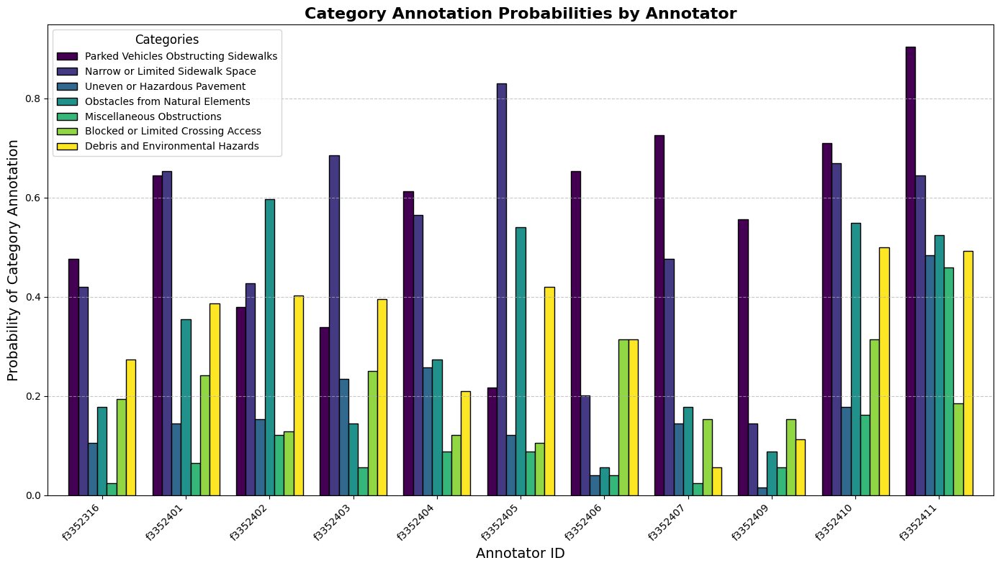

In [411]:
# Plotting
ax = prior_probabilities_per_annotator_per_category.plot(
    kind="bar",
    figsize=(14, 8),
    width=0.8,
    edgecolor="black",
    colormap="viridis"
)

# Enhancing plot details for professionalism
ax.set_title("Category Annotation Probabilities by Annotator", fontsize=16, fontweight="bold")
ax.set_xlabel("Annotator ID", fontsize=14)
ax.set_ylabel("Probability of Category Annotation", fontsize=14)
ax.legend(title="Categories", title_fontsize=12, fontsize=10)
ax.grid(axis="y", linestyle="--", alpha=0.7)  # Adding a light grid for readability

# Rotating x-axis labels and setting layout
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.yticks(fontsize=10)
plt.tight_layout()

# Display the plot
plt.show()


- Genral Comments : There in  imabalnce among the annoattors among the diffrent categories. 
- Some examples of annotators behaviour : 
    - Annotator f3524106 has a high likelihood of marking "Parked Vehicles Obstructing Sidewalks" compared to other categories.
    - Annotator f352410 frequently reports "Debris and Environmental Hazards," indicating a tendency to notice environmental issues.
    - Annotator f3522401 seems to uniformly report across several categories, suggesting a balanced perception of various obstructions.
- Least and Most Reported Categories:
    - "Parked Vehicles Obstructing Sidewalks" and "Debris and Environmental Hazards" are commonly reported by several annotators, suggesting these are prominent issues.
    - "Miscellaneous Obstructions" appears less frequently across the board, which could indicate that these are less common or not as easily categorized by the annotators.

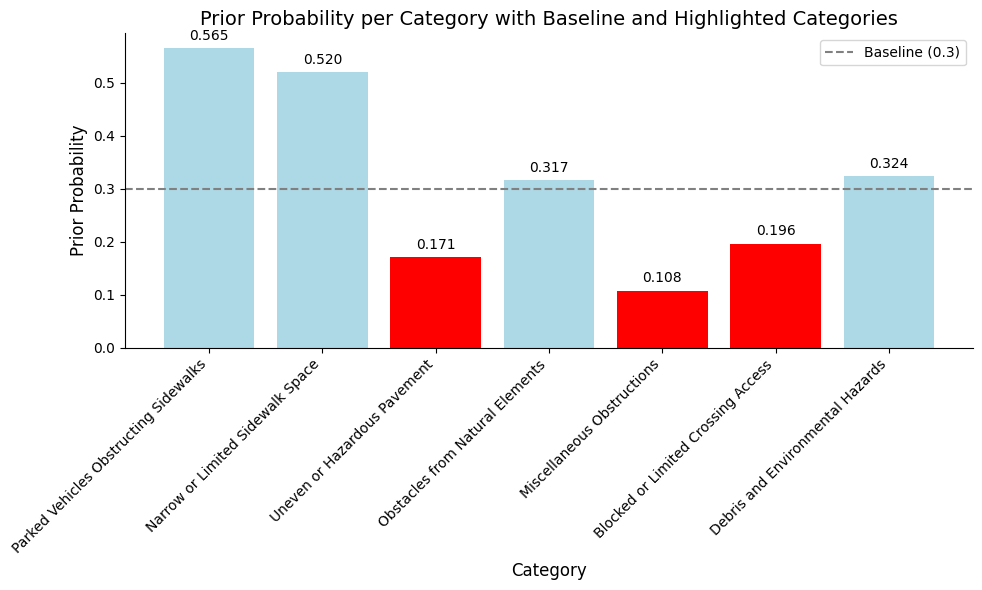

In [412]:
# Calculate the mean for each category column to get the prior probabilities
prior_probabilities_per_category = df_annotations[
    [
        'Parked Vehicles Obstructing Sidewalks',
        'Narrow or Limited Sidewalk Space',
        'Uneven or Hazardous Pavement',
        'Obstacles from Natural Elements',
        'Miscellaneous Obstructions',
        'Blocked or Limited Crossing Access',
        'Debris and Environmental Hazards'
    ]
].mean()
dict_prior_probability_per_category = dict(prior_probabilities_per_category)

# Colors for emphasis: highlight specific categories if needed
highlighted_categories = ['Blocked or Limited Crossing Access', 'Uneven or Hazardous Pavement',  'Miscellaneous Obstructions']
colors = [
    'red' if category in highlighted_categories else 'lightblue'
    for category in dict_prior_probability_per_category.keys()
]

# Plotting histogram
plt.figure(figsize=(10, 6))
bars = plt.bar(
    dict_prior_probability_per_category.keys(),
    dict_prior_probability_per_category.values(),
    color=colors
)

# Adding baseline at 0.2
plt.axhline(y=0.3, color='gray', linestyle='--', linewidth=1.5, label='Baseline (0.3)')

# Adding data labels above each bar
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, yval + 0.01, f'{yval:.3f}', ha='center', va='bottom')

# Titles and labels
plt.xlabel('Category', fontsize=12)
plt.ylabel('Prior Probability', fontsize=12)
plt.title('Prior Probability per Category with Baseline and Highlighted Categories', fontsize=14)
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.legend()

# Removing upper and right axes
ax = plt.gca()  # Get the current axis
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

plt.tight_layout()
plt.show()


- It is obvious taht the categories  with red are underpresented in comaprison to the remaining ones. 
- So, the imbalance is obvious from this plot too. 
- Doe to the imbalance and because we want the random factor we will use the kappa metric.

In [413]:
list_all_anotators_ID = df_annotations.ID_Annotator.to_list()

- For the calculation of  pairwise kappa we created the function `calculate_pairwise_kappa`
    - `calculate_pairwise_kappa` computes the pairwise Cohen's Kappa score between each pair of annotators for a specified list of categories. 
    - Given a DataFrame containing annotator IDs and labels for different emotions, this function returns a matrix of kappa scores, helping researchers and data analysts understand agreement levels between annotators on each category.

In [414]:
def calculate_pairwise_kappa(df_annotations: pd.DataFrame, 
                             id_col: str = "ID_Annotator", 
                             emotion_cols: list = None
                            ) -> pd.DataFrame:
    """
    Calculates the pairwise Cohen's Kappa agreement between annotators across specified emotion columns.
    
    :params df_annotations: pd.DataFrame containing annotator IDs and emotion labels.
    :param id_col: Column name for annotator IDs.
    :param emotion_cols: List of emotion column(s) for which agreement is calculated.
    
    :returns: A DataFrame showing Cohen's Kappa scores between each pair of annotators.
    """
    
    # Step 1: Define unique annotators based on the ID column
    annotators = df_annotations[id_col].unique()
    
    # Step 2: Initialize an empty DataFrame to store Cohen's Kappa scores for each pair of annotators
    kappa_scores = pd.DataFrame(index=annotators, columns=annotators)
    
    # Step 3: Calculate pairwise Cohen's Kappa
    for i, annotator_i in enumerate(annotators):  # Loop over each annotator
        for j, annotator_j in enumerate(annotators):  # Loop over each annotator again to form pairs
            if i >= j:
                continue  # Skip redundant pairs and self-comparison
            
            # Filter data for each annotator in the current pair
            data_i = df_annotations[df_annotations[id_col] == annotator_i][emotion_cols]
            data_j = df_annotations[df_annotations[id_col] == annotator_j][emotion_cols]
            
            # Align data on the same index, assuming both annotators labeled the same instances
            merged = pd.merge(data_i, data_j, left_index=True, right_index=True, suffixes=('_i', '_j'))
            
            # Calculate Cohen's Kappa for each emotion and take the mean
            kappa_list = []
            for emotion in emotion_cols:
                # Calculate Cohen's Kappa for each emotion between the two annotators
                kappa = cohen_kappa_score(merged[f"{emotion}_i"], merged[f"{emotion}_j"])
                kappa_list.append(kappa)
            
            # Calculate average kappa score for all emotions and store it
            avg_kappa = round(np.nanmean(kappa_list), 2)  # NaNs are ignored in averaging
            kappa_scores.loc[annotator_i, annotator_j] = avg_kappa
    
    # Fill the diagonal with 1.0 to represent perfect self-agreement
    np.fill_diagonal(kappa_scores.values, 1.0)
    
    # Fill NaN values with "-" for readability and return the matrix
    return kappa_scores.fillna("-")

- call function `calculate_pairwise_kappa`   `per Category`

In [415]:
kappa_scores_matrix_parked_vehicles = calculate_pairwise_kappa(
    df_annotations, 
    id_col="ID_Annotator", 
    emotion_cols=["Parked Vehicles Obstructing Sidewalks"]
)

kappa_scores_matrix_narrow_sidewalk = calculate_pairwise_kappa(
    df_annotations, 
    id_col="ID_Annotator", 
    emotion_cols=["Narrow or Limited Sidewalk Space"]
)

kappa_scores_matrix_uneven_pavement = calculate_pairwise_kappa(
    df_annotations, 
    id_col="ID_Annotator", 
    emotion_cols=["Uneven or Hazardous Pavement"]
)

kappa_scores_matrix_natural_obstacles = calculate_pairwise_kappa(
    df_annotations, 
    id_col="ID_Annotator", 
    emotion_cols=["Obstacles from Natural Elements"]
)

kappa_scores_matrix_miscellaneous = calculate_pairwise_kappa(
    df_annotations, 
    id_col="ID_Annotator", 
    emotion_cols=["Miscellaneous Obstructions"]
)

kappa_scores_matrix_blocked_crossing = calculate_pairwise_kappa(
    df_annotations, 
    id_col="ID_Annotator", 
    emotion_cols=["Blocked or Limited Crossing Access"]
)

kappa_scores_matrix_debris_hazards = calculate_pairwise_kappa(
    df_annotations, 
    id_col="ID_Annotator", 
    emotion_cols=["Debris and Environmental Hazards"]
)

- We will plot our data with the already function presented being `plot_multiple_heatmaps_layout_1_3` (in order to be readable).
- Furthermore, we will calculate which percenatge of the values on out heatmaps have values more than 0.65.

In [416]:
def plot_multiple_heatmaps_layout_1_3(
    dfs, 
    titles=None, 
    color_map="Blues"
) -> None:
    """
    Plots multiple heatmaps side by side for the given list of DataFrames with values displayed in each cell.
    Adjusted to display 3 heatmaps per row.

    :param dfs: list - A list of DataFrames to plot.
    :param titles: list - A list of titles for each heatmap. If None, default titles are used.
    :param color_map: str - The color map to use for the heatmaps (default is 'Blues').

    Note: Displays 3 heatmaps per row.
    """
    
    # Validate input types
    if not isinstance(dfs, list) or not all(isinstance(df, pd.DataFrame) for df in dfs):
        raise TypeError("dfs must be a list of pandas DataFrames")
    
    if titles is None:
        titles = [f"Heatmap {i+1}" for i in range(len(dfs))]
    elif not isinstance(titles, list) or not all(isinstance(title, str) for title in titles):
        raise TypeError("titles must be a list of strings")
    
    # Number of rows and columns
    n_rows = (len(dfs) + 2) // 3  # Calculate the number of rows needed
    n_cols = min(3, len(dfs))     # Number of columns is 3 unless there are fewer than 3 heatmaps
    
    # Set up the subplot figure with a flexible grid
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(6 * n_cols, 6 * n_rows), squeeze=False)
    
    # Plot each heatmap
    for idx, (df, title) in enumerate(zip(dfs, titles)):
        row, col = divmod(idx, 3)
        ax = axes[row, col]
        df = df.apply(pd.to_numeric, errors='coerce')  # Ensure non-numeric entries are converted to NaN
        ax.set_title(title)
        heatmap = ax.imshow(df, cmap=color_map, aspect="auto", interpolation="nearest")
        fig.colorbar(heatmap, ax=ax, label="Value")
        
        # Configure x and y ticks
        ax.set_xticks(range(len(df.columns)))
        ax.set_xticklabels(df.columns, rotation=90)
        ax.set_yticks(range(len(df.index)))
        ax.set_yticklabels(df.index)
        
        # Display values in each cell
        for row in range(df.shape[0]):
            for col in range(df.shape[1]):
                value = df.iloc[row, col]
                if not pd.isna(value):
                    ax.text(col, row, f"{value:.2f}", ha="center", va="center", color="black")

    # Adjust layout
    plt.tight_layout()
    plt.show()


- Let's print the results. 

=======================Kappa per Category =========


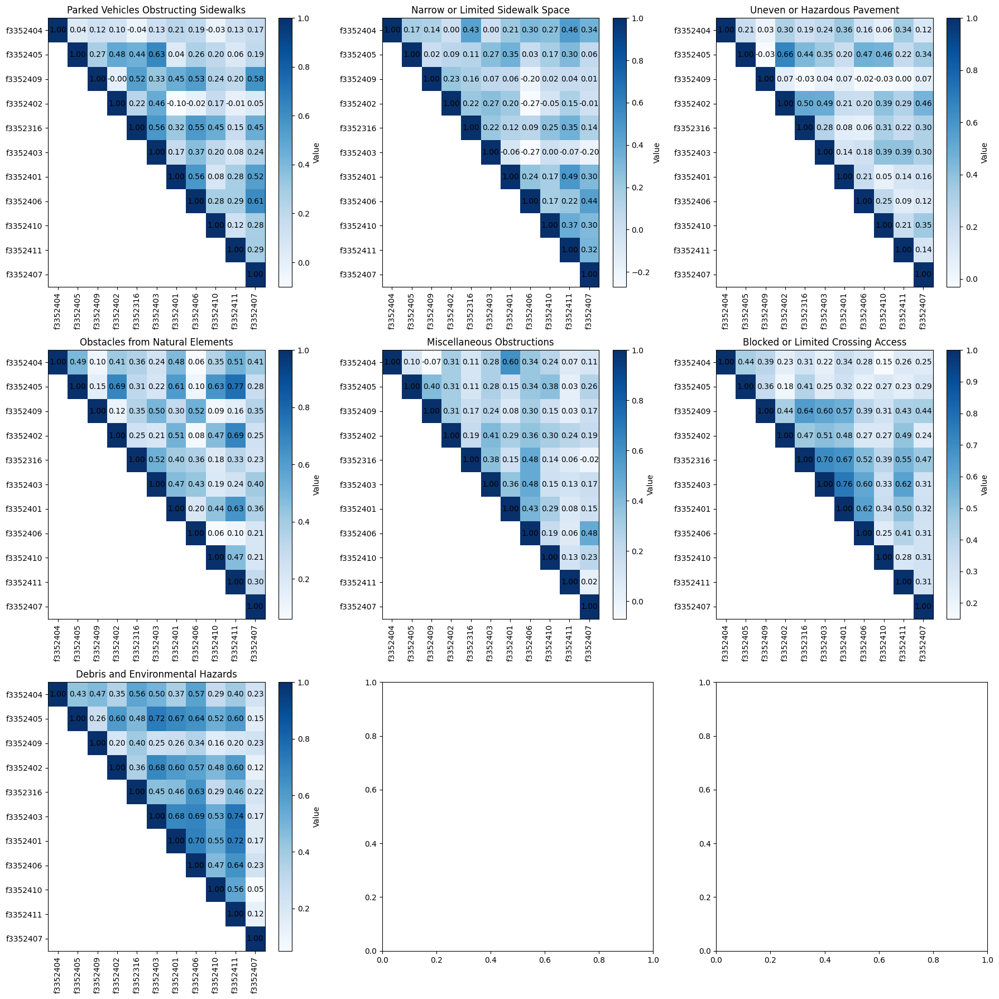

Parked Vehicles Obstructing Sidewalks :: Percentage of coverage having more than 65% values in each cell:  9%
Narrow or Limited Sidewalk Space :: Percentage of coverage having more than 65% values in each cell:  9%
Uneven or Hazardous Pavement :: Percentage of coverage having more than 65% values in each cell:  10%
Obstacles from Natural Elements :: Percentage of coverage having more than 65% values in each cell:  12%
Miscellaneous Obstructions :: Percentage of coverage having more than 65% values in each cell:  9%
Blocked or Limited Crossing Access :: Percentage of coverage having more than 65% values in each cell:  12%
Debris and Environmental Hazards :: Percentage of coverage having more than 65% values in each cell:  16%


In [417]:
print('=======================Kappa per Category =========')

# List of kappa matrices and their corresponding titles
dataframes_kappa = [
    kappa_scores_matrix_parked_vehicles,
    kappa_scores_matrix_narrow_sidewalk,
    kappa_scores_matrix_uneven_pavement,
    kappa_scores_matrix_natural_obstacles,
    kappa_scores_matrix_miscellaneous,
    kappa_scores_matrix_blocked_crossing,
    kappa_scores_matrix_debris_hazards
]

titles = [
    "Parked Vehicles Obstructing Sidewalks",
    "Narrow or Limited Sidewalk Space",
    "Uneven or Hazardous Pavement",
    "Obstacles from Natural Elements",
    "Miscellaneous Obstructions",
    "Blocked or Limited Crossing Access",
    "Debris and Environmental Hazards"
]

# Plotting the kappa matrices
plot_multiple_heatmaps_layout_1_3(dataframes_kappa, titles=titles)

# Converting kappa matrices to lists
list_kappa_matrix_parked_vehicles = kappa_scores_matrix_parked_vehicles.values.tolist()
list_kappa_matrix_narrow_sidewalk = kappa_scores_matrix_narrow_sidewalk.values.tolist()
list_kappa_matrix_uneven_pavement = kappa_scores_matrix_uneven_pavement.values.tolist()
list_kappa_matrix_natural_obstacles = kappa_scores_matrix_natural_obstacles.values.tolist()
list_kappa_matrix_miscellaneous = kappa_scores_matrix_miscellaneous.values.tolist()
list_kappa_matrix_blocked_crossing = kappa_scores_matrix_blocked_crossing.values.tolist()
list_kappa_matrix_debris_hazards = kappa_scores_matrix_debris_hazards.values.tolist()

# Flatten the lists and filter for values > 0.65
filtered_flat_list_parked_vehicles = [value for sublist in list_kappa_matrix_parked_vehicles for value in sublist if isinstance(value, (int, float)) and value > 0.65] # apply the threshold 0.65
filtered_flat_list_narrow_sidewalk = [value for sublist in list_kappa_matrix_narrow_sidewalk for value in sublist if isinstance(value, (int, float)) and value > 0.65] # apply the threshold 0.65
filtered_flat_list_uneven_pavement = [value for sublist in list_kappa_matrix_uneven_pavement for value in sublist if isinstance(value, (int, float)) and value > 0.65]# apply the threshold 0.65
filtered_flat_list_natural_obstacles = [value for sublist in list_kappa_matrix_natural_obstacles for value in sublist if isinstance(value, (int, float)) and value > 0.65]# apply the threshold 0.65
filtered_flat_list_miscellaneous = [value for sublist in list_kappa_matrix_miscellaneous for value in sublist if isinstance(value, (int, float)) and value > 0.65]# apply the threshold 0.65
filtered_flat_list_blocked_crossing = [value for sublist in list_kappa_matrix_blocked_crossing for value in sublist if isinstance(value, (int, float)) and value > 0.65]# apply the threshold 0.65
filtered_flat_list_debris_hazards = [value for sublist in list_kappa_matrix_debris_hazards for value in sublist if isinstance(value, (int, float)) and value > 0.65]# apply the threshold 0.65

# Calculate the total number of values in a matrix
total_number_of_numbers = len(list_kappa_matrix_parked_vehicles) * len(list_kappa_matrix_parked_vehicles[0])

# Print percentage of coverage for each category
print(f'Parked Vehicles Obstructing Sidewalks :: Percentage of coverage having more than 65% values in each cell:  {round(len(filtered_flat_list_parked_vehicles)/total_number_of_numbers*100)}%')
print(f'Narrow or Limited Sidewalk Space :: Percentage of coverage having more than 65% values in each cell:  {round(len(filtered_flat_list_narrow_sidewalk)/total_number_of_numbers*100)}%')
print(f'Uneven or Hazardous Pavement :: Percentage of coverage having more than 65% values in each cell:  {round(len(filtered_flat_list_uneven_pavement)/total_number_of_numbers*100)}%')
print(f'Obstacles from Natural Elements :: Percentage of coverage having more than 65% values in each cell:  {round(len(filtered_flat_list_natural_obstacles)/total_number_of_numbers*100)}%')
print(f'Miscellaneous Obstructions :: Percentage of coverage having more than 65% values in each cell:  {round(len(filtered_flat_list_miscellaneous)/total_number_of_numbers*100)}%')
print(f'Blocked or Limited Crossing Access :: Percentage of coverage having more than 65% values in each cell:  {round(len(filtered_flat_list_blocked_crossing)/total_number_of_numbers*100)}%')
print(f'Debris and Environmental Hazards :: Percentage of coverage having more than 65% values in each cell:  {round(len(filtered_flat_list_debris_hazards)/total_number_of_numbers*100)}%')


**Note** : `Kappa < 0`: A negative Kappa value indicates that there is less agreement between the raters than would be expected by chance. This situation can occur when the raters are systematically disagreeing about the classification of the items, each consistently choosing different categories. See anotators ennds in 16 and 404 in teh first heatmap. 

# Interpretation of Heatmap Percentages Applying Threshold `0.65`

The percentages below represent the proportion of values in each heatmap that exceed a threshold of **0.65**, indicating high agreement among annotators. A low percentage reflects limited agreement, while a higher percentage signifies stronger consensus.

---

### Percentages for Each Category
- **`Parked Vehicles Obstructing Sidewalk`s**: Percentage of coverage with values > 0.65 = **9%**
- **`Narrow or Limited Sidewalk Space`**: Percentage of coverage with values > 0.65 = **9%**
- **`Uneven or Hazardous Pavement`**: Percentage of coverage with values > 0.65 = **10%**
- **`Obstacles from Natural Elements`**: Percentage of coverage with values > 0.65 = **12%**
- **`Miscellaneous Obstructions`**: Percentage of coverage with values > 0.65 = **9%**
- **`Blocked or Limited Crossing Access`**: Percentage of coverage with values > 0.65 = **12%**
- **`Debris and Environmental Hazards`**: Percentage of coverage with values > 0.65 = **16%**

---

### Interpretation
#### **General Observation**
- These percentages indicate how often annotators show a high level of agreement (Kappa > 0.65) for each category.
- `A **low percentage** suggests annotators frequently disagree, while a **higher percentage** reflects better alignment`.

#### **`Category-Specific Insights`**
1. **`Parked Vehicles Obstructing Sidewalks (9%)`**:
   - Only 9% of kappa values exceed 0.65.
   - Indicates low agreement among annotators for this category.

2. **`Narrow or Limited Sidewalk Space (9%)`**:
   - Similar to the first category, agreement is limited at only 9%.
   - Suggests a lack of consistency in annotation.

3. **`Uneven or Hazardous Pavement (10%)`**:
   - Slightly better agreement at 10%, but still low.
   - Points to moderate disagreement among annotators.

4. **`Obstacles from Natural Elements (12%)`**:
   - 12% agreement above 0.65 suggests annotators are slightly more aligned in identifying these cases.

5. **`Miscellaneous Obstructions (9%)`**:
   - Matches the first two categories with only 9% agreement.
   - Likely due to the subjective nature of this category.

6. **`Blocked or Limited Crossing Access (12%)`**:
   - Like "Obstacles from Natural Elements," 12% agreement above the threshold shows slight improvement.

7. **`Debris and Environmental Hazards (16%)`**:
   - The highest agreement at 16.
   - Reflects that annotators find this category more objective and easier to identify.

---

### Insights and Recommendations
- **Low Overall Agreement**: Most categories have less than 15% of values above the threshold, indicating significant variability in annotations.
- **Potential Causes**:
  - `Ambiguity or subjectivity in the definitions of categories`.
  -`Differences` in annotators’ expertise or `perspectives`.
- **Actionable Recommendations**:
  1. **Refine Annotation Guidelines**:
     - `Ensure clear definitions` for each category to minimize subjectivity.
  2. **Annotator Training**:
     - `Conduct sessions to align annotators’ understanding and reduce inconsistency`.
  3. **Data Review**:
     - `Investigate outliers or specific annotation patterns that may be causing low agreement`.

---

### Conclusion
- While **Debris and Environmental Hazards** shows a relatively higher agreement rate (14%), the low agreement percentages across most categories highlight the need for targeted improvements in the annotation process.

### Reasons for Disagreement Among Annotators
We believe that the disagreement among annotators can be attributed to several factors:

- **Subjectivity and Perspective**
  - The subjectivity inherent in the task means that each annotator may interpret the images based on their personal experiences or perceptions, which can vary significantly.
  - External factors such as the zoom or focus of the images may require annotators to make assumptions about what each image portrays, potentially leading to inconsistent or inaccurate labels.

- **Complexity of Multiple Categories**
  - The task involves annotating multiple categories within a single image, which can be challenging and may lead to oversights.
  - For example, a structured approach where each image is reviewed multiple times with a focus on one specific category at a time could help. Personally, I found that I often missed the category "Debris and Environmental Hazards" because I wasn't specifically looking for graffiti, which might fall under this category.

- **Need for a Strategic Methodology**
  - Providing annotators with a clear methodology and structured guidelines could improve accuracy and consistency in the annotation process. Guidelines that promote a systematic approach to reviewing and labeling images could help mitigate some of the challenges posed by the task's complexity.

Implementing a strategic, structured approach to the annotation process could significantly enhance the quality and reliability of the data, which is crucial for effective analysis and interventions related to pedestrian safety and sidewalk accessibility.



### Load Application Images 
- We manually have dowloaded loacally in the folder `Photos for Capcha`

In [418]:
# Define the path to your image folder
folder_path = 'Photos for Capcha'

# List to hold file paths
file_paths = []

# Loop through all the files in the folder
for filename in os.listdir(folder_path):
    if filename.endswith('.jpg'):
        # Construct the full path to the image
        file_path = os.path.join(folder_path, filename)
        # Append the full path to the list
        file_paths.append(file_path)

# Create a DataFrame with file paths
df_application = pd.DataFrame(file_paths, columns=['file_path'])

# Show the DataFrame
df_application


,file_path
0,Photos for Capcha/IMG_20241017_153007.jpg
1,Photos for Capcha/1729447242453.jpg
2,Photos for Capcha/IMG_20241017_153205.jpg
3,Photos for Capcha/IMG_20241017_153833.jpg
4,Photos for Capcha/IMG_20241017_155701.jpg
...,...
119,Photos for Capcha/IMG_20241017_153340.jpg
120,Photos for Capcha/IMG_20241017_154349.jpg
121,Photos for Capcha/IMG_20241017_155447.jpg
122,Photos for Capcha/IMG_20241017_153022.jpg


- we will apply the basec image preprocess to the images. Following exactly the same preprocess pipeline like in Part b. 
    - So, we simply re-all teh already function.

In [419]:
# Apply the preprocessing function to the 'file_path' column and store the result in a new column
df_application['rbg_preprocessed'] = df_application['file_path'].apply(preprocess_image)
df_application

,file_path,rbg_preprocessed
0,Photos for Capcha/IMG_20241017_153007.jpg,"[[[0.48235294, 0.43137255, 0.36862746], [0.486..."
1,Photos for Capcha/1729447242453.jpg,"[[[0.45882353, 0.44313726, 0.42745098], [0.462..."
2,Photos for Capcha/IMG_20241017_153205.jpg,"[[[0.5294118, 0.58431375, 0.5372549], [0.50980..."
3,Photos for Capcha/IMG_20241017_153833.jpg,"[[[0.31764707, 0.3254902, 0.30588236], [0.2627..."
4,Photos for Capcha/IMG_20241017_155701.jpg,"[[[0.29803923, 0.2901961, 0.24313726], [0.2941..."
...,...,...
119,Photos for Capcha/IMG_20241017_153340.jpg,"[[[0.40392157, 0.4627451, 0.38039216], [0.3411..."
120,Photos for Capcha/IMG_20241017_154349.jpg,"[[[0.28235295, 0.35686275, 0.44705883], [0.239..."
121,Photos for Capcha/IMG_20241017_155447.jpg,"[[[0.23921569, 0.25882354, 0.24313726], [0.215..."
122,Photos for Capcha/IMG_20241017_153022.jpg,"[[[0.09803922, 0.105882354, 0.08235294], [0.10..."


- now we will generate the features for the provided iamges in order to fit to the mdoel k-means.
    - we will calculate only the features that used in the "best" interpreated k means
    - So we will create the features : 
        - 1. `rbg_brightness` 
        - 2. `rbg_contrast`
        - 3. `edge_density`
- The functions are erady from part B
    - So, we simply call the related functions

In [420]:
# Apply the functions to the preprocessed images and store the results in new columns
df_application['rbg_brightness'] = df_application['rbg_preprocessed'].apply(calculate_brightness)
df_application['rbg_contrast'] = df_application['rbg_preprocessed'].apply(calculate_contrast)
# Apply the edge density function to the 'rbg_preprocessed' column
df_application['edge_density'] = df_application['rbg_preprocessed'].apply(calculate_edge_density)
df_application

,file_path,rbg_preprocessed,rbg_brightness,rbg_contrast,edge_density
0,Photos for Capcha/IMG_20241017_153007.jpg,"[[[0.48235294, 0.43137255, 0.36862746], [0.486...",0.478299,0.201638,0.234985
1,Photos for Capcha/1729447242453.jpg,"[[[0.45882353, 0.44313726, 0.42745098], [0.462...",0.486319,0.197661,0.213440
2,Photos for Capcha/IMG_20241017_153205.jpg,"[[[0.5294118, 0.58431375, 0.5372549], [0.50980...",0.501356,0.163332,0.226990
3,Photos for Capcha/IMG_20241017_153833.jpg,"[[[0.31764707, 0.3254902, 0.30588236], [0.2627...",0.376966,0.216418,0.245361
4,Photos for Capcha/IMG_20241017_155701.jpg,"[[[0.29803923, 0.2901961, 0.24313726], [0.2941...",0.530343,0.179072,0.315918
...,...,...,...,...,...
119,Photos for Capcha/IMG_20241017_153340.jpg,"[[[0.40392157, 0.4627451, 0.38039216], [0.3411...",0.532781,0.244558,0.259888
120,Photos for Capcha/IMG_20241017_154349.jpg,"[[[0.28235295, 0.35686275, 0.44705883], [0.239...",0.523861,0.247277,0.255981
121,Photos for Capcha/IMG_20241017_155447.jpg,"[[[0.23921569, 0.25882354, 0.24313726], [0.215...",0.515209,0.192274,0.319946
122,Photos for Capcha/IMG_20241017_153022.jpg,"[[[0.09803922, 0.105882354, 0.08235294], [0.10...",0.444179,0.228091,0.278748


- we can observe that the dataframe extended with the columns : 
    - `rbg_brightness`,	`rbg_contrast`, `density-edge`
- Now, we are ready to apply k-means with k = 3 as this was the most intrpreatable cluster model. 
    - we have already saves the k-means model && scaler to the fiels `final_kmeans_scaler.joblib` and `final_kmeans_model.joblib` respectively so we will leverage them. 


In [421]:
# Load the scaler and K-Means model
scaler = load('final_kmeans_scaler.joblib')
kmeans_model = load('final_kmeans_model.joblib')

# Assuming df_application is already loaded
selected_features = ['rbg_brightness', 'rbg_contrast', 'edge_density']

# Scale the data using the loaded scaler
df_application_scaled = scaler.transform(df_application[selected_features])

# Predict the clusters
clusters = kmeans_model.predict(df_application_scaled) # simply **predict** 
df_application['cluster'] = clusters

# Calculate distances to cluster centers
distances = np.linalg.norm(df_application_scaled - kmeans_model.cluster_centers_[clusters], axis=1)
df_application['distance_to_center'] = distances

# Display the updated DataFrame
df_application  # Shows the first few rows with cluster and distance information


/Users/evangelia/.pyenv/versions/3.8.18/lib/python3.8/site-packages/sklearn/base.py:458: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(


,file_path,rbg_preprocessed,rbg_brightness,rbg_contrast,edge_density,cluster,distance_to_center
0,Photos for Capcha/IMG_20241017_153007.jpg,"[[[0.48235294, 0.43137255, 0.36862746], [0.486...",0.478299,0.201638,0.234985,2,0.837106
1,Photos for Capcha/1729447242453.jpg,"[[[0.45882353, 0.44313726, 0.42745098], [0.462...",0.486319,0.197661,0.213440,2,1.030355
2,Photos for Capcha/IMG_20241017_153205.jpg,"[[[0.5294118, 0.58431375, 0.5372549], [0.50980...",0.501356,0.163332,0.226990,2,1.783809
3,Photos for Capcha/IMG_20241017_153833.jpg,"[[[0.31764707, 0.3254902, 0.30588236], [0.2627...",0.376966,0.216418,0.245361,2,0.728813
4,Photos for Capcha/IMG_20241017_155701.jpg,"[[[0.29803923, 0.2901961, 0.24313726], [0.2941...",0.530343,0.179072,0.315918,2,2.169241
...,...,...,...,...,...,...,...
119,Photos for Capcha/IMG_20241017_153340.jpg,"[[[0.40392157, 0.4627451, 0.38039216], [0.3411...",0.532781,0.244558,0.259888,2,1.200917
120,Photos for Capcha/IMG_20241017_154349.jpg,"[[[0.28235295, 0.35686275, 0.44705883], [0.239...",0.523861,0.247277,0.255981,2,1.115213
121,Photos for Capcha/IMG_20241017_155447.jpg,"[[[0.23921569, 0.25882354, 0.24313726], [0.215...",0.515209,0.192274,0.319946,2,1.977969
122,Photos for Capcha/IMG_20241017_153022.jpg,"[[[0.09803922, 0.105882354, 0.08235294], [0.10...",0.444179,0.228091,0.278748,2,0.802288


In [422]:
df_application.cluster.value_counts()

cluster
2    106
0     17
1      1
Name: count, dtype: int64

- for teh cluster 1 we have only one data.
    - in otehr words, we couldinterpreat it as tehre arenot for athens many images for representing buidling walls.

- we will plot yje three images with the lowest scores from the centers.

In [425]:
df_application

,file_path,rbg_preprocessed,rbg_brightness,rbg_contrast,edge_density,cluster,distance_to_center
0,Photos for Capcha/IMG_20241017_153007.jpg,"[[[0.48235294, 0.43137255, 0.36862746], [0.486...",0.478299,0.201638,0.234985,2,0.837106
1,Photos for Capcha/1729447242453.jpg,"[[[0.45882353, 0.44313726, 0.42745098], [0.462...",0.486319,0.197661,0.213440,2,1.030355
2,Photos for Capcha/IMG_20241017_153205.jpg,"[[[0.5294118, 0.58431375, 0.5372549], [0.50980...",0.501356,0.163332,0.226990,2,1.783809
3,Photos for Capcha/IMG_20241017_153833.jpg,"[[[0.31764707, 0.3254902, 0.30588236], [0.2627...",0.376966,0.216418,0.245361,2,0.728813
4,Photos for Capcha/IMG_20241017_155701.jpg,"[[[0.29803923, 0.2901961, 0.24313726], [0.2941...",0.530343,0.179072,0.315918,2,2.169241
...,...,...,...,...,...,...,...
119,Photos for Capcha/IMG_20241017_153340.jpg,"[[[0.40392157, 0.4627451, 0.38039216], [0.3411...",0.532781,0.244558,0.259888,2,1.200917
120,Photos for Capcha/IMG_20241017_154349.jpg,"[[[0.28235295, 0.35686275, 0.44705883], [0.239...",0.523861,0.247277,0.255981,2,1.115213
121,Photos for Capcha/IMG_20241017_155447.jpg,"[[[0.23921569, 0.25882354, 0.24313726], [0.215...",0.515209,0.192274,0.319946,2,1.977969
122,Photos for Capcha/IMG_20241017_153022.jpg,"[[[0.09803922, 0.105882354, 0.08235294], [0.10...",0.444179,0.228091,0.278748,2,0.802288


- We will dispaly the closest images from centroids and we will check if they match with teh categories of the pre-trained mdoel 
- Remind the Groups : 

| **Cluster**   | **Characteristics**                     | **Feature Interpretation**         | **Light Characteristics**       | **Example Scenes**             |
|---------------|-----------------------------------------|-------------------------------------|----------------------------------|---------------------------------|
| **Cluster 0** | Open, wide streets, minimal details.    | Low edges, low brightness, smooth. | Natural, soft, minimal shadows. | S `open spaces`, `sunny light`. |
| **Cluster 1** | Urban, moderate complexity, some details. | Moderate edges, shaded, contrasts. | Mixed, natural/artificial, shadows present. | Streets, cars, `urban walls`.    |
| **Cluster 2** | Dense, busy city, narrow streets.       | High edges, bright, sharp contrast. | Bright, strong light, shadows.  | `City blocks` |

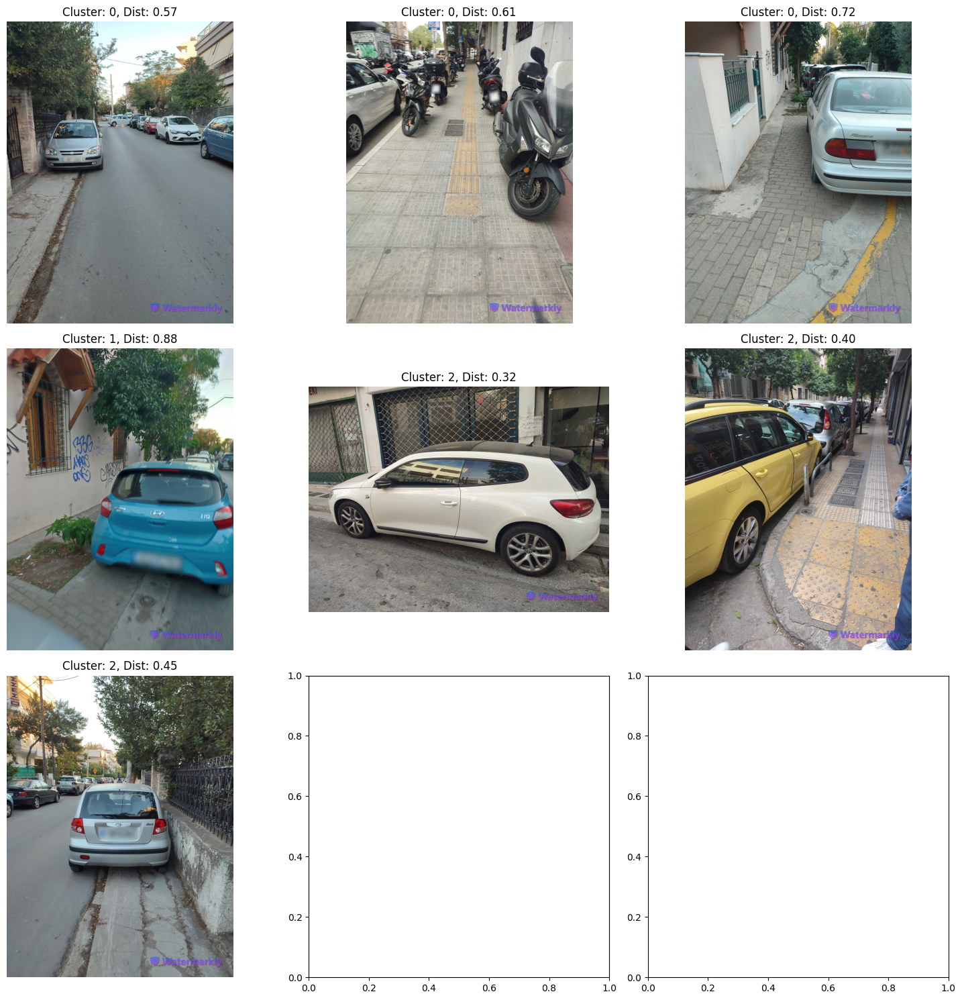

In [423]:
# Assuming df_application has columns 'file_path', 'cluster', 'distance_to_center'

# Sort the DataFrame by 'cluster' and 'distance_to_center' in ascending order
df_sorted = df_application.sort_values(by=['cluster', 'distance_to_center'])

# Group by 'cluster' and take the first 3 entries for each cluster
top_images_per_cluster = df_sorted.groupby('cluster').head(3)

# Determine the number of rows needed
num_clusters = top_images_per_cluster['cluster'].nunique()
images_per_row = 3  # Max images per row
rows = num_clusters  # Each cluster will have its own row

# Create the figure with subplots
fig, axs = plt.subplots(nrows=rows, ncols=images_per_row, figsize=(15, 5 * rows))

# Ensure axs is always an array we can iterate over
axs = axs.ravel() if rows > 1 else [axs]

# Load and display each image, using enumerate to manage subplot indices
for idx, (index, row) in enumerate(top_images_per_cluster.iterrows()):
    ax = axs[idx]  # Get the appropriate subplot axis
    img = mpimg.imread(row['file_path'])  # Load the image
    ax.imshow(img)  # Display the image
    ax.set_title(f"Cluster: {row['cluster']}, Dist: {row['distance_to_center']:.2f}")  # Set title with cluster info
    ax.axis('off')  # Hide axis

# Adjust layout for better appearance
plt.tight_layout()
plt.show()

- Notes for a first quich check we will seee in three close images of the centers follow the text labels we defined in theble above: 
  - For Cluster 1 we have only 1 image which follows teh pattern walls depicts. 
  - For Cluster 0 nt all images follow the label text being "Open, wide streets, minimal details.
  - For cluster 2 not all images follow the label text being "Dense, busy city, narrow streets."
- In otehr words, for the remaining cluster 0 and 2 we have some confusion in the seperation of images. 
  - As don't follown exact the group labels we defined despite the fact that the distance from the centroids is not quite high. 
- Potential Reasons : 
  - `Unseen images contain clutter and different compositions` (e.g., cars, pedestrians) not prominent in training images.The unseen data may have higher feature diversity or noise.
- Maybe our trained model may be overfitting to specific patterns in the training set, making them sensitive to minor deviations in unseen data. so we need to apply beteer training. EExplore diffrent features , psa startegies. 
  

- End of Assignment thank you for yout time!